# <center> Data Analysis and Preprocessing </center>

## This project necessitates tree datasets :
- Soil-DATA : which contains soil properties of the Algerian territory.\
*you can find more infos about this data set [here](https://openknowledge.fao.org/server/api/core/bitstreams/149f1562-bf6a-439f-9d3a-eb93940f39cf/content) (for this one go to "Soil Attributes per depth layer")*\
**due to the size of the dataset, i couldnt upload it to Github. You can download the dataset using the api to have the exact data set i used from [here](#download-climate-data)**

- Climate-DATA : which contains climate variables of 2019 for the entire world.\
*you can find more infos about this data set [here](https://cds.climate.copernicus.eu/datasets/derived-near-surface-meteorological-variables?tab=overview)*
- Country-DATA : which contains country varuiables of the entire world.

### Download Climate Data

In [ ]:
import cdsapi
dataset = "derived-near-surface-meteorological-variables"
request = {
    "variable": [
        "near_surface_wind_speed",
        "near_surface_air_temperature",
        "surface_air_pressure",
        "near_surface_specific_humidity",
        "rainfall_flux",
        "snowfall_flux"
    ],
    "reference_dataset": "cru",
    "year": ["2019"],
    "month": [
        "01", "02", "03",
        "04", "05", "06",
        "07", "08", "09",
        "10", "11", "12"
    ]
}
client = cdsapi.Client()
client.retrieve(dataset, request).download()

In [1]:
import os
import pandas as pd
import numpy as np
import geopandas as gpd # pour manipuler des données géospatiales
import matplotlib.pyplot as plt # pour tracer des graphiques
from collections import Counter # pour calculer la fréquences
from shapely.geometry import Polygon, Point # pour créer des polygones
from shapely import wkt
import matplotlib.cm as cm # pour utiliser des palettes de couleurs dans les graphiques
from shapely.wkt import loads # pour charger des géométries (Well-Known Text)
import xarray as xr # Pour manipuler des données multidimensionnelles tq NetCDF
import glob # pour manipuler un ensemble de fichiers .nc
from rasterio.features import rasterize # Pour convertir des objets géométriques en grilles raster
from scipy.stats import skew # pour calculer le coefficient d'asymetrie
import math # pour effecteur les opérations mathématiques
import itertools # pour eviter les combinaisons redondantes dans les scatter plots
from scipy import stats # pour avoir la fonction de scatter plot

# A. Data manipulation

## **Country Data**
1. All world data :

In [4]:
country_data = gpd.read_file("data/Country/Country.shp")
print(country_data.shape)
country_data.describe()

(27272, 11)


,AREA,PERIMETER,CNT1M_1_,CNT1M_1_ID,FAO_CODE,UN_CODE
count,2.727200e+04,27272.000000,27272.000000,27272.000000,27272.000000,27272.000000
mean,5.651565e-01,0.752678,13637.500000,13703.351423,103.957282,361.436125
std,2.205697e+01,12.279313,7872.892607,7966.379001,80.534896,256.174746
min,8.768650e-08,0.001725,2.000000,1.000000,1.000000,0.000000
25%,1.019154e-04,0.046498,6819.750000,6818.750000,33.000000,124.000000
50%,2.374754e-04,0.077532,13637.500000,13636.500000,85.000000,304.000000
75%,8.879884e-04,0.166635,20455.250000,20454.250000,168.000000,591.000000
max,2.818894e+03,976.828929,27273.000000,27610.000000,790.000000,894.000000


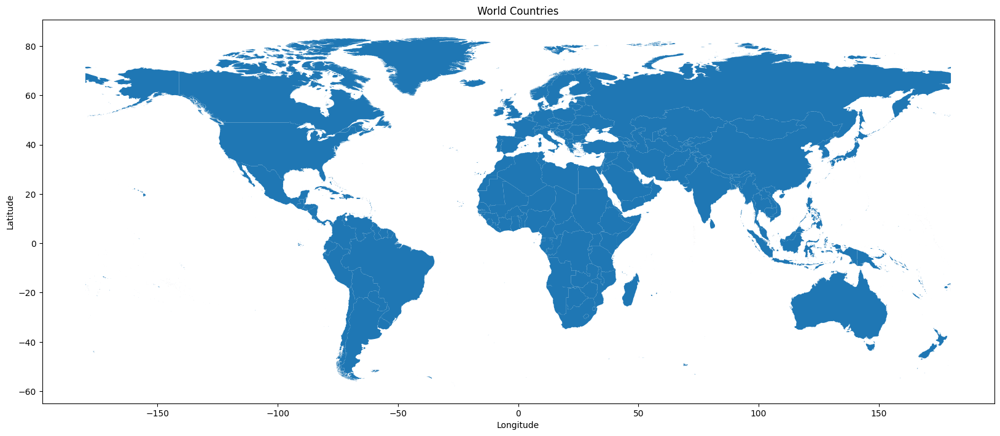

In [5]:
country_data.plot(figsize=(20, 20))
plt.title("World Countries")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

In [6]:
print(country_data.columns)
# print(country_data['FAO_NAME'].drop_duplicates().reset_index(drop=True))
print(Counter(country_data['FAO_NAME']))

Index(['AREA', 'PERIMETER', 'CNT1M_1_', 'CNT1M_1_ID', 'FAO_NAME', 'FAO_CODE',
       'UN_CODE', 'ISO_CODE', 'CNTRY_NAME', 'ISO3_CODE', 'geometry'],
      dtype='object')
Counter({'Canada': 5238, 'Indonesia': 1947, 'United States of America': 1783, 'Chile': 1392, 'Russian Federation': 1381, 'Greenland': 1311, 'Australia': 1024, 'Norway': 858, 'Philippines': 735, 'Finland': 652, 'China, Mainland': 573, 'Sweden': 506, 'Japan': 461, 'Cuba': 421, 'Myanmar': 416, 'Papua New Guinea': 393, 'Brazil': 357, 'French Polynesia': 344, 'Korea, Republic of': 312, 'Bahamas': 303, 'Solomon Islands': 257, 'Greece': 253, 'Mexico': 251, 'United Kingdom': 249, 'India': 247, 'Saudi Arabia': 216, 'Maldives': 209, 'Bangladesh': 206, 'Marshall Islands': 192, 'Viet Nam': 160, 'Iceland': 156, 'New Zealand': 156, 'Thailand': 153, 'Malaysia': 146, 'Eritrea': 132, 'Fiji Islands': 127, 'Venezuela, Boliv Rep of': 126, 'Falkland Is (Malvinas)': 112, 'Svalbard and Jan Mayen': 104, 'Egypt': 103, 'Fr South Ter': 100, 'Kir

2. **Algeria data :**

In [7]:
algeria_data = country_data[country_data['FAO_NAME'] == 'Algeria']
print(algeria_data.shape)
algeria_data.describe()

(3, 11)


,AREA,PERIMETER,CNT1M_1_,CNT1M_1_ID,FAO_CODE,UN_CODE
count,3.000000,3.000000,3.000000,3.000000,3.0,3.0
mean,71.144970,24.504636,12952.666667,11931.666667,4.0,12.0
std,123.226544,42.375432,111.446549,15.373137,0.0,0.0
min,0.000072,0.033402,12824.000000,11914.000000,4.0,12.0
25%,0.000092,0.039169,12919.500000,11926.500000,4.0,12.0
50%,0.000111,0.044937,13015.000000,11939.000000,4.0,12.0
75%,106.717419,36.740253,13017.000000,11940.500000,4.0,12.0
max,213.434727,73.435570,13019.000000,11942.000000,4.0,12.0


In [8]:
algeria_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 3 entries, 12822 to 13017
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   AREA        3 non-null      float64 
 1   PERIMETER   3 non-null      float64 
 2   CNT1M_1_    3 non-null      int64   
 3   CNT1M_1_ID  3 non-null      int64   
 4   FAO_NAME    3 non-null      object  
 5   FAO_CODE    3 non-null      int32   
 6   UN_CODE     3 non-null      int32   
 7   ISO_CODE    3 non-null      object  
 8   CNTRY_NAME  3 non-null      object  
 9   ISO3_CODE   3 non-null      object  
 10  geometry    3 non-null      geometry
dtypes: float64(2), geometry(1), int32(2), int64(2), object(4)
memory usage: 264.0+ bytes


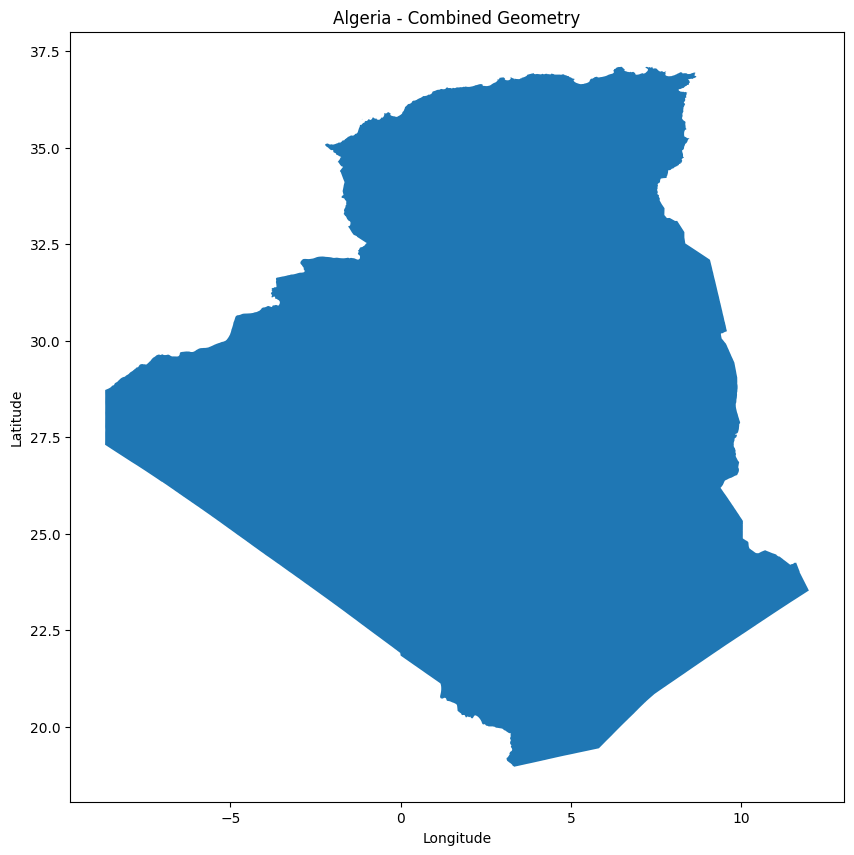

In [9]:
algeria_data.plot(figsize=(10, 10))
plt.title("Algeria - Combined Geometry")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

## **Wilaya Data**

In [10]:
wilayas_data = gpd.read_file("data/Wilayas/all-wilayas.shp")
print(wilayas_data.shape)
wilayas_data.describe()

(58, 6)


,density
count,47.000000
mean,150.871277
std,162.939387
min,0.180000
25%,37.000000
50%,95.000000
75%,221.500000
max,688.000000


In [11]:
wilayas_data.columns

Index(['name', 'name_ar', 'name_ber', 'density', 'city_code', 'geometry'], dtype='object')

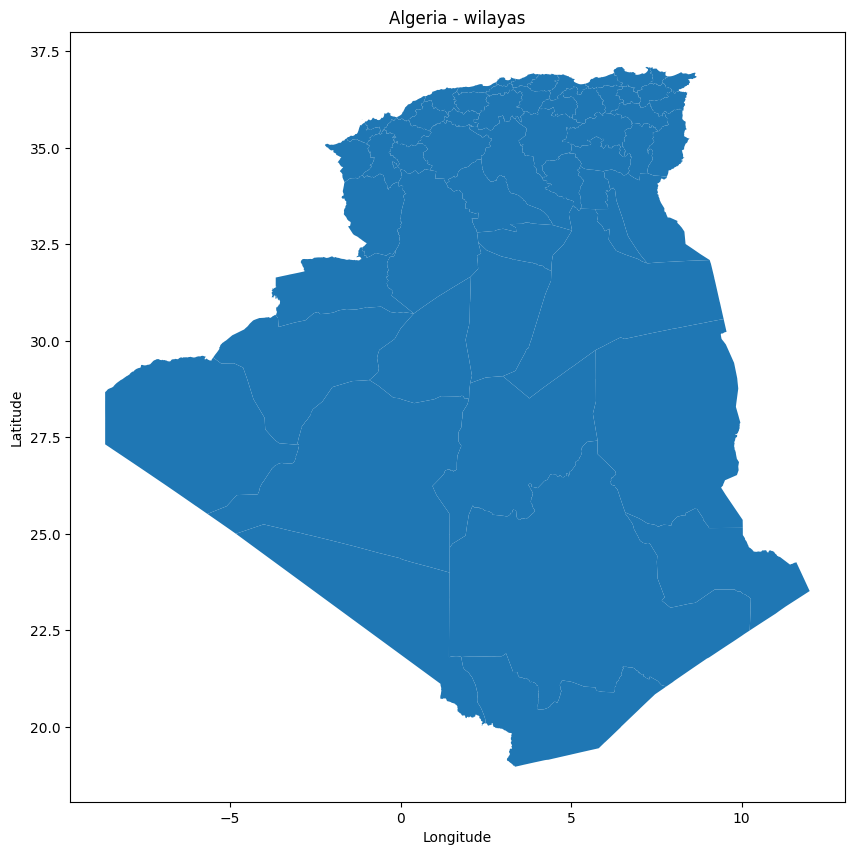

In [12]:
wilayas_data.plot(figsize=(10, 10))
plt.title("Algeria - wilayas")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

## **Soil Data**

In [13]:
soil_algeria = pd.read_csv("data/soil_dz_allprops.csv" , delimiter=',')
print(soil_algeria.shape)
soil_algeria.describe()

(295, 25)


,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
count,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,...,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000
mean,32.921993,32.022858,18.050939,17.960102,18.216224,19.102000,5.246007,5.332427,0.438613,0.254453,...,10.054031,9.420312,38.503186,32.350203,6.177993,8.850132,0.987186,0.975797,7.314068,6.884983
std,23.743970,22.866685,13.795567,13.218837,14.229619,14.877827,3.352199,3.404668,0.356333,0.180211,...,8.779385,8.709818,25.202270,21.700717,6.927369,9.520785,0.640324,0.625597,4.935714,4.735834
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,36.090000,36.490000,18.546000,19.100000,22.730000,22.320000,7.300000,7.460000,0.447500,0.288000,...,9.750000,8.660000,49.400000,42.300000,3.580000,5.115000,1.340000,1.340000,9.300000,8.500000
75%,50.390000,46.550000,26.220000,27.900000,25.200000,27.165000,7.700000,7.800000,0.678000,0.400000,...,14.400000,13.870000,58.050000,48.800000,10.980000,16.185000,1.470000,1.430000,10.450000,10.600000
max,96.000000,94.700000,54.000000,50.730000,60.600000,63.570000,9.630000,9.700000,2.411000,0.742000,...,47.160000,48.960000,78.900000,73.000000,33.540000,43.860000,1.840000,1.840000,20.800000,16.400000


In [14]:
soil_algeria.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 295 entries, 0 to 294
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   sand % topsoil    295 non-null    float64
 1   sand % subsoil    295 non-null    float64
 2   silt % topsoil    295 non-null    float64
 3   silt% subsoil     295 non-null    float64
 4   clay % topsoil    295 non-null    float64
 5   clay % subsoil    295 non-null    float64
 6   pH water topsoil  295 non-null    float64
 7   pH water subsoil  295 non-null    float64
 8   OC % topsoil      295 non-null    float64
 9   OC % subsoil      295 non-null    float64
 10  N % topsoil       295 non-null    float64
 11  N % subsoil       295 non-null    float64
 12  BS % topsoil      295 non-null    float64
 13  BS % subsoil      295 non-null    float64
 14  CEC topsoil       295 non-null    float64
 15  CEC subsoil       295 non-null    float64
 16  CEC clay topsoil  295 non-null    float64
 1

In [15]:
algeria_data["geometry"]

12822    POLYGON ((7.51832 37.03624, 7.52736 37.02525, ...
13013    POLYGON ((-0.89577 35.77688, -0.89942 35.77692...
13017    POLYGON ((-1.13231 35.72762, -1.13595 35.72835...
Name: geometry, dtype: geometry

In [16]:
soil_algeria_polygons = soil_algeria['geometry'].apply(lambda x: wkt.loads(x) if isinstance(x, str) else x)
# algeria_data_polygons = algeria_data['geometry'].apply(lambda x: wkt.loads(x) if isinstance(x, str) else x)
if isinstance(algeria_data['geometry'], str):
    algeria_data_polygons  = wkt.loads(algeria_data['geometry'])
else:
    algeria_data_polygons  = algeria_data['geometry']
    
print(soil_algeria_polygons)
# Compare geometries to find intersections or equalities
result = soil_algeria[soil_algeria_polygons.apply(lambda geom: geom.equals(algeria_data_polygons))]
print(result.shape)

0      POLYGON ((5.488269805908203 36.69034957885742,...
1      POLYGON ((7.277111053466797 37.02900695800781,...
2      POLYGON ((7.367879867553711 36.955509185791016...
3      POLYGON ((7.681180000305176 36.97943878173828,...
4      POLYGON ((8.664039611816406 36.89445877075195,...
                             ...                        
290    POLYGON ((3.2276499271392822 19.95354080200195...
291    POLYGON ((5.541150093078613 19.48434066772461,...
292    POLYGON ((5.961190223693848 19.71068000793457,...
293    POLYGON ((4.107329845428467 19.135799407958984...
294    POLYGON ((4.505320072174072 19.232820510864258...
Name: geometry, Length: 295, dtype: object
(295, 25)


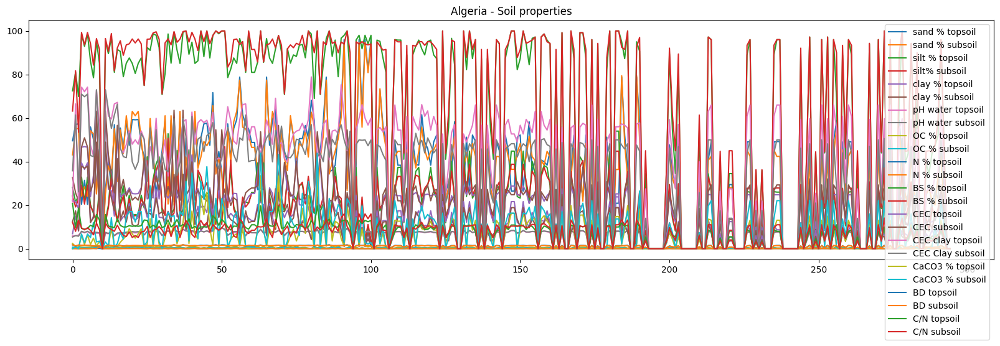

In [17]:
soil_algeria.plot(figsize=(20,5))
plt.title("Algeria - Soil properties")
plt.show()

- a thematic map for 4 soil attributes, with colored regions according to the value of each attribute

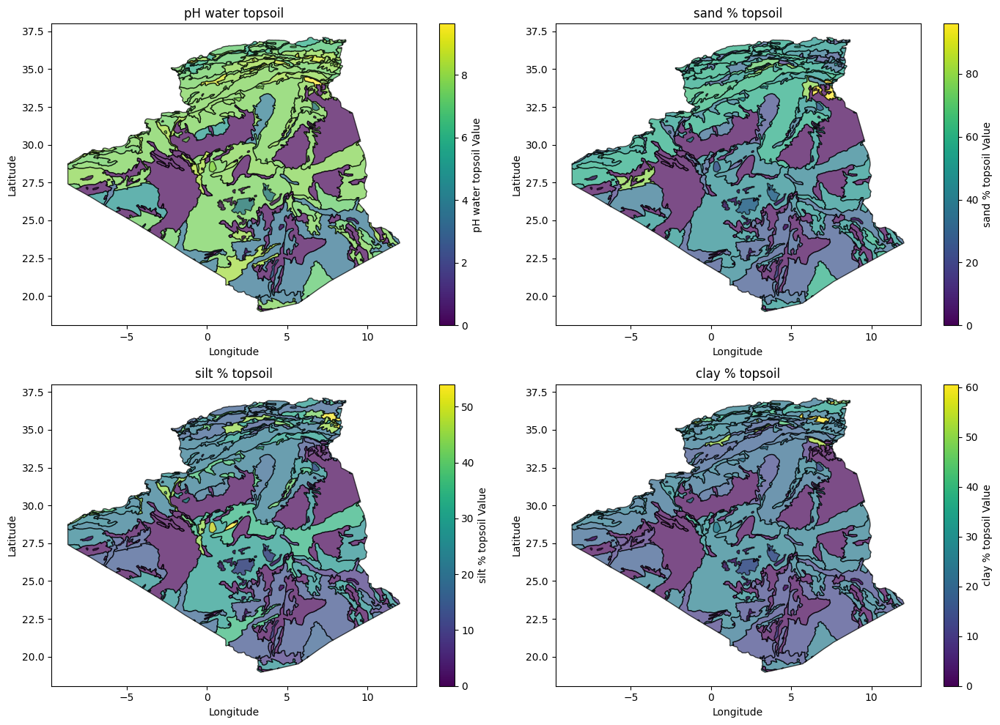

In [18]:
attributes = [
    'pH water topsoil',
    'sand % topsoil',
    'silt % topsoil',
    'clay % topsoil',
]

fig, axs = plt.subplots(2, 2, figsize=(14, 10))
axs = axs.flatten()

for idx, (attribute, ax) in enumerate(zip(attributes, axs)):
    # Normalize the attribute values for colormap
    norm = plt.Normalize(soil_algeria[attribute].min(), soil_algeria[attribute].max())
    cmap = cm.viridis
    
    # Plot the polygons for the current attribute
    for i, geom in enumerate(soil_algeria.iloc):
        try:
            G = loads(geom['geometry'])
            if G.is_valid: 
                if G.geom_type == 'Polygon':
                    x, y = G.exterior.xy  
                    color = cmap(norm(geom[attribute]))
                    ax.fill(x, y, alpha=0.7, edgecolor='black', facecolor=color)
                    
        except Exception as e:
            print(f"Error processing geometry at index {i}: {e}")
    
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Empty array for colorbar
    cbar = plt.colorbar(sm, ax=ax)
    cbar.set_label(f'{attribute} Value')

    ax.set_title(f'{attribute}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

plt.tight_layout()
plt.show()

## **Climate Data**

- We start by reading the climate data of the entire world

In [17]:
# file_paths = glob.glob("data/Climate-DATA/*.nc")
# print(len(file_paths))
# for file_path in file_paths:
#     single_file_dataset = xr.open_dataset(file_path, engine='netcdf4')
#     print(single_file_dataset)

72 files
file : PSurf_WFDE5_CRU_201901_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


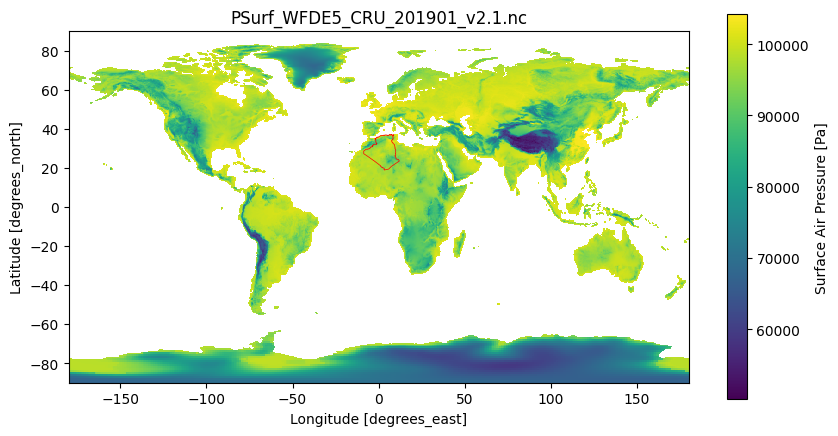

file : PSurf_WFDE5_CRU_201902_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 697MB
Dimensions:  (time: 672, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


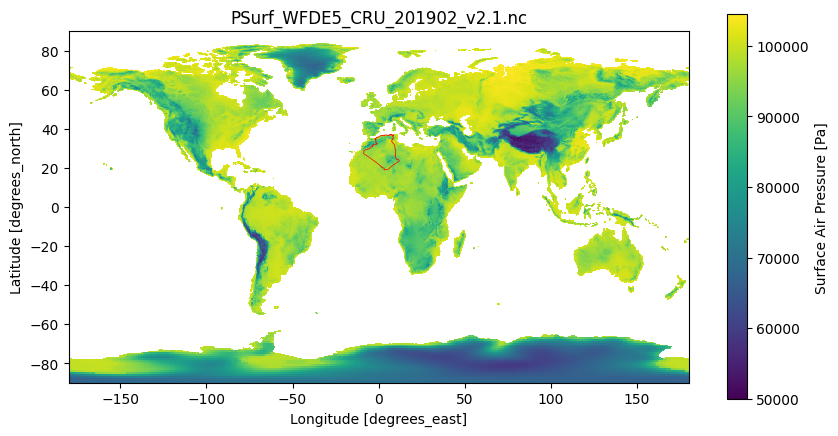

file : PSurf_WFDE5_CRU_201903_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


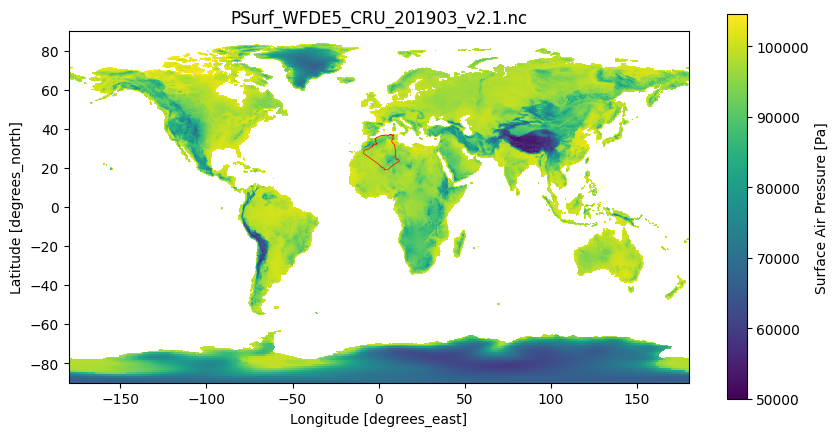

file : PSurf_WFDE5_CRU_201904_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


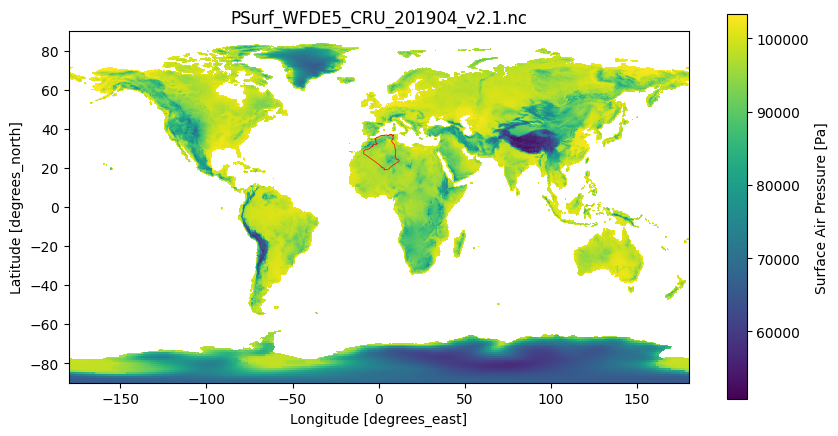

file : PSurf_WFDE5_CRU_201905_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


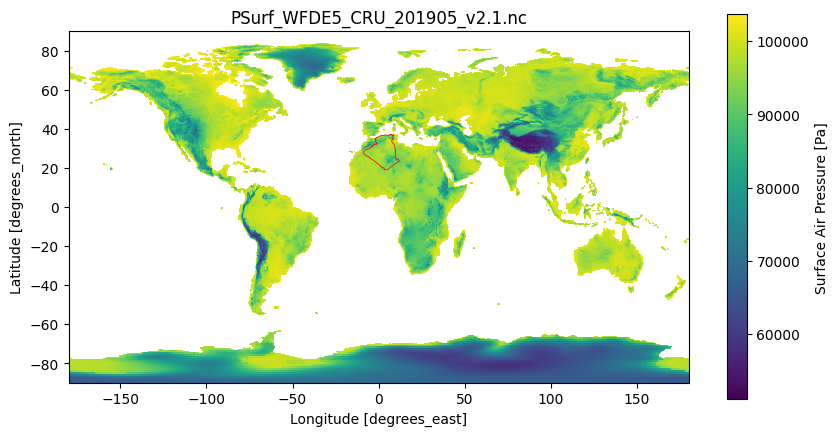

file : PSurf_WFDE5_CRU_201906_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


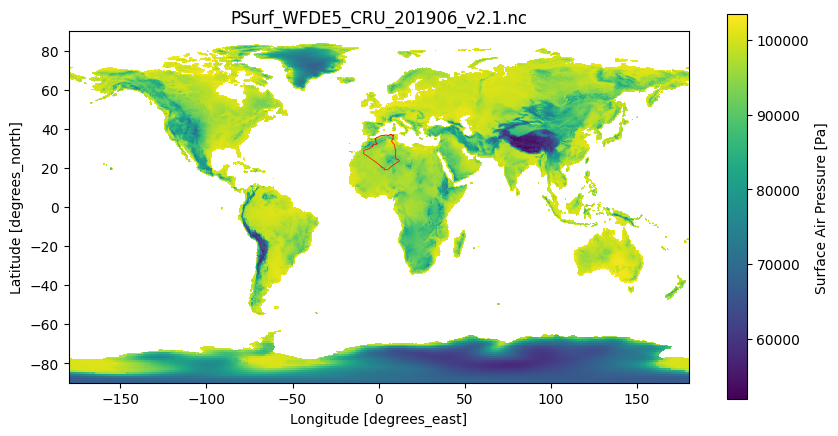

file : PSurf_WFDE5_CRU_201907_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


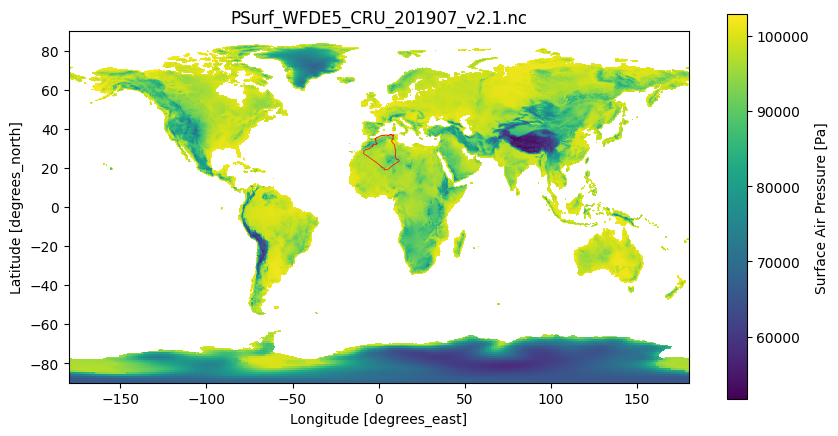

file : PSurf_WFDE5_CRU_201908_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


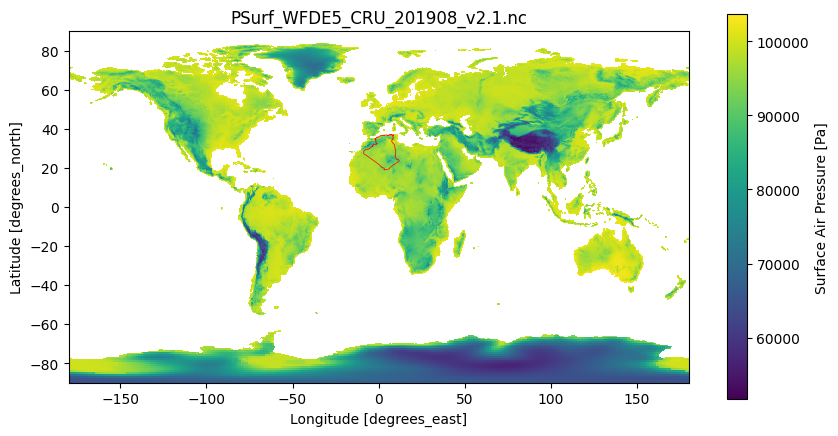

file : PSurf_WFDE5_CRU_201909_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


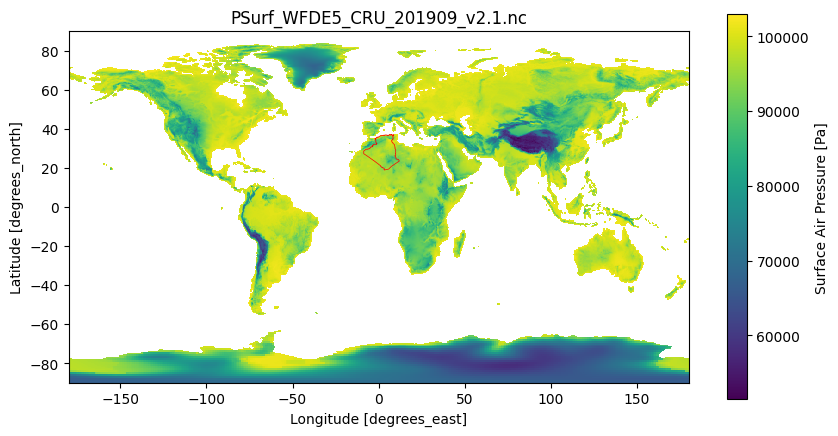

file : PSurf_WFDE5_CRU_201910_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


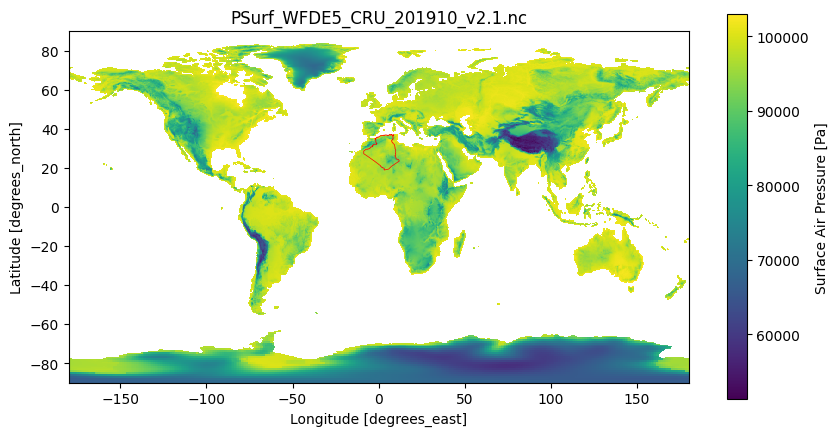

file : PSurf_WFDE5_CRU_201911_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


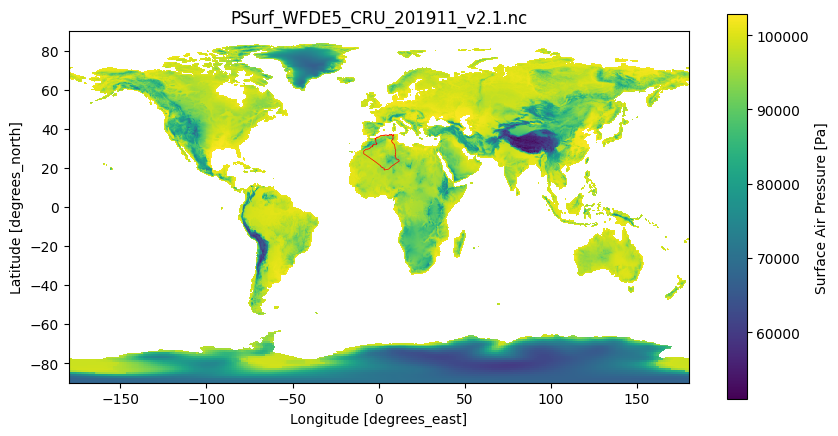

file : PSurf_WFDE5_CRU_201912_v2.1.nc 
	['PSurf']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    PSurf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


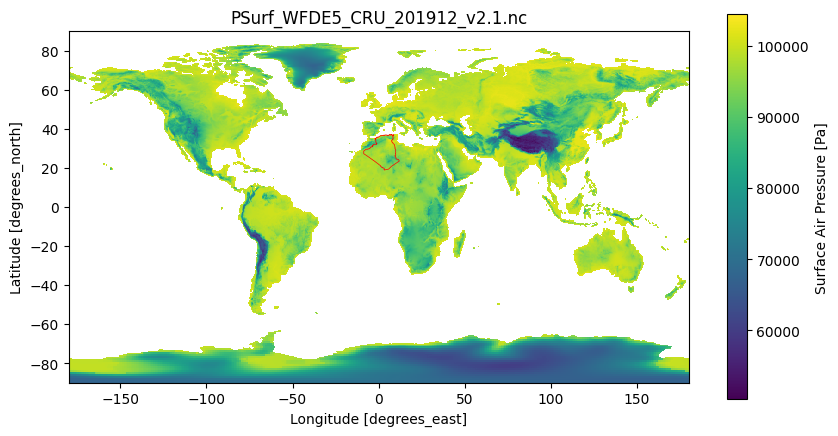

file : Qair_WFDE5_CRU_201901_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


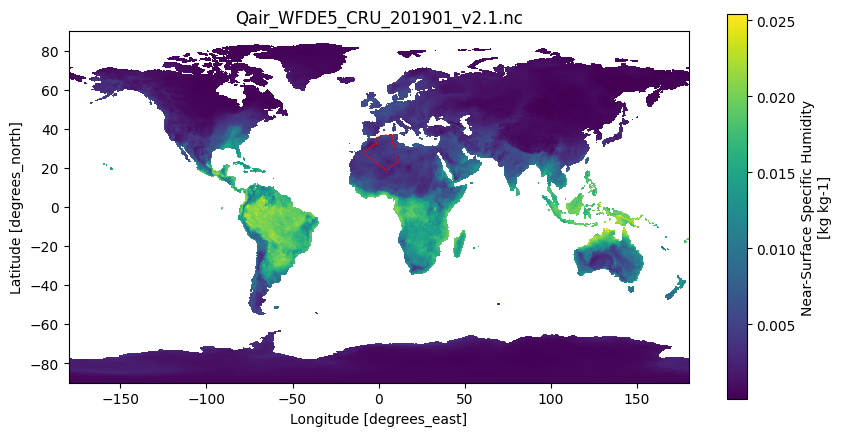

file : Qair_WFDE5_CRU_201902_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 697MB
Dimensions:  (time: 672, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


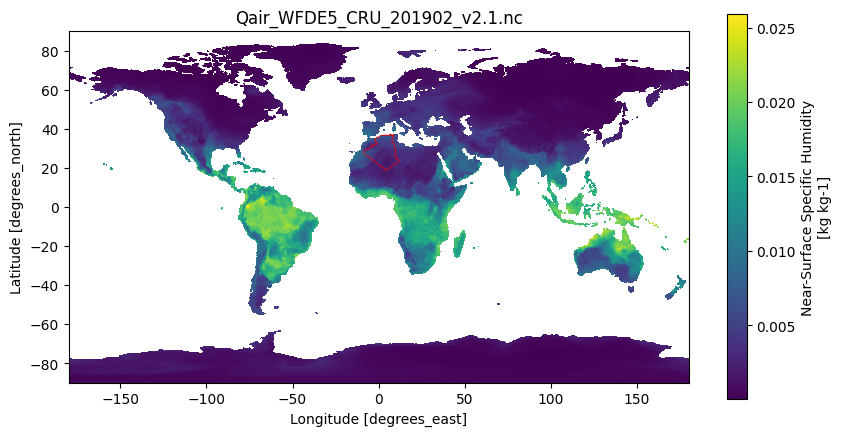

file : Qair_WFDE5_CRU_201903_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


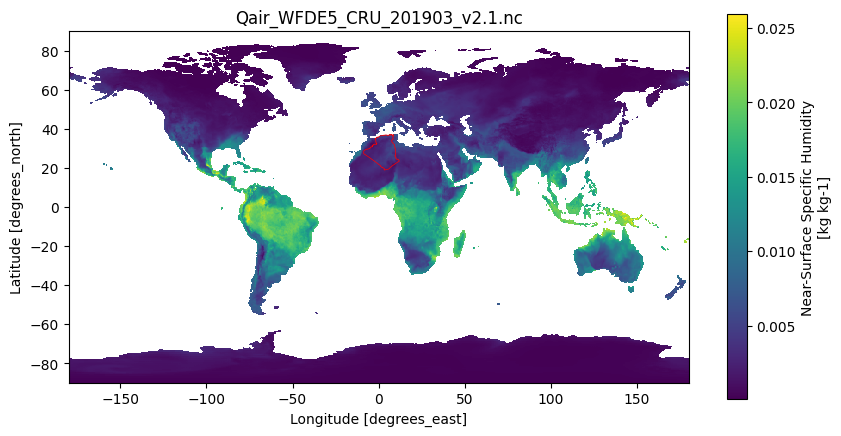

file : Qair_WFDE5_CRU_201904_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


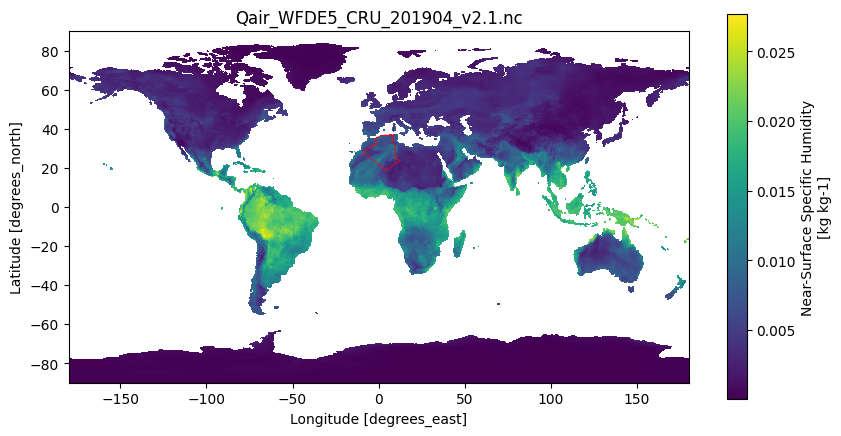

file : Qair_WFDE5_CRU_201905_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


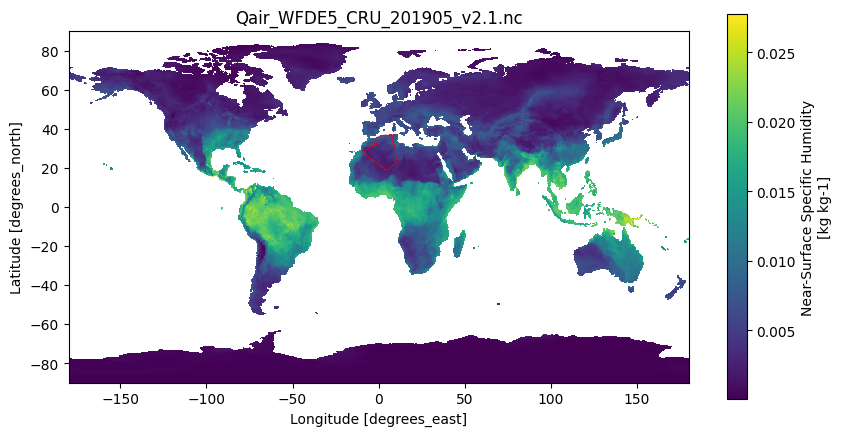

file : Qair_WFDE5_CRU_201906_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


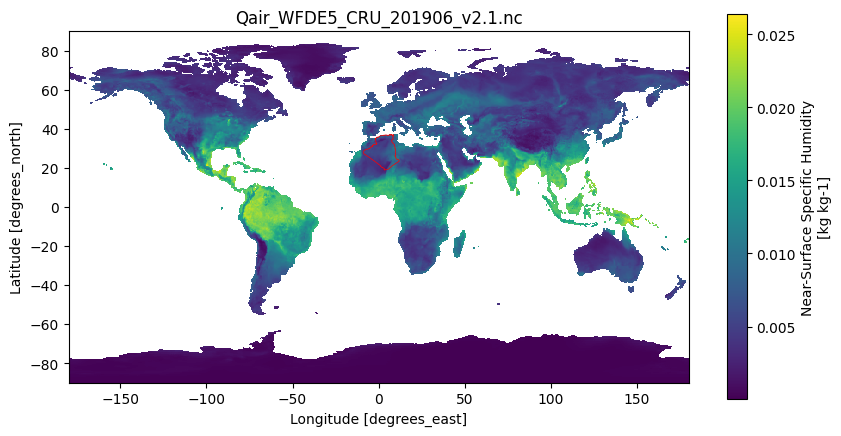

file : Qair_WFDE5_CRU_201907_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


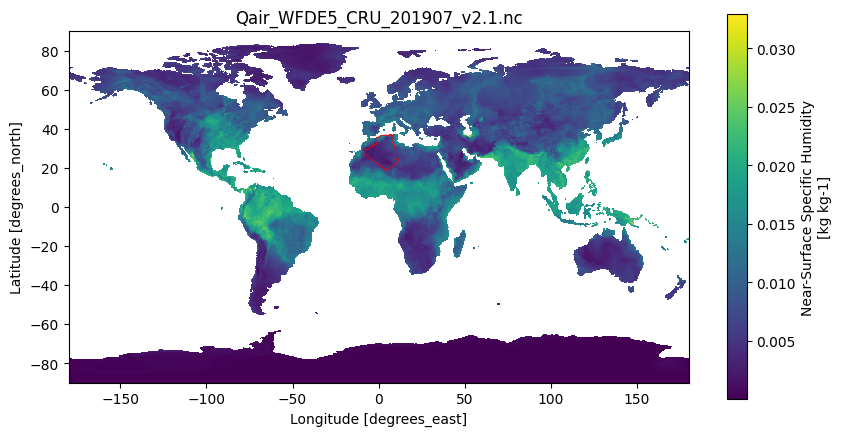

file : Qair_WFDE5_CRU_201908_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


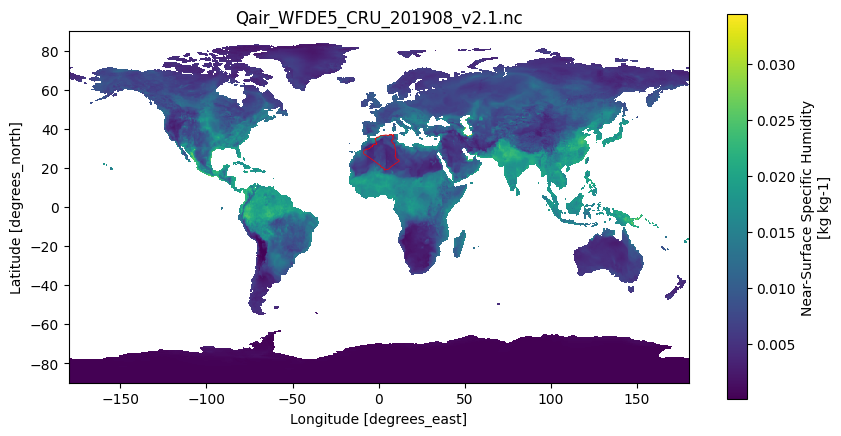

file : Qair_WFDE5_CRU_201909_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


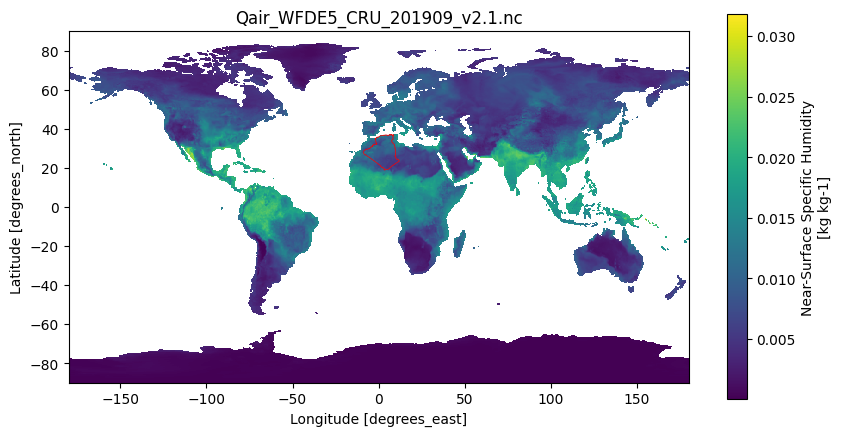

file : Qair_WFDE5_CRU_201910_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


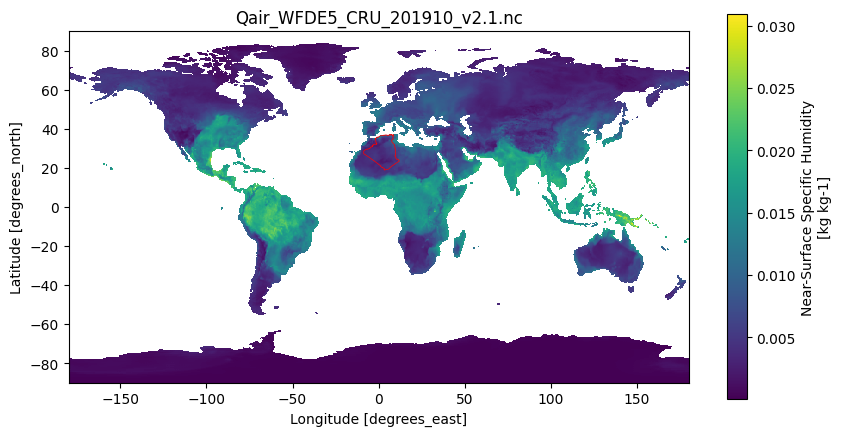

file : Qair_WFDE5_CRU_201911_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


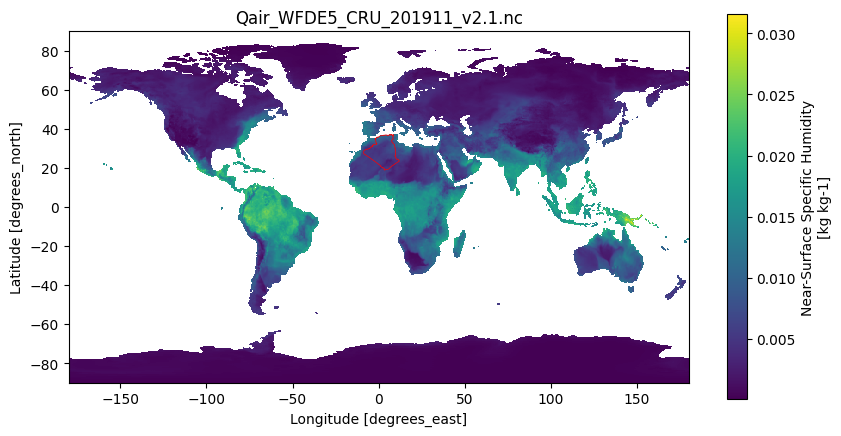

file : Qair_WFDE5_CRU_201912_v2.1.nc 
	['Qair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Qair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


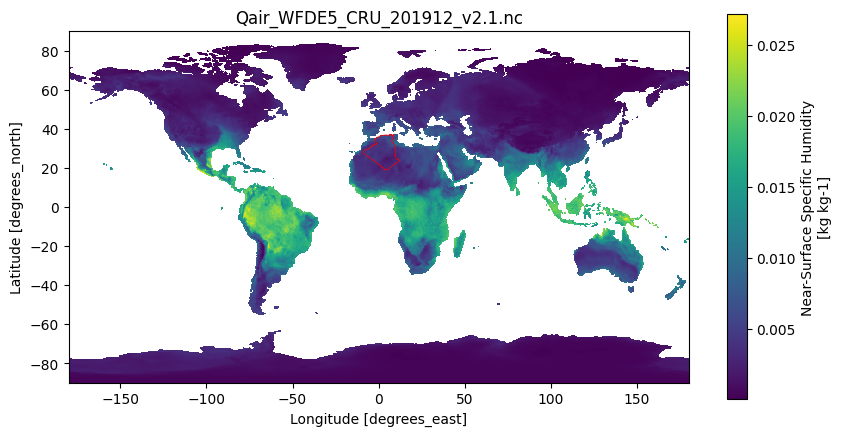

file : Rainf_WFDE5_CRU_201901_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


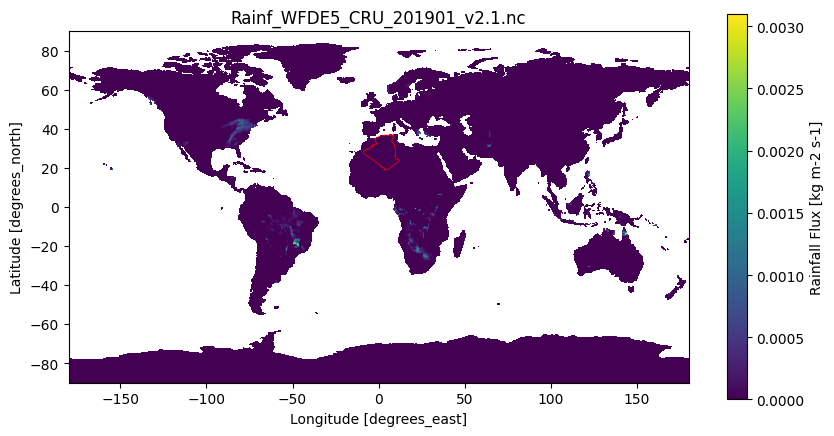

file : Rainf_WFDE5_CRU_201902_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 697MB
Dimensions:  (lat: 360, lon: 720, time: 672)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


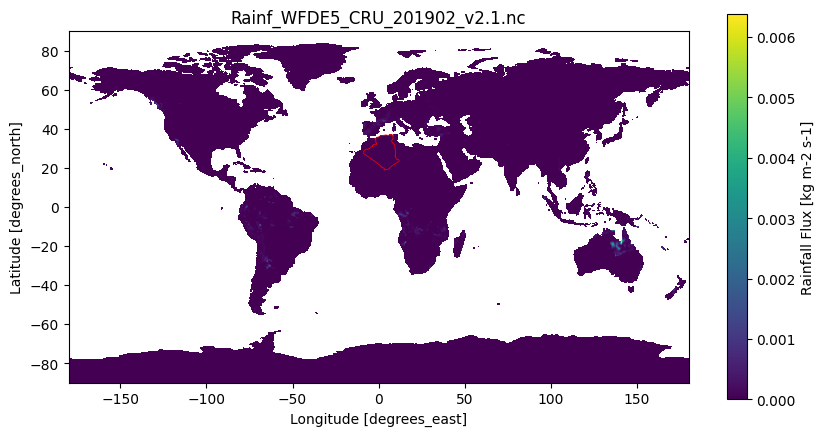

file : Rainf_WFDE5_CRU_201903_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


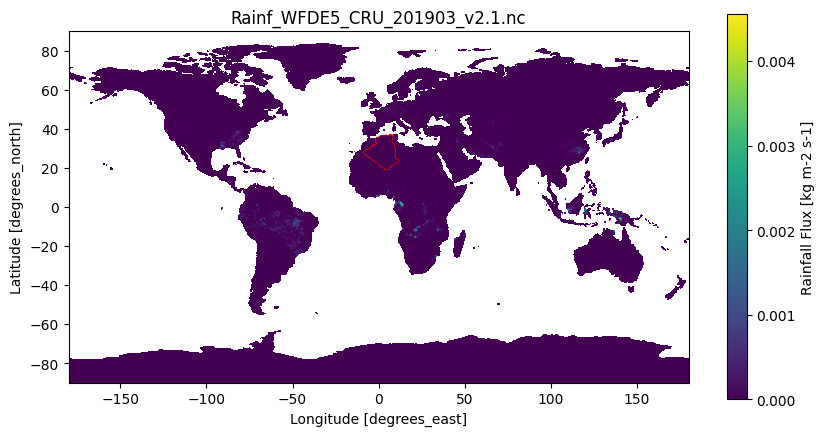

file : Rainf_WFDE5_CRU_201904_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


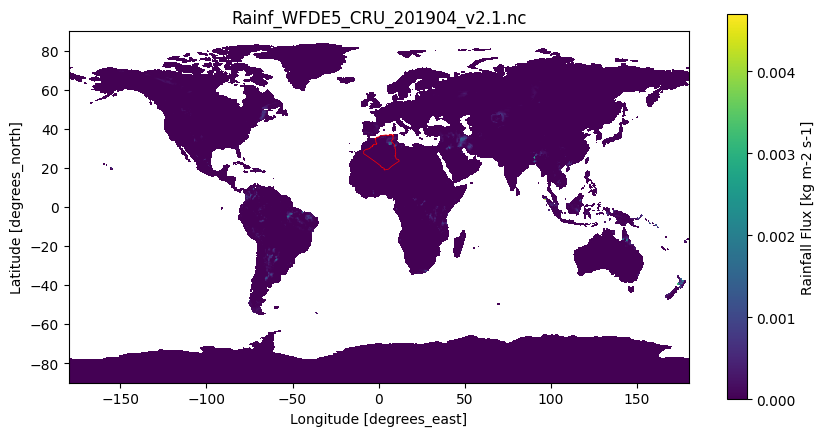

file : Rainf_WFDE5_CRU_201905_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


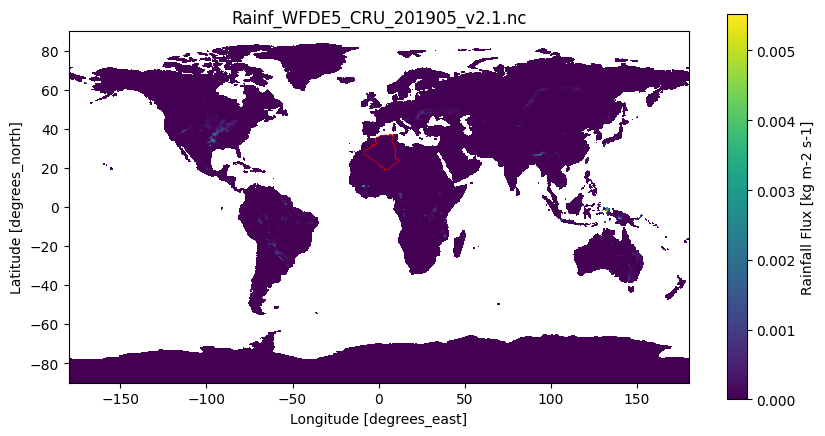

file : Rainf_WFDE5_CRU_201906_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


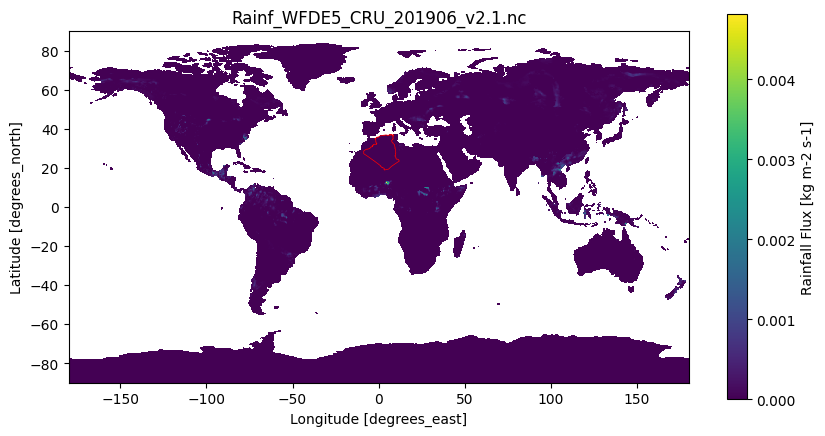

file : Rainf_WFDE5_CRU_201907_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


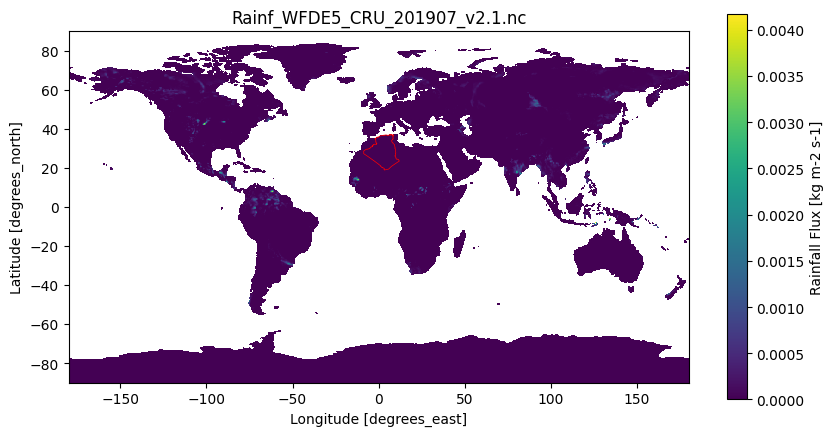

file : Rainf_WFDE5_CRU_201908_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


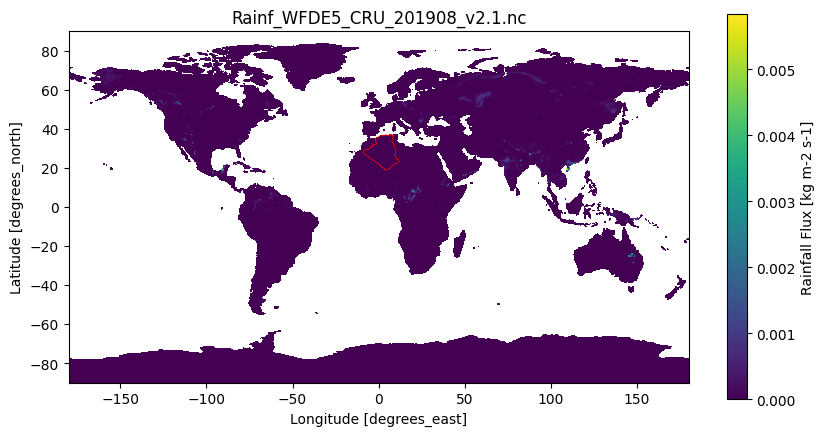

file : Rainf_WFDE5_CRU_201909_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


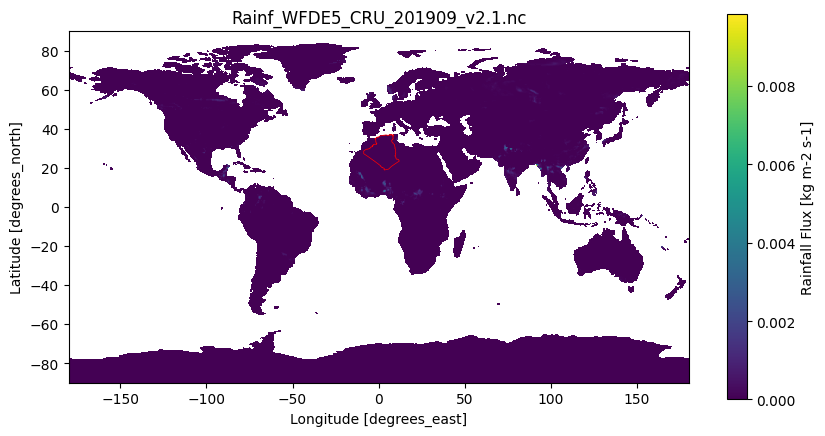

file : Rainf_WFDE5_CRU_201910_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


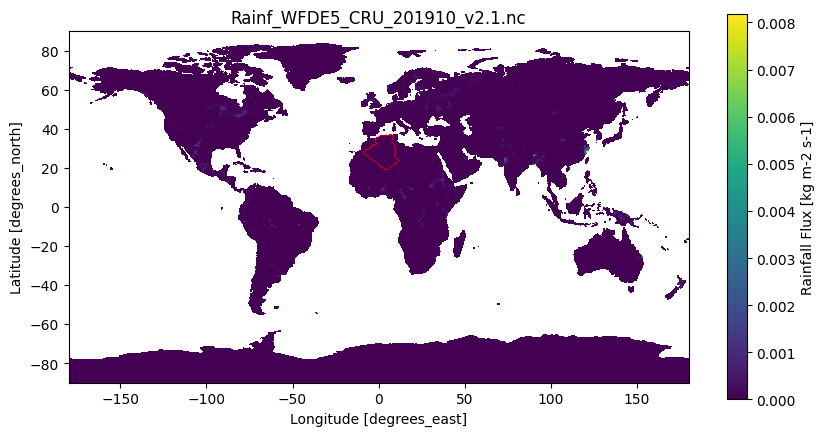

file : Rainf_WFDE5_CRU_201911_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


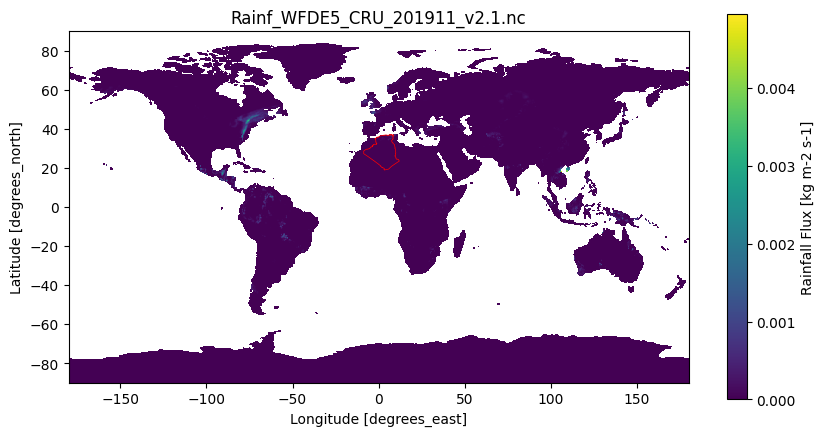

file : Rainf_WFDE5_CRU_201912_v2.1.nc 
	['Rainf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
Data variables:
    Rainf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


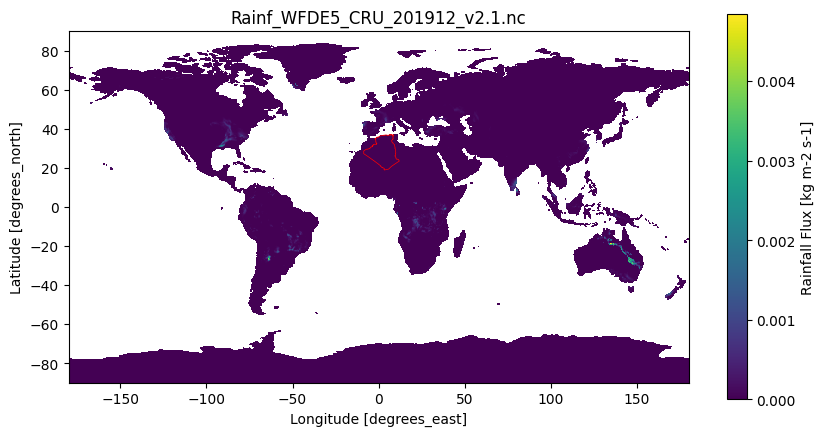

file : Snowf_WFDE5_CRU_201901_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


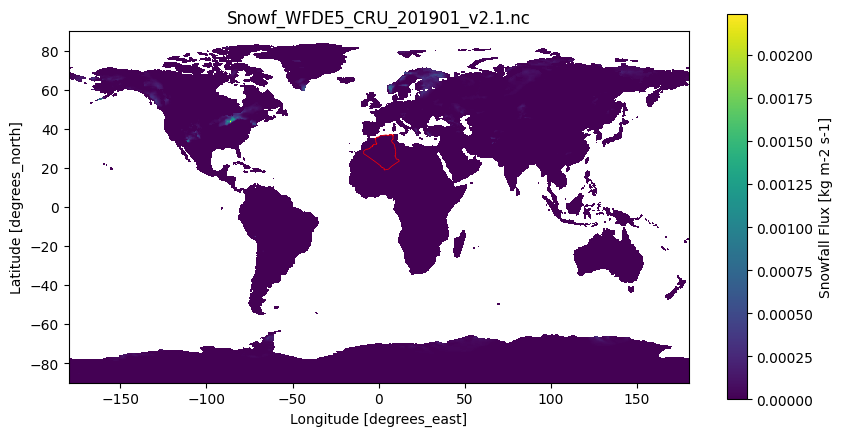

file : Snowf_WFDE5_CRU_201902_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 697MB
Dimensions:  (lat: 360, lon: 720, time: 672)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


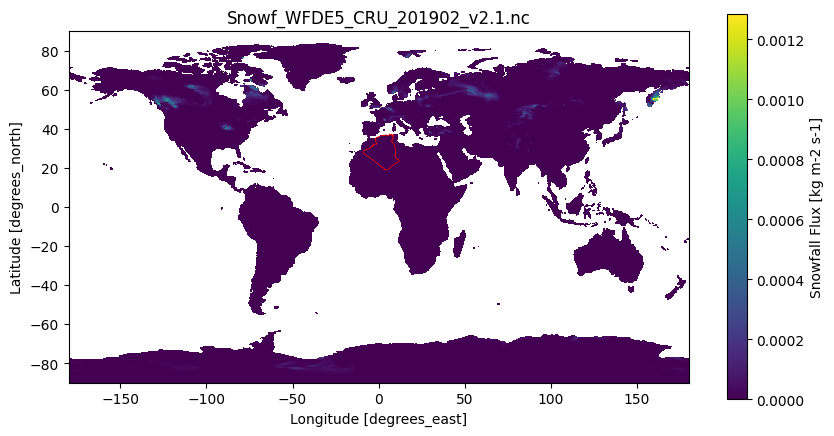

file : Snowf_WFDE5_CRU_201903_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


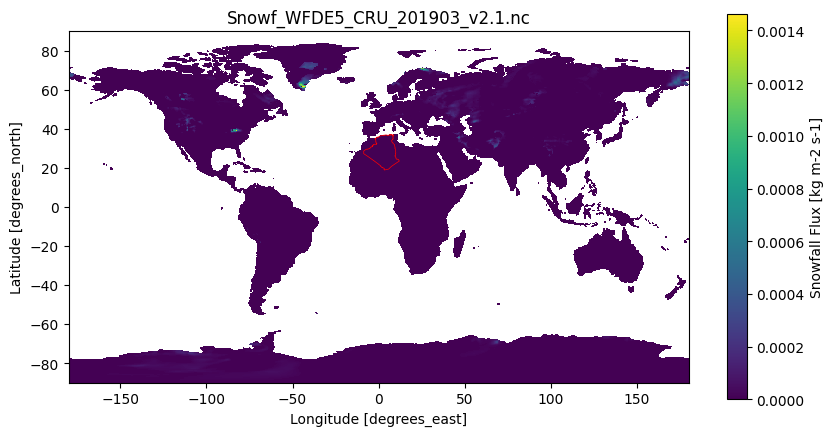

file : Snowf_WFDE5_CRU_201904_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


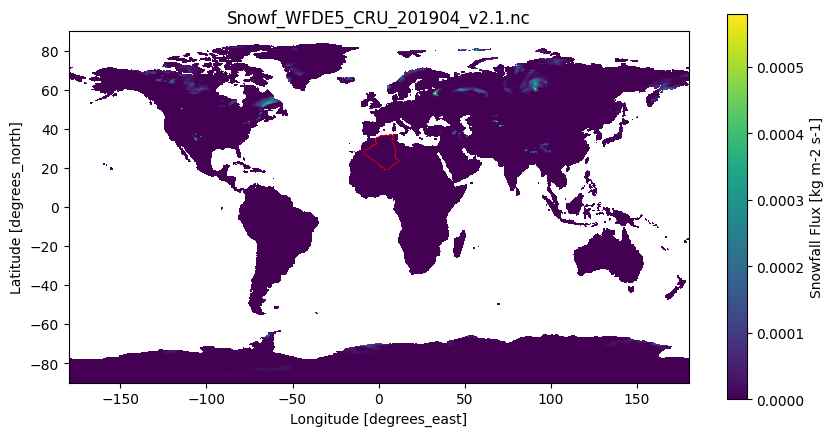

file : Snowf_WFDE5_CRU_201905_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


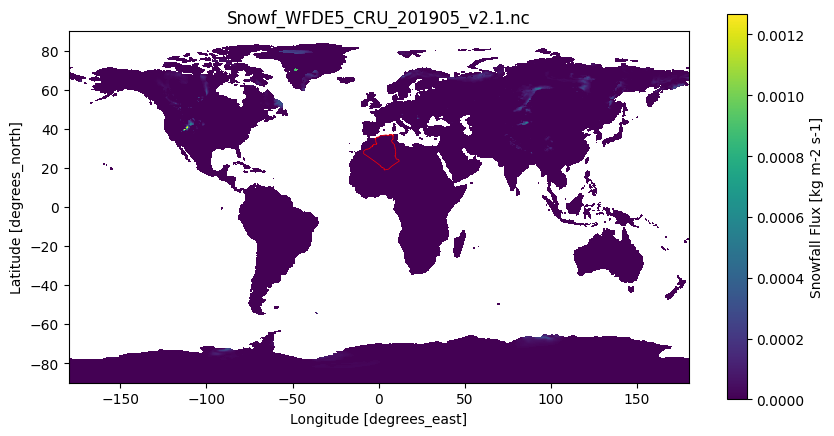

file : Snowf_WFDE5_CRU_201906_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


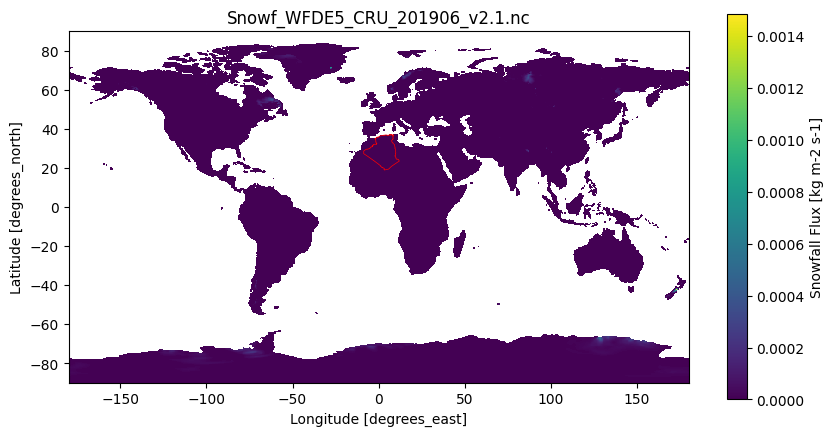

file : Snowf_WFDE5_CRU_201907_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


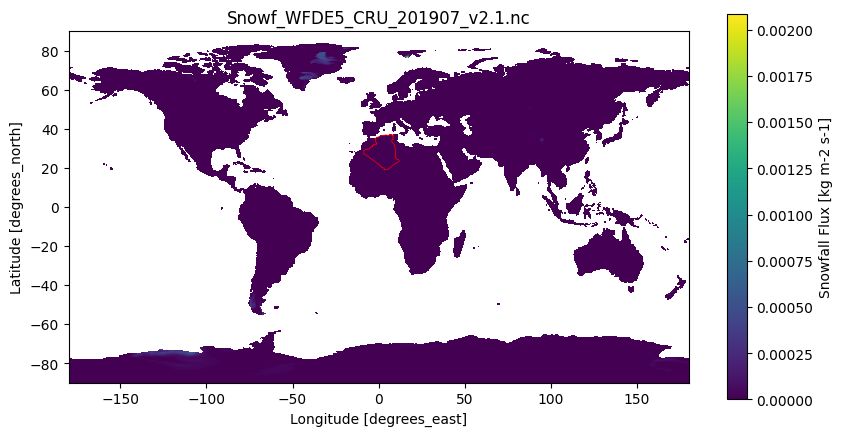

file : Snowf_WFDE5_CRU_201908_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


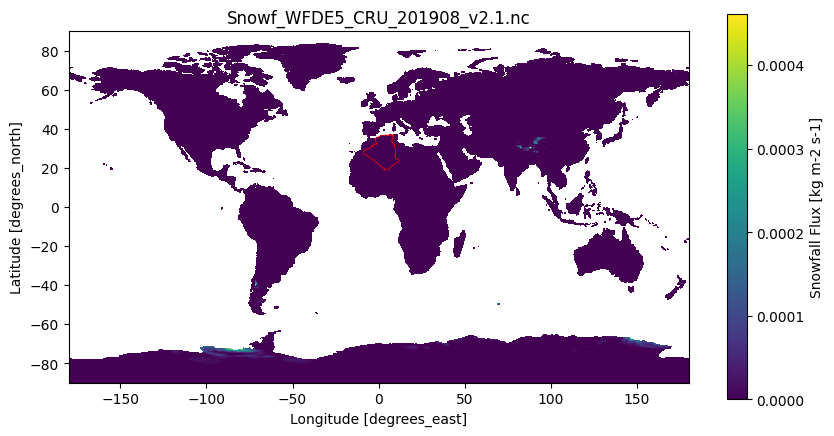

file : Snowf_WFDE5_CRU_201909_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


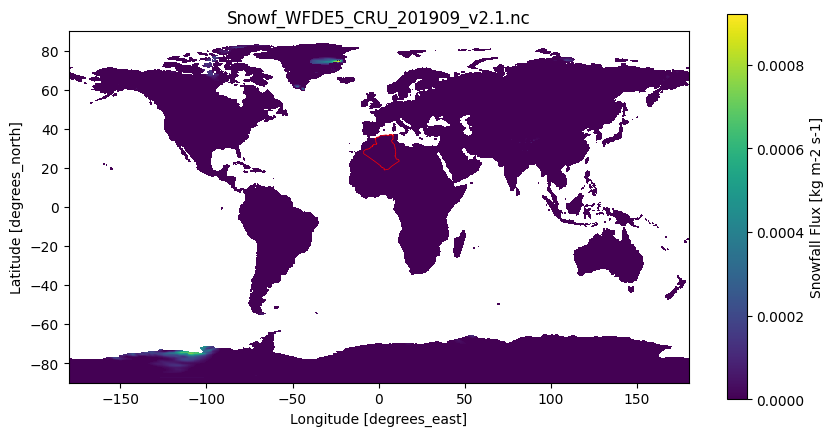

file : Snowf_WFDE5_CRU_201910_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


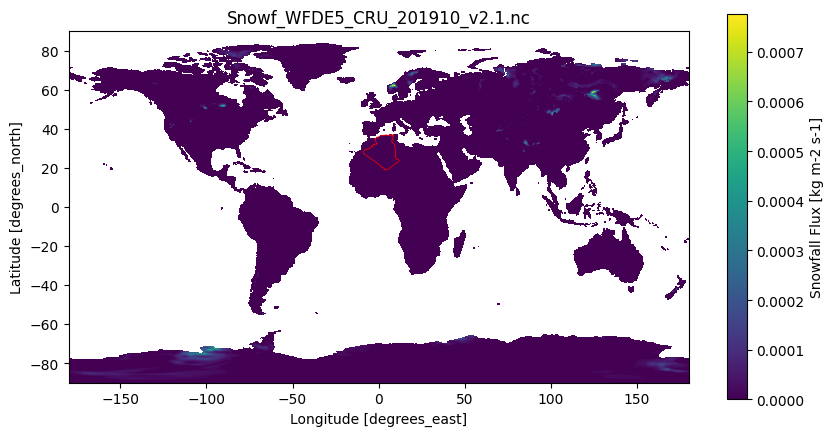

file : Snowf_WFDE5_CRU_201911_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 747MB
Dimensions:  (lat: 360, lon: 720, time: 720)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


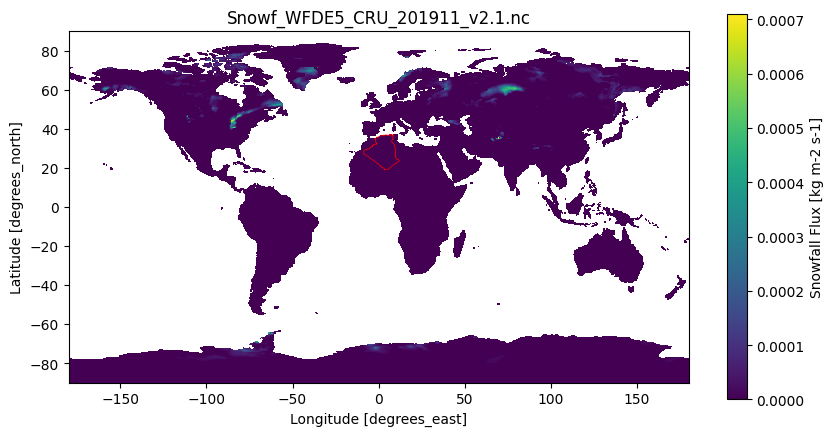

file : Snowf_WFDE5_CRU_201912_v2.1.nc 
	['Snowf']
<xarray.Dataset> Size: 771MB
Dimensions:  (lat: 360, lon: 720, time: 744)
Coordinates:
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
Data variables:
    Snowf    (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


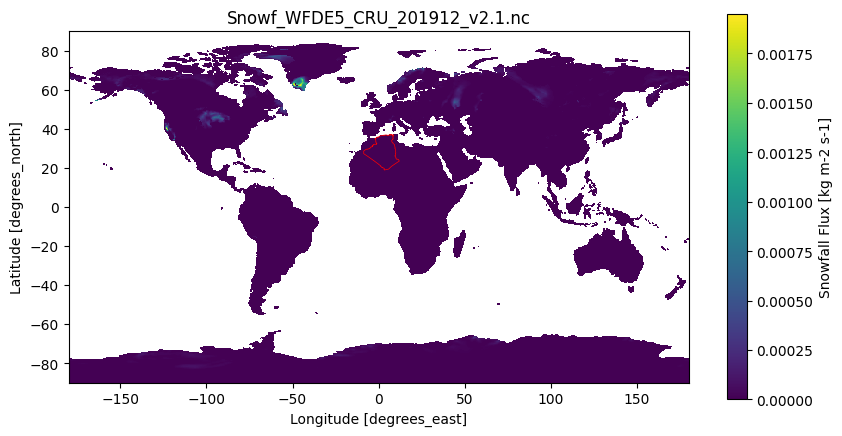

file : Tair_WFDE5_CRU_201901_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


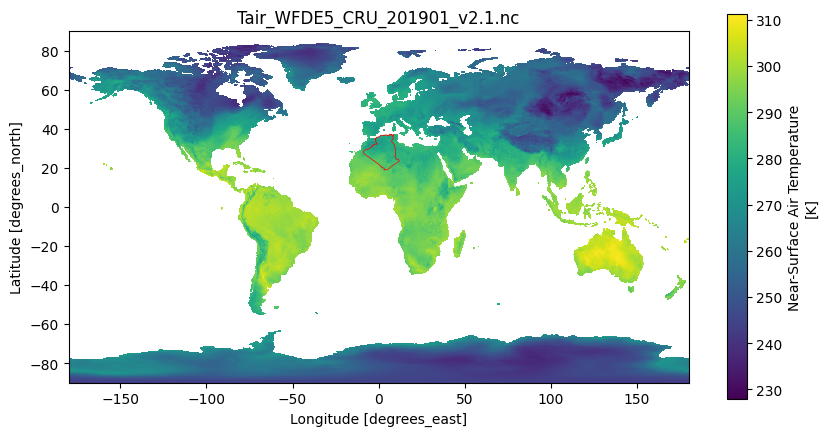

file : Tair_WFDE5_CRU_201902_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 697MB
Dimensions:  (time: 672, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


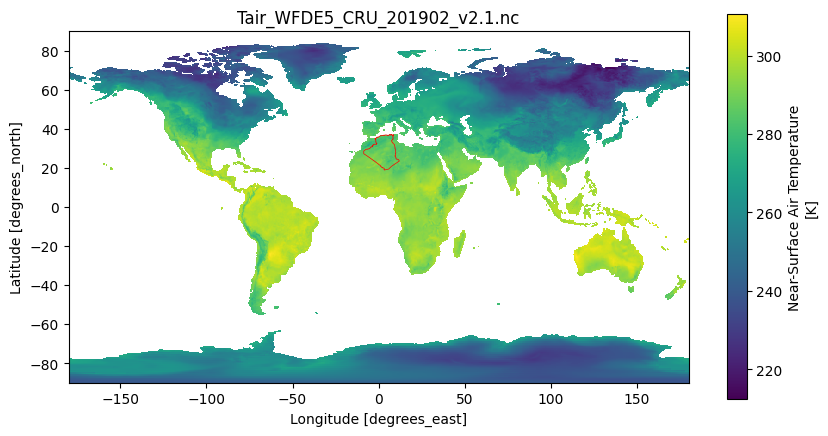

file : Tair_WFDE5_CRU_201903_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


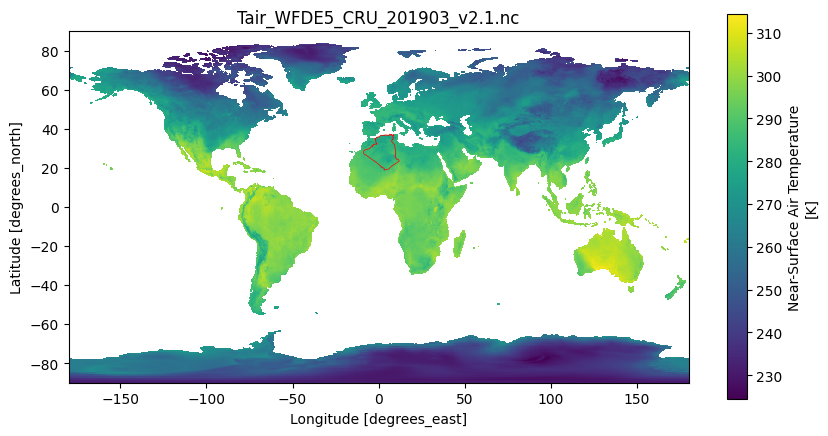

file : Tair_WFDE5_CRU_201904_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


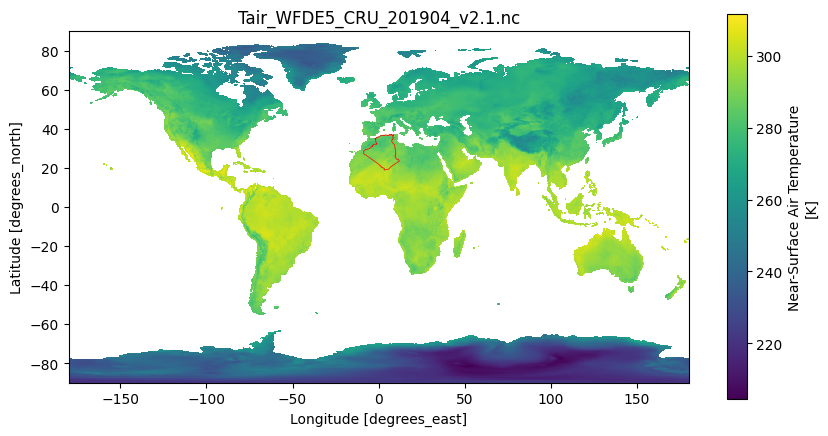

file : Tair_WFDE5_CRU_201905_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


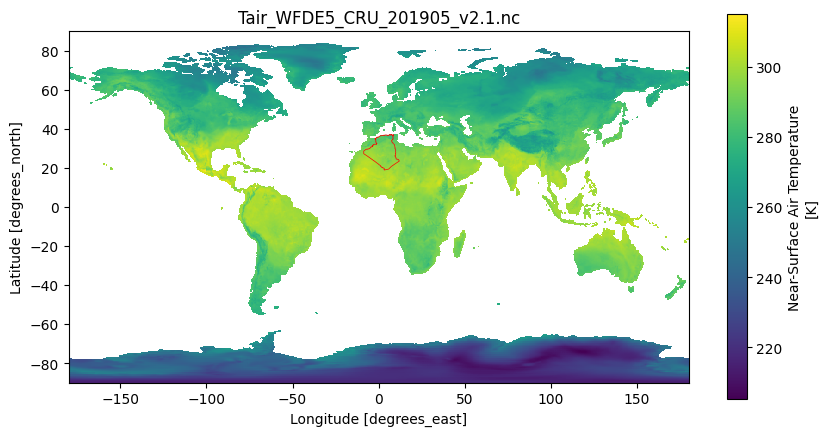

file : Tair_WFDE5_CRU_201906_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


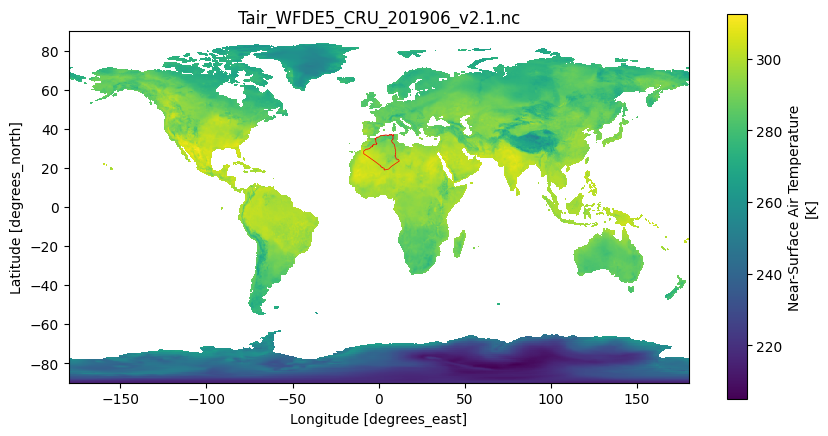

file : Tair_WFDE5_CRU_201907_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


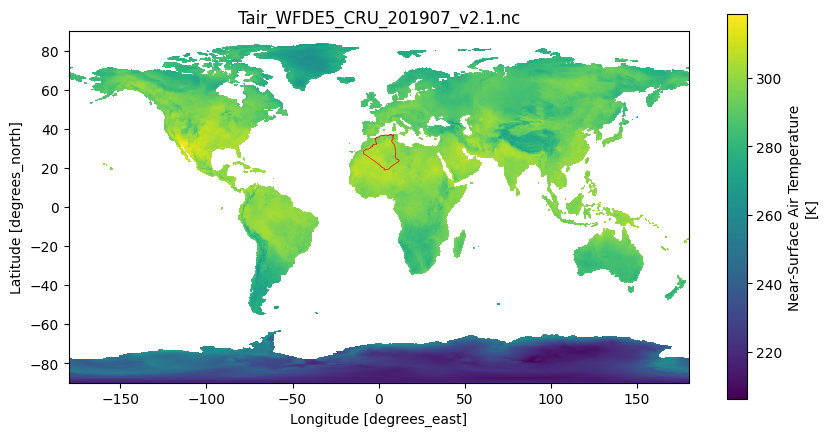

file : Tair_WFDE5_CRU_201908_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


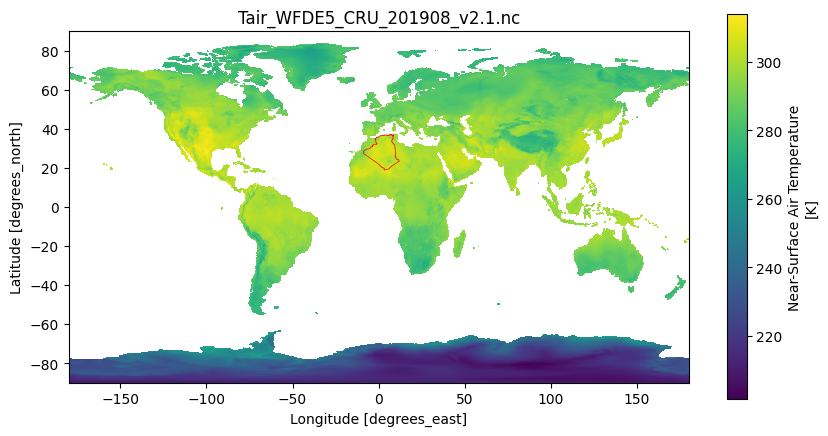

file : Tair_WFDE5_CRU_201909_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


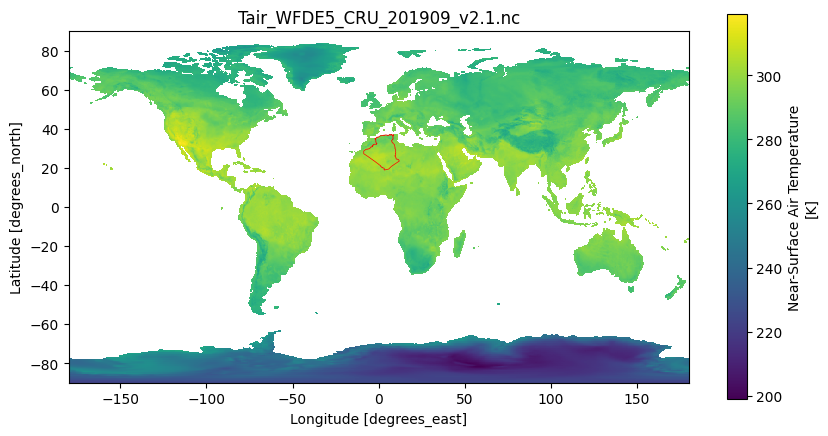

file : Tair_WFDE5_CRU_201910_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


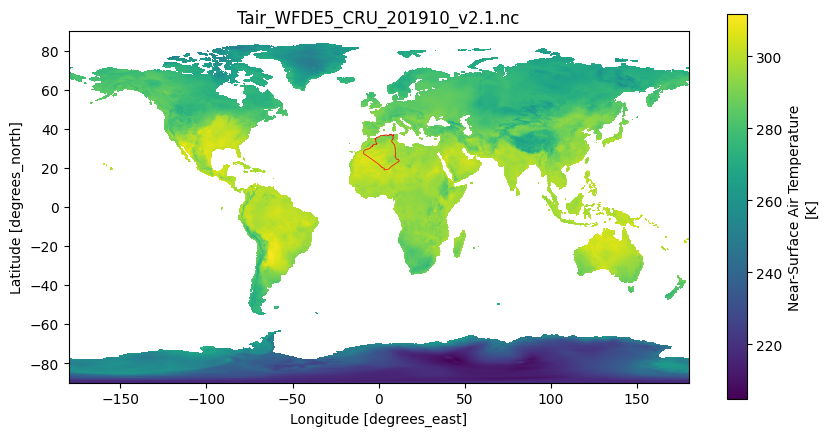

file : Tair_WFDE5_CRU_201911_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


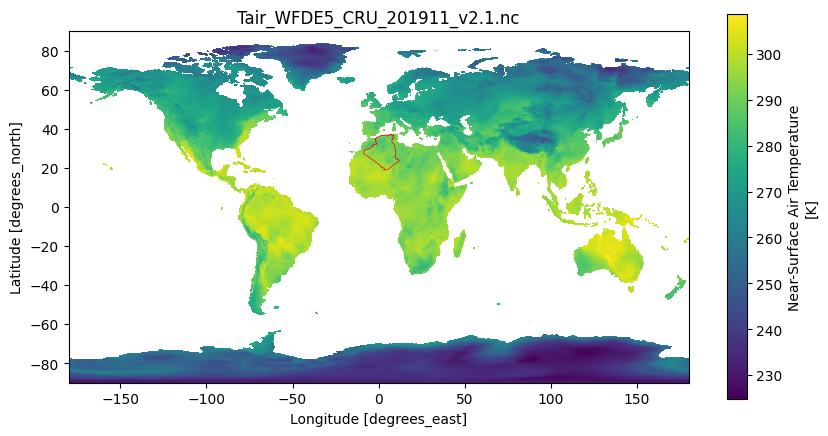

file : Tair_WFDE5_CRU_201912_v2.1.nc 
	['Tair']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Tair     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


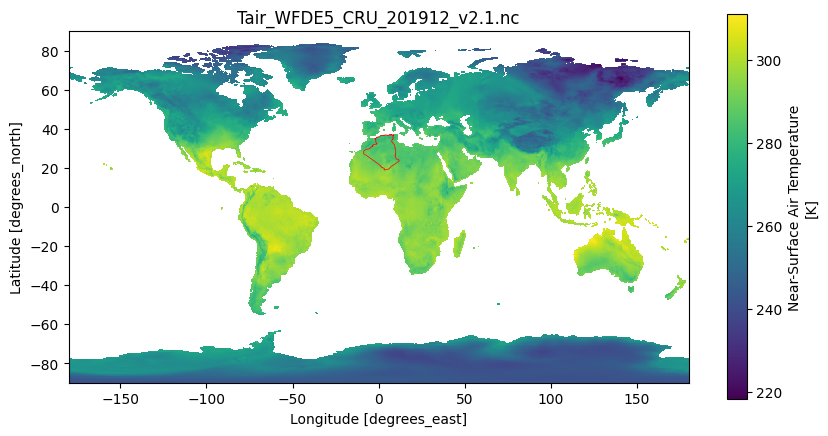

file : Wind_WFDE5_CRU_201901_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-01-01 ... 2019-01-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


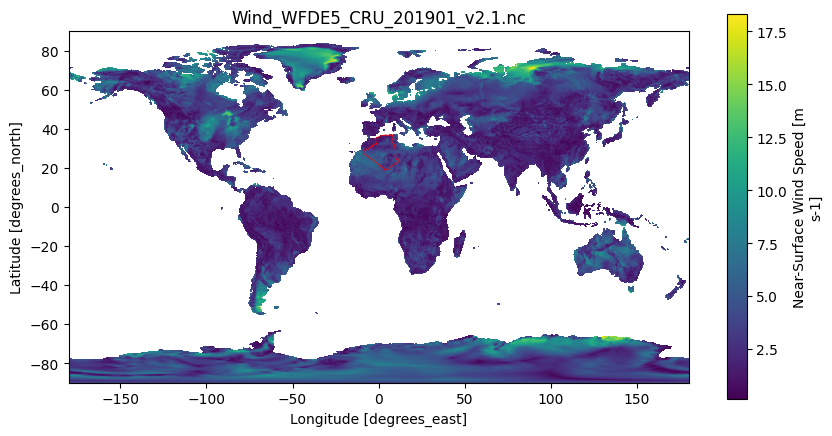

file : Wind_WFDE5_CRU_201902_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 697MB
Dimensions:  (time: 672, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 5kB 2019-02-01 ... 2019-02-28T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 697MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


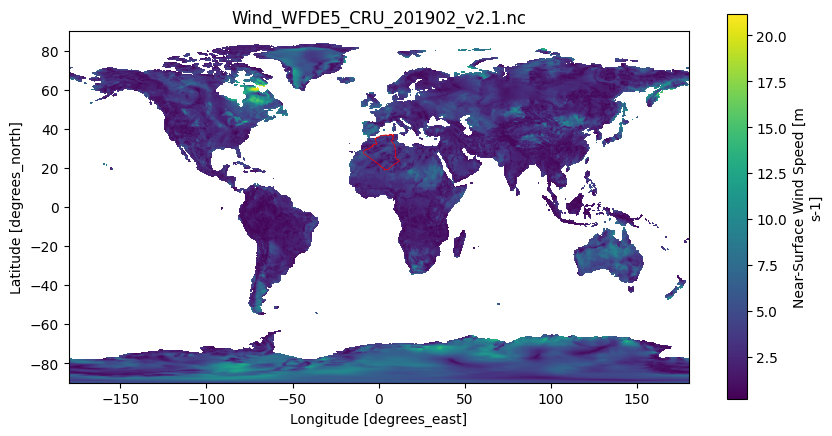

file : Wind_WFDE5_CRU_201903_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-03-01 ... 2019-03-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


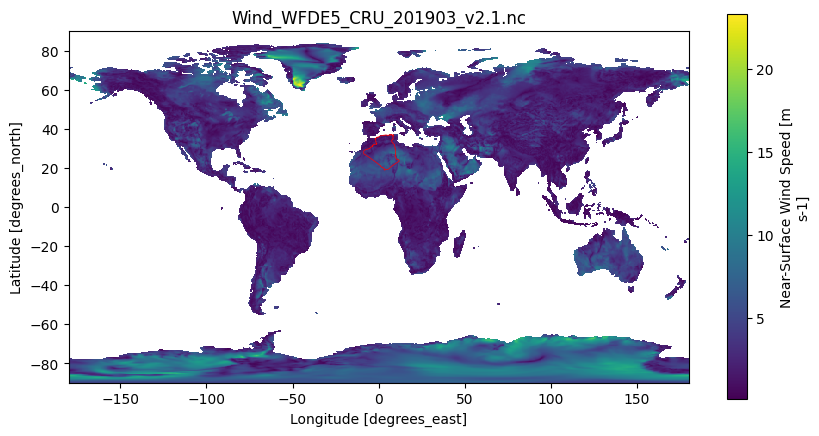

file : Wind_WFDE5_CRU_201904_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-04-01 ... 2019-04-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


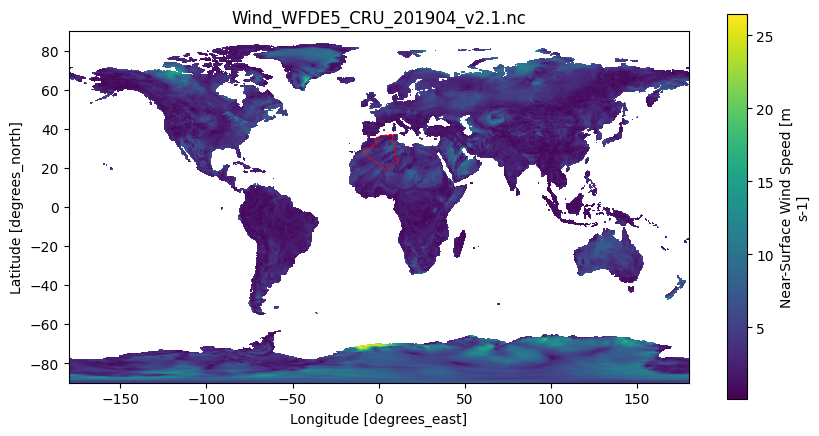

file : Wind_WFDE5_CRU_201905_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-05-01 ... 2019-05-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


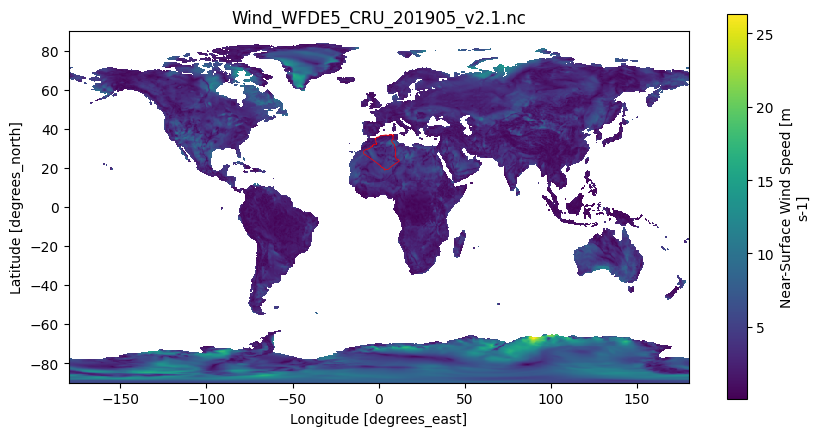

file : Wind_WFDE5_CRU_201906_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-06-01 ... 2019-06-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


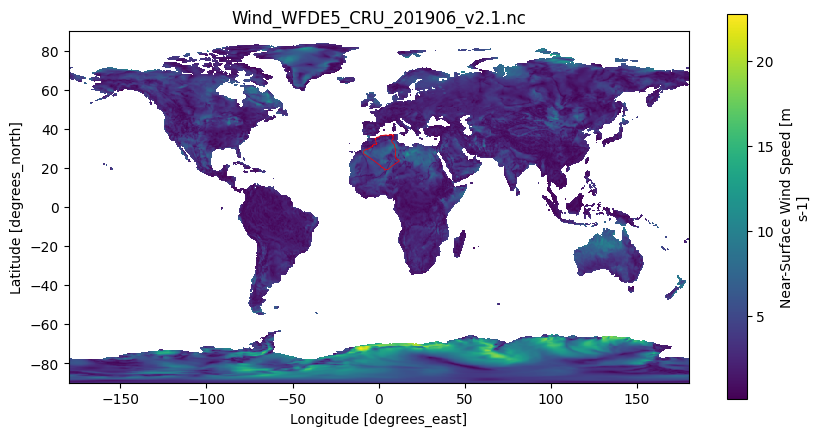

file : Wind_WFDE5_CRU_201907_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-07-01 ... 2019-07-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


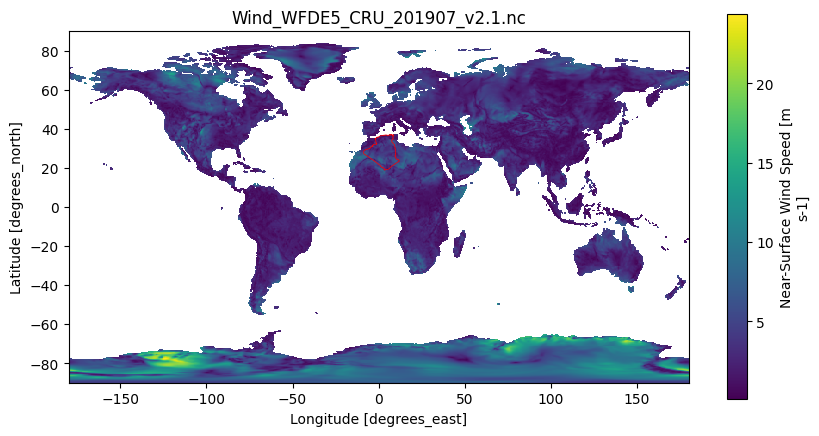

file : Wind_WFDE5_CRU_201908_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-08-01 ... 2019-08-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


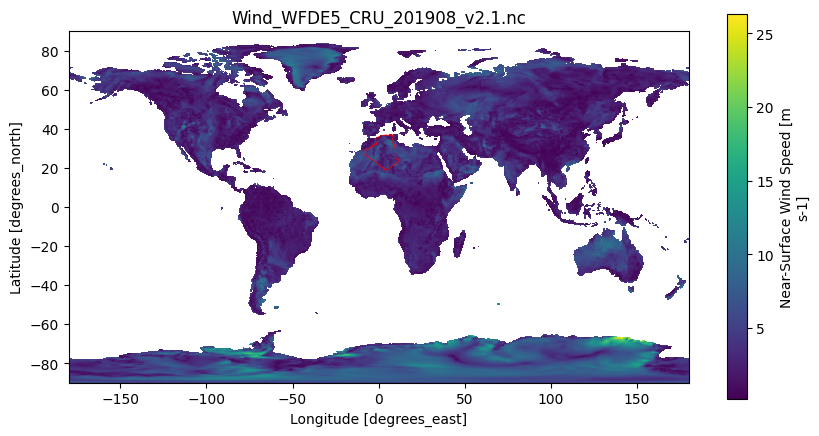

file : Wind_WFDE5_CRU_201909_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-09-01 ... 2019-09-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


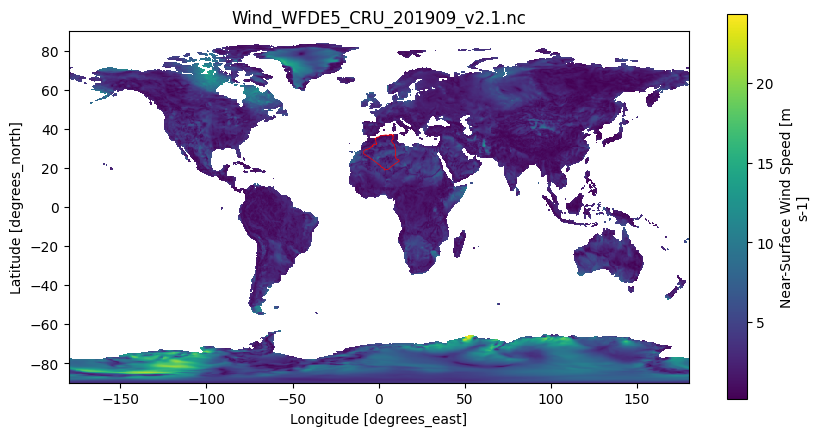

file : Wind_WFDE5_CRU_201910_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-10-01 ... 2019-10-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


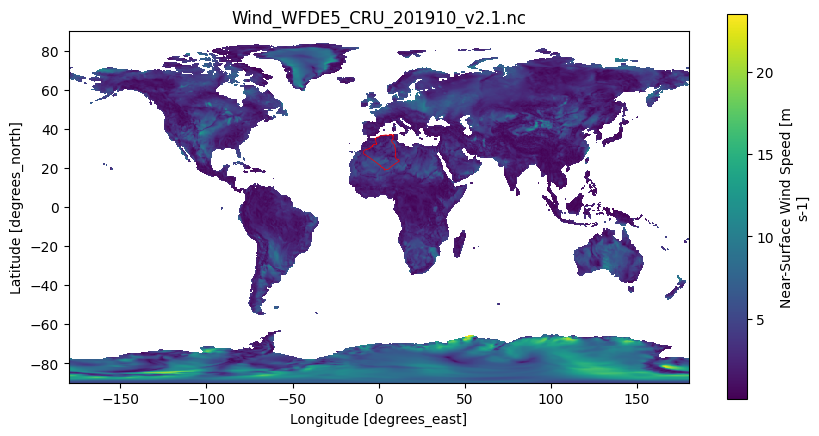

file : Wind_WFDE5_CRU_201911_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 747MB
Dimensions:  (time: 720, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-11-01 ... 2019-11-30T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 746MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


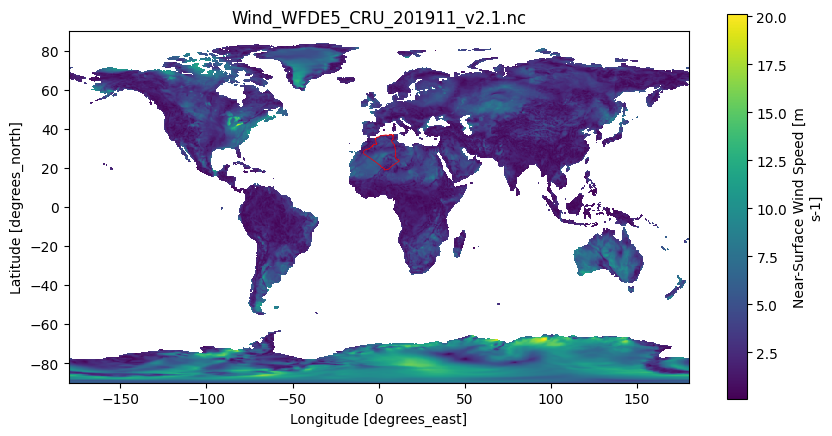

file : Wind_WFDE5_CRU_201912_v2.1.nc 
	['Wind']
<xarray.Dataset> Size: 771MB
Dimensions:  (time: 744, lon: 720, lat: 360)
Coordinates:
  * time     (time) datetime64[ns] 6kB 2019-12-01 ... 2019-12-31T23:00:00
  * lon      (lon) float64 6kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float64 3kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    Wind     (time, lat, lon) float32 771MB ...
Attributes:
    title:        WATCH Forcing Data methodology applied to ERA5 data
    institution:  Copernicus Climate Change Service
    contact:      http://copernicus-support.ecmwf.int
    comment:      Methodology implementation for ERA5 and dataset production ...
    Conventions:  CF-1.7
    summary:      ERA5 data regridded to half degree regular lat-lon; Genuine...
    reference:    Cucchi et al., 2020, Earth Syst. Sci. Data, 12(3), 2097–212...
    licence:      The dataset is distributed under the Licence to Use Coperni...


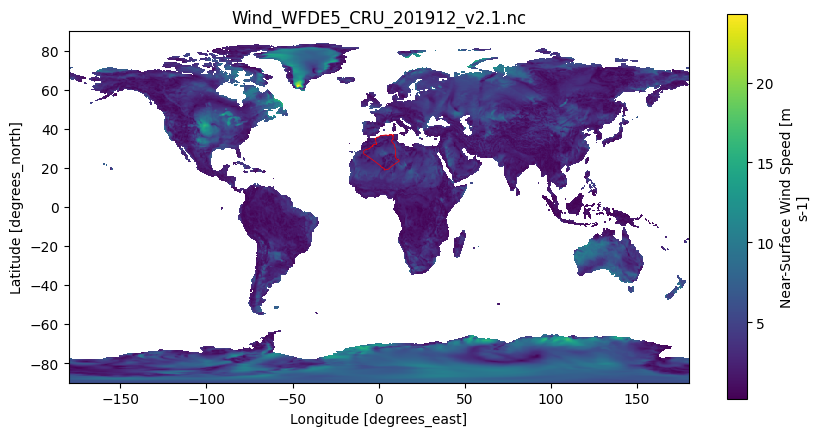

In [18]:
directory = 'data/Climate-DATA'
print(len(os.listdir(directory)), "files")
for filename in os.listdir(directory):
    # Get the full file path
    file_path = os.path.join(directory, filename)
    ds = xr.open_dataset(file_path)
    # Explore the dataset
    print(f"file : {filename} \n\t{list(ds.data_vars)}")
    print(ds)
    
    # Plot the first variable's first time step
    var_name = list(ds.data_vars)[0]
    fig, ax = plt.subplots(figsize=(10, 5))
    # Plot the climate data
    ds[var_name].isel(time=0).plot(ax=ax, cmap='viridis')
    # Plot the algeria boundaries
    algeria_data.boundary.plot(ax=ax, color='red', linewidth=0.5)
    # algeria_data.plot(ax=ax, color='none', edgecolor='red', linewidth=0.5)  # Outline polygons
    
    # Add title and show the plot
    plt.title(f"{filename}")
    plt.show()

- Finally, we extract **Algeria climate data** from the world climate data

In [ ]:
# def create_intersection_mask(lats, lons, polygons):
#     """Create a mask by intersecting grid points with polygons."""
#     # Generate grid points as a GeoDataFrame
#     lat_grid, lon_grid = np.meshgrid(lats, lons, indexing="ij")
#     points = [Point(lon, lat) for lon, lat in zip(lon_grid.ravel(), lat_grid.ravel())]
#     grid_gdf = gpd.GeoDataFrame(geometry=points, crs="EPSG:4326")  # Assuming WGS84 CRS
    
#     # Intersect grid points with polygons
#     algeria_mask = grid_gdf.geometry.apply(lambda x: any(x.within(poly) for poly in polygons))
    
#     # Reshape the mask to grid shape    
#     mask_array = algeria_mask.values.reshape(len(lats), len(lons))
#     return mask_array

In [ ]:
def create_raster_mask(lats, lons, polygons):
    """Crée un masque raster basé sur des polygones, aligné avec les grilles lat/lon."""
    transform = [
        lons[1] - lons[0], 0, lons[0],  # Longitudinal resolution and origin
        0, lats[1] - lats[0], lats[0]  # Latitudinal resolution and origin
    ]
    ny, nx = len(lats), len(lons)
    mask = rasterize(
        [(geom, 1) for geom in polygons], 
        out_shape=(ny, nx),
        transform=transform,
        fill=0, 
        dtype='uint8'
    )
    return mask

directory = 'data/Climate-DATA'
algeria_climate_dataset = []

for filename in os.listdir(directory):
    file_path = os.path.join(directory, filename)
    ds = xr.open_dataset(file_path)
    
    # Retrieve latitude and longitude coordinates
    lats = ds['lat'].values
    lons = ds['lon'].values
    # Create raster mask
    polygons = list(algeria_data['geometry'])
    mask = create_raster_mask(lats, lons, polygons)
    
    # Convert mask to DataArray
    mask_da = xr.DataArray(mask, dims = ["lat", "lon"], coords = {"lat": lats, "lon": lons})
    
    # Applying the mask
    masked_data = ds.where(mask_da, drop = True)
    algeria_climate_dataset.append(masked_data)
    
    # Save the results
    # os.makedirs('Algeria_Climate_Data', exist_ok = True)
    output_path = os.path.join(f"data/Algeria_Climate_Data/Algeria_{filename}")
    masked_data.to_netcdf(output_path)
    print(f"Algeria_{filename} file is successfully saved")

Algeria_PSurf_WFDE5_CRU_201901_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201902_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201903_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201904_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201905_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201906_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201907_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201908_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201909_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201910_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201911_v2.1.nc file is successfully saved
Algeria_PSurf_WFDE5_CRU_201912_v2.1.nc file is successfully saved
Algeria_Qair_WFDE5_CRU_201901_v2.1.nc file is successfully saved
Algeria_Qair_WFDE5_CRU_201902_v2.1.nc file is successfully saved
Algeria_Qair_WFDE5_CRU_201903_v2.1.nc file is successfully saved
Algeria_Qair_

- We plot the clipped **Algeria climate Data** 

Algeria_PSurf_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201901_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


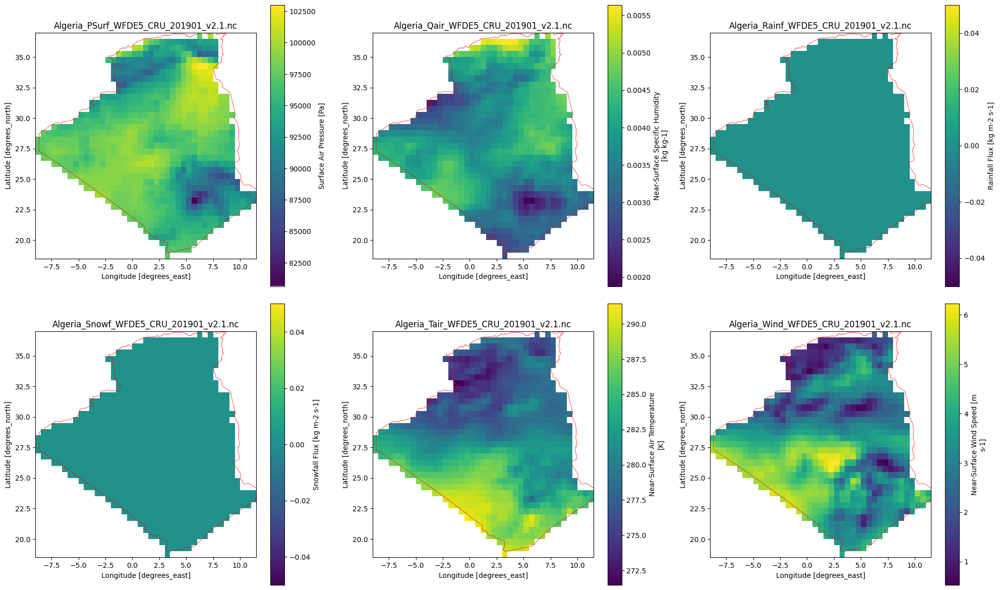

Algeria_PSurf_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201902_v2.1.nc : {'time': 672, 'lat': 37, 'lon': 41}


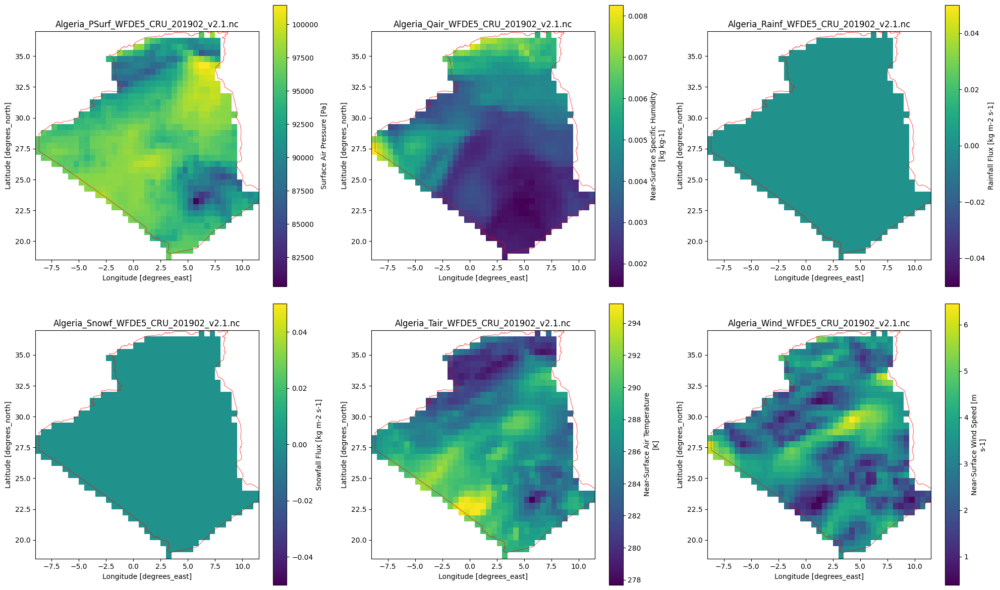

Algeria_PSurf_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201903_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


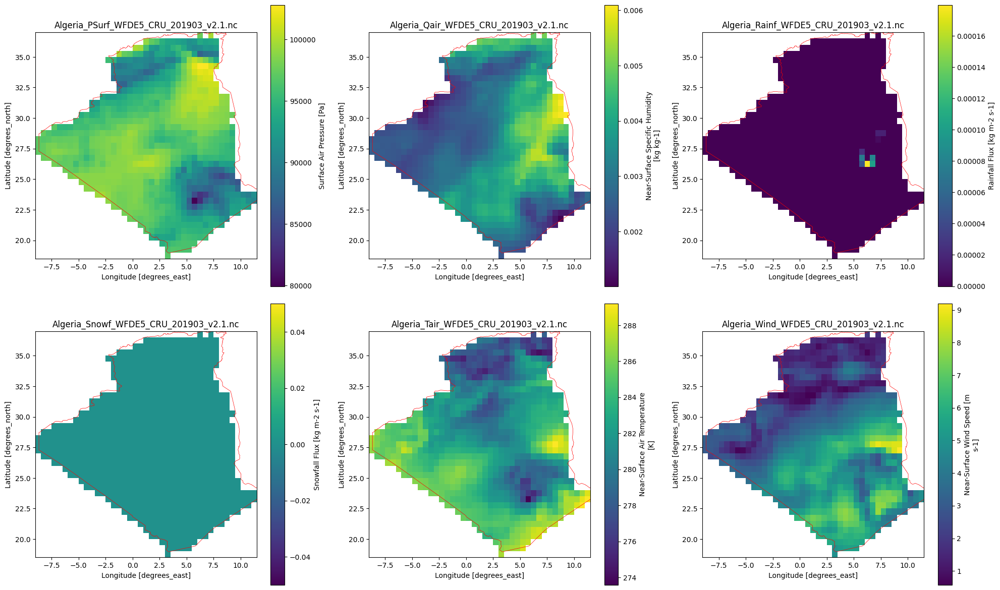

Algeria_PSurf_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201904_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}


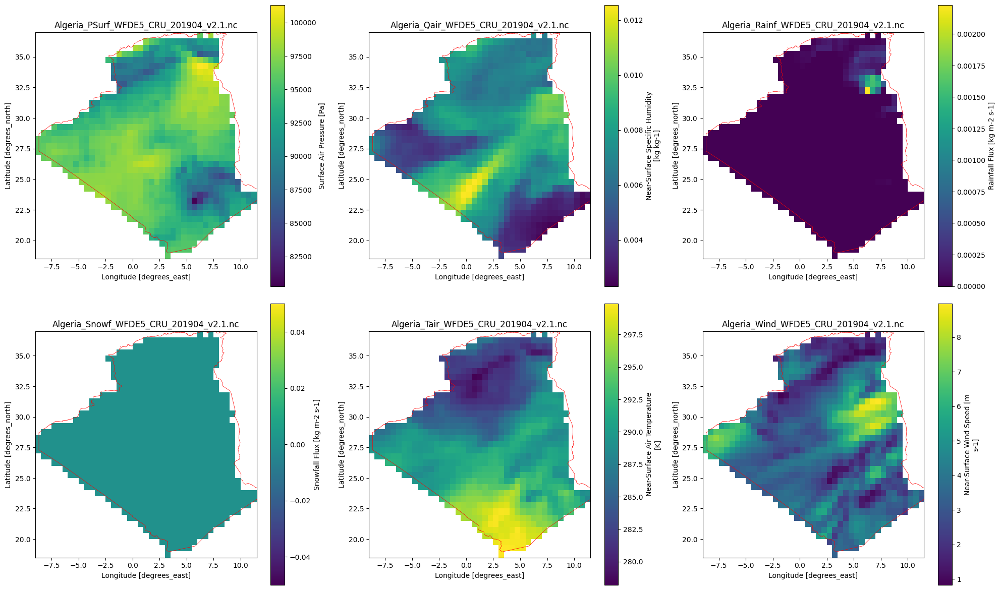

Algeria_PSurf_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201905_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


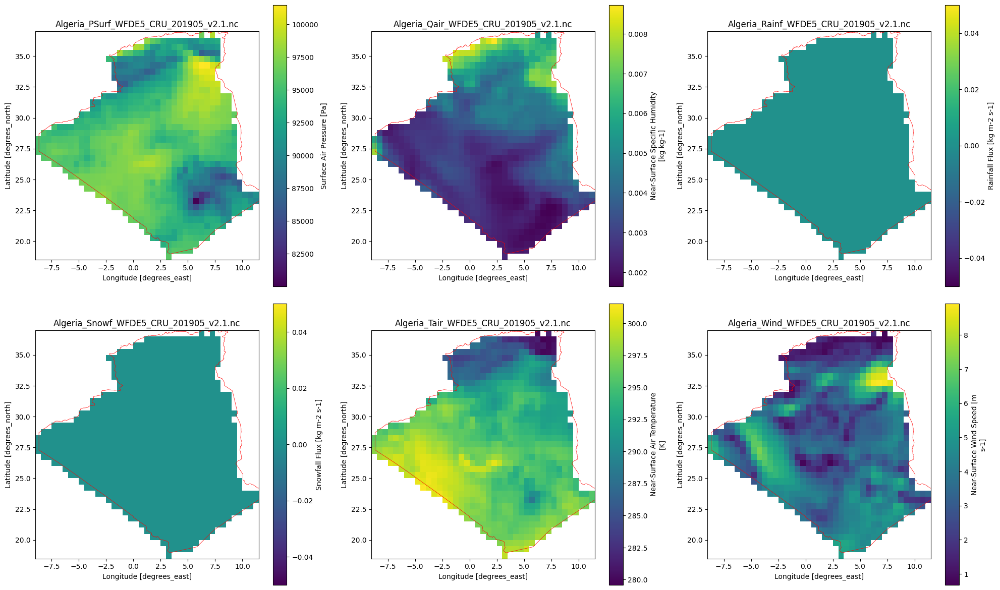

Algeria_PSurf_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201906_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}


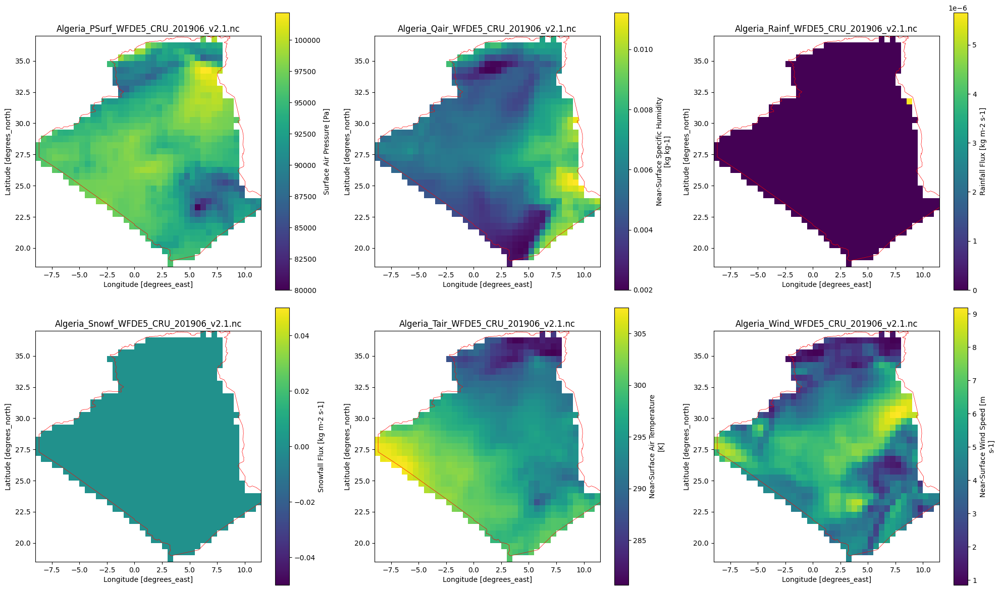

Algeria_PSurf_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201907_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


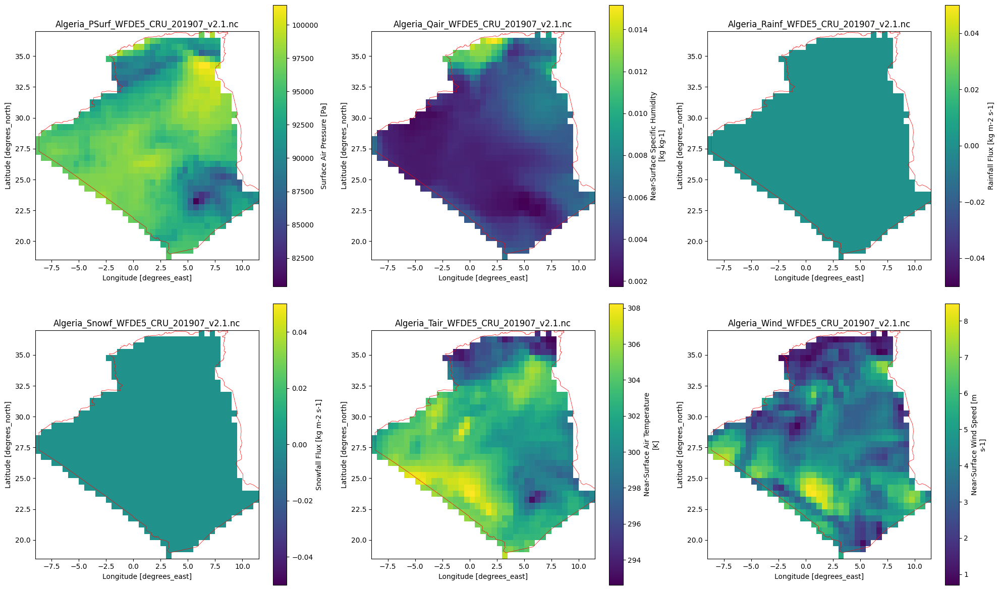

Algeria_PSurf_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201908_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


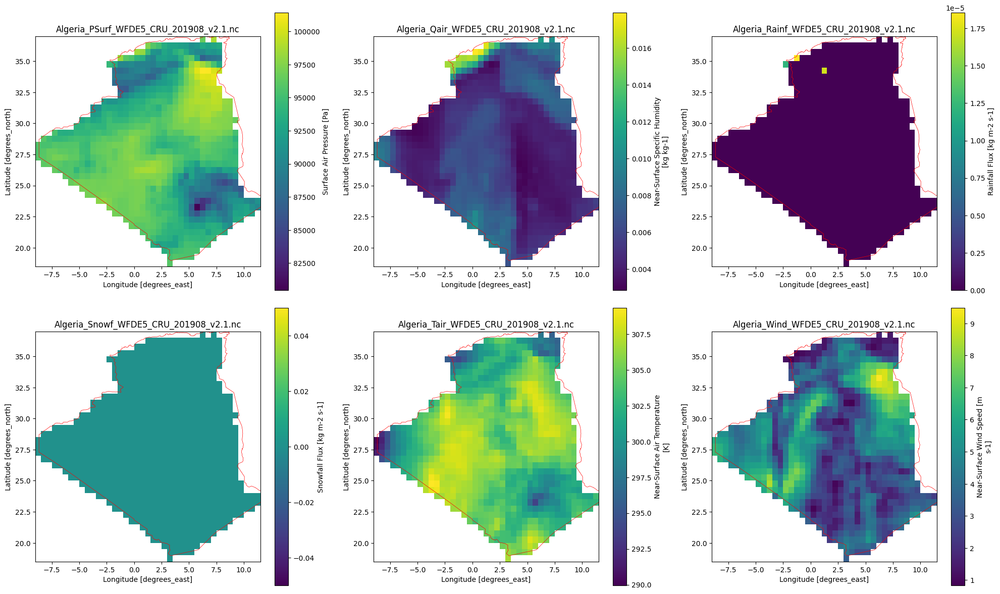

Algeria_PSurf_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201909_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}


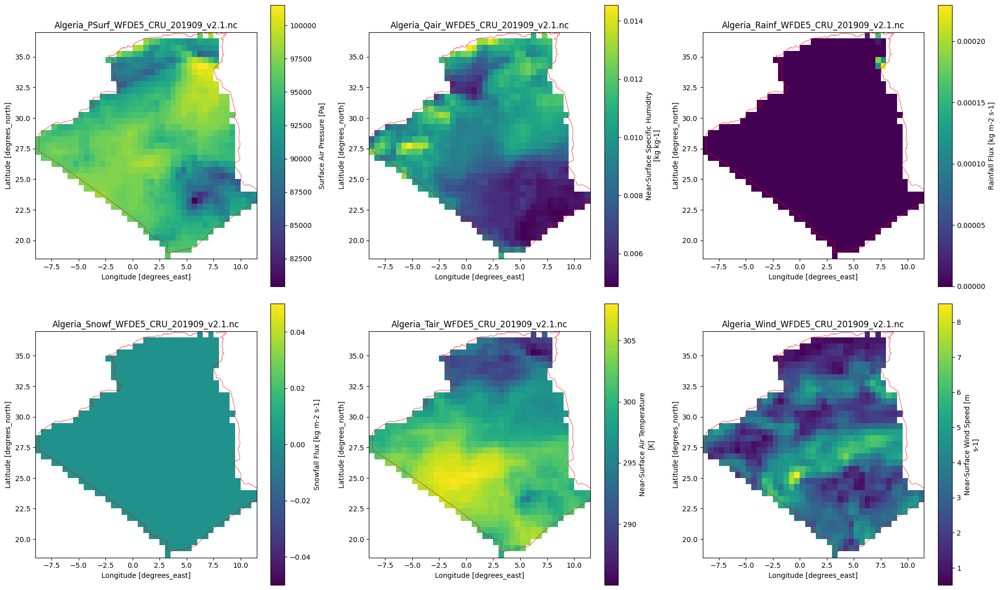

Algeria_PSurf_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201910_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


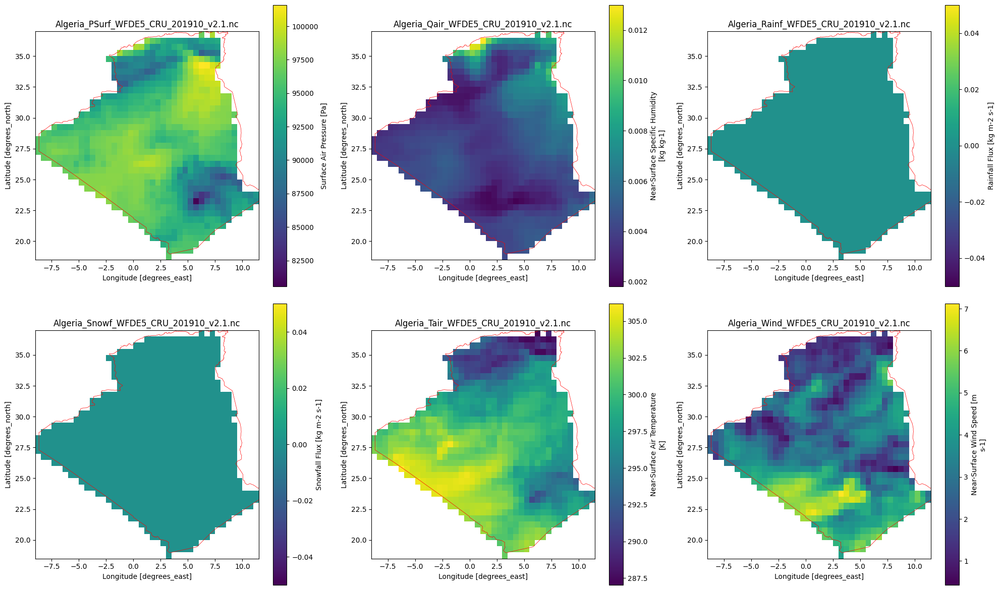

Algeria_PSurf_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201911_v2.1.nc : {'time': 720, 'lat': 37, 'lon': 41}


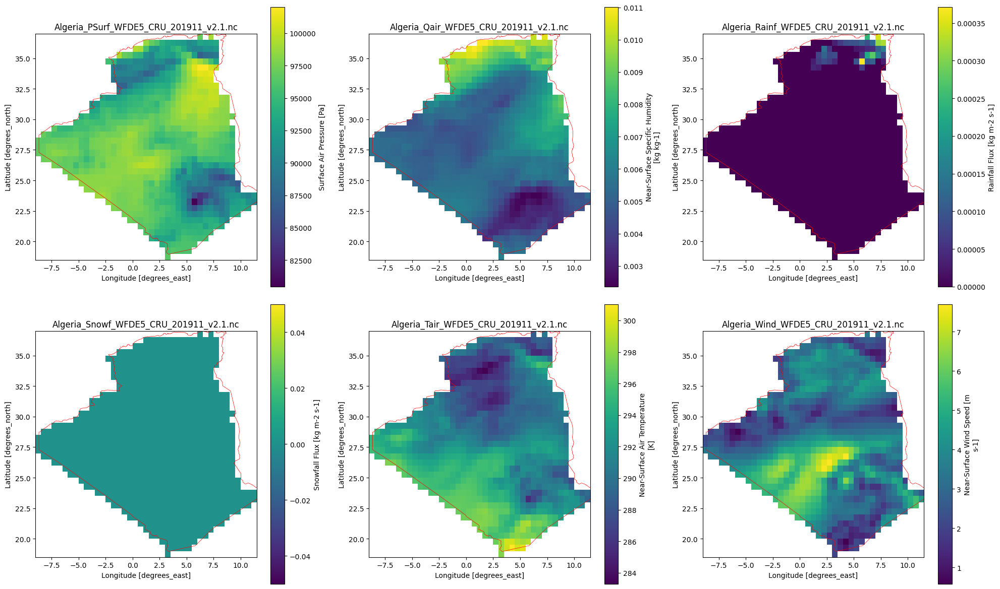

Algeria_PSurf_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Qair_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Rainf_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Snowf_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Tair_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}
Algeria_Wind_WFDE5_CRU_201912_v2.1.nc : {'time': 744, 'lat': 37, 'lon': 41}


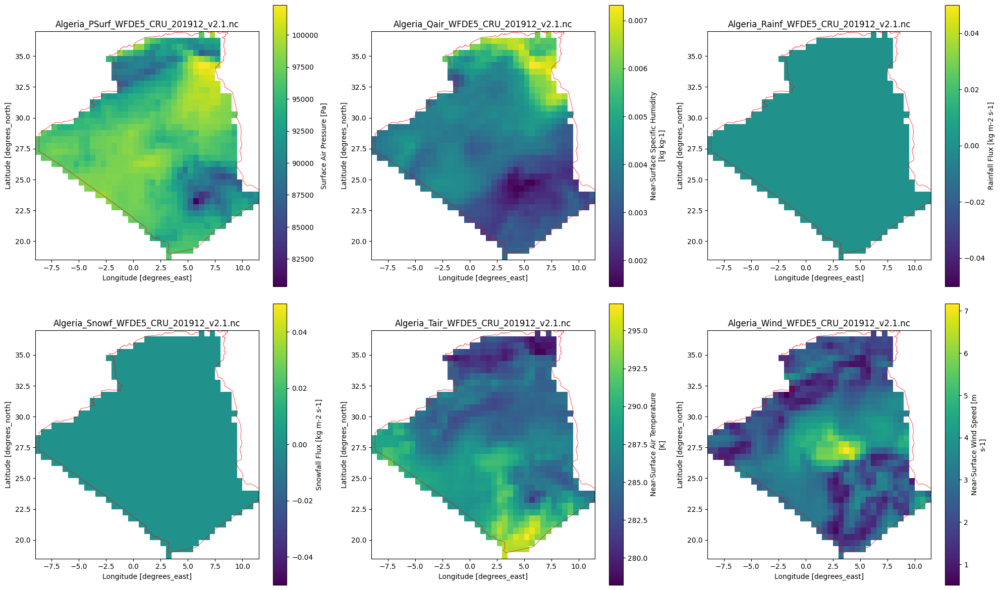

In [ ]:
directory = 'data/Algeria_Climate_Data'
files = os.listdir(directory)
files.sort(key = lambda x: x.split("_")[4])

# Cartes per figure
cards_per_figure = 6  # 3x2 each month in the same figure

for i in range(0, len(files), cards_per_figure):
    batch_files = files[i:i + cards_per_figure]
    
    # Determine the number of rows and columns for the current group
    num_files = len(batch_files)
    num_cols = 3
    num_rows = math.ceil(num_files / num_cols)
    
    # create a figure
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 6 * num_rows))
    axes = axes.flatten()
    
    # Trace each file in the batch
    for j, file in enumerate(batch_files):
        file_path = os.path.join(directory, file)
        dz_ds = xr.open_dataset(file_path)
        var_name = list(dz_ds.data_vars.keys())[0]  # Première variable
        
        shape_info = {dim: size for dim, size in dz_ds.sizes.items()}
        print(f"{file} : {shape_info}")
        
        dz_ds[var_name].isel(time=0).plot(ax=axes[j], cmap='viridis')
        algeria_data.boundary.plot(ax=axes[j], color='red', linewidth=0.5)
        axes[j].set_title(file)

    # Hide unused axes
    for k in range(len(batch_files), len(axes)):
        axes[k].axis('off')

    plt.tight_layout()
    plt.show()

## B. **Merging the clipped data into one `.csv` file**

#### Getting **the attributes:**

In [22]:
attributes = set({})
directory = "data/Algeria_Climate_Data"
for filename in os.listdir(directory):
    attributes.add(filename.split("_")[1])
    
attributes

{'PSurf', 'Qair', 'Rainf', 'Snowf', 'Tair', 'Wind'}

#### Merging Data of **Specific attribute**:

In [ ]:
# dictionary to store datasets for each variable
datasets = {}
data_dir = "data/Algeria_Climate_Data"

for attr in attributes:
    # find all files of the current variable
    var_files = sorted([os.path.join(data_dir, file) for file in os.listdir(data_dir) if attr in file])
    print(var_files)

    # Load files individually and concatenate them
    ds_list = [xr.open_dataset(file, engine="netcdf4") for file in var_files]
    ds_var = xr.concat(ds_list, dim="time")  # Adjust 'dim' to the dimension used for concatenation
    # ds_var = xr.open_mfdataset(var_files, combine = "by_coords", chunks=None)

    # add it to the dictionary 
    datasets[attr] = ds_var

# close the opend files
for ds in ds_list:
    ds.close()

['data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201901_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201902_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201903_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201904_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201905_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201906_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201907_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201908_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201909_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201910_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201911_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Snowf_WFDE5_CRU_201912_v2.1.nc']
['data/Algeria_Climate_Data\\Algeria_Wind_WFDE5_CRU_201901_v2.1.nc', 'data/Algeria_Climate_Data\\Algeria_Wind_WFDE5_CRU_201902_v2.1.nc', 'data/Algeria_Climate_Data\\Algeri

### Merging all data

In [ ]:
# Merge all datasets on their common dimensions
merged_ds = xr.merge(datasets.values())

# Convert the merged dataset to DataFrame
algeria_climate_csv = merged_ds.to_dataframe().reset_index()

# Save the DataFrame to CSV
algeria_climate_csv.to_csv("data/Climate_dz_data.csv", index = False)
print(f"Climate_dz_data.csv is successfully created")

Climate_dz_data.csv is successfully created


In [115]:
algeria_climate_csv # ([8760 * 37 lats * 41 longs] , [time + lat + log + 6 variables]) = (13288920, 9)

,time,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair
0,2019-01-01 00:00:00,18.75,-8.75,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-01-01 00:00:00,18.75,-8.25,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-01-01 00:00:00,18.75,-7.75,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-01-01 00:00:00,18.75,-7.25,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-01-01 00:00:00,18.75,-6.75,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
13288915,2019-12-31 23:00:00,36.75,9.25,NaN,NaN,NaN,NaN,NaN,NaN
13288916,2019-12-31 23:00:00,36.75,9.75,NaN,NaN,NaN,NaN,NaN,NaN
13288917,2019-12-31 23:00:00,36.75,10.25,NaN,NaN,NaN,NaN,NaN,NaN
13288918,2019-12-31 23:00:00,36.75,10.75,NaN,NaN,NaN,NaN,NaN,NaN


### Eliminating all NAN values that doesn't belongs to Algeria boundries

In [ ]:
# Check rows where all values are NaN (excluding specific columns as time, lat, lon)
columns_to_check = ['Wind', 'PSurf', 'Tair', 'Qair', 'Rainf', 'Snowf']  # Columns to validate
mask_all_nan = algeria_climate_csv[columns_to_check].isna().all(axis=1)

# Drop rows where all specified columns are NaN
algeria_climate_csv = algeria_climate_csv[~mask_all_nan]  # Keep rows where not all values are NaN
algeria_climate_csv = algeria_climate_csv.reset_index(drop=True)
algeria_climate_csv.to_csv("data/Climate_dz_data_2.csv", index = False)
print(f"Climate_dz_data_2.csv is successfully created")
algeria_climate_csv # (13288920, 9) - (7472280, 9) = 5 816 640 doesn't belongs to algiers

Climate_dz_data_2.csv is successfully created


,time,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair
0,2019-01-01 00:00:00,18.75,3.25,0.0,3.952470,290.51390,97173.320,0.0,0.002778
1,2019-01-01 00:00:00,19.25,3.25,0.0,3.637232,289.51474,96483.320,0.0,0.002839
2,2019-01-01 00:00:00,19.25,3.75,0.0,3.534133,289.55704,97020.234,0.0,0.002797
3,2019-01-01 00:00:00,19.25,4.25,0.0,3.620100,289.35562,96880.740,0.0,0.002940
4,2019-01-01 00:00:00,19.25,4.75,0.0,3.934568,289.17150,96704.730,0.0,0.003037
...,...,...,...,...,...,...,...,...,...
7472275,2019-12-31 23:00:00,36.25,6.75,0.0,0.651263,272.13004,93626.840,0.0,0.003335
7472276,2019-12-31 23:00:00,36.25,7.25,0.0,1.050017,271.71640,94018.250,0.0,0.003441
7472277,2019-12-31 23:00:00,36.25,7.75,0.0,1.258993,271.88080,94437.230,0.0,0.003524
7472278,2019-12-31 23:00:00,36.75,6.25,0.0,1.224254,274.19560,98216.090,0.0,0.003594


# Reading datasets

- soil_dz_allprops.csv

In [2]:
soil_algeria = pd.read_csv("data/soil_dz_allprops.csv" , delimiter=',')
print(soil_algeria.shape)
soil_algeria.describe()

(295, 25)


,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
count,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,...,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000
mean,32.921993,32.022858,18.050939,17.960102,18.216224,19.102000,5.246007,5.332427,0.438613,0.254453,...,10.054031,9.420312,38.503186,32.350203,6.177993,8.850132,0.987186,0.975797,7.314068,6.884983
std,23.743970,22.866685,13.795567,13.218837,14.229619,14.877827,3.352199,3.404668,0.356333,0.180211,...,8.779385,8.709818,25.202270,21.700717,6.927369,9.520785,0.640324,0.625597,4.935714,4.735834
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,36.090000,36.490000,18.546000,19.100000,22.730000,22.320000,7.300000,7.460000,0.447500,0.288000,...,9.750000,8.660000,49.400000,42.300000,3.580000,5.115000,1.340000,1.340000,9.300000,8.500000
75%,50.390000,46.550000,26.220000,27.900000,25.200000,27.165000,7.700000,7.800000,0.678000,0.400000,...,14.400000,13.870000,58.050000,48.800000,10.980000,16.185000,1.470000,1.430000,10.450000,10.600000
max,96.000000,94.700000,54.000000,50.730000,60.600000,63.570000,9.630000,9.700000,2.411000,0.742000,...,47.160000,48.960000,78.900000,73.000000,33.540000,43.860000,1.840000,1.840000,20.800000,16.400000


- Climate_dz_data_2.csv

In [3]:
algeria_climate_csv = pd.read_csv("data/Climate_dz_data_2.csv")
algeria_climate_csv['time'] = pd.to_datetime(algeria_climate_csv['time'])
algeria_climate_csv

,time,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair
0,2019-01-01 00:00:00,18.75,3.25,0.0,3.952470,290.51390,97173.320,0.0,0.002778
1,2019-01-01 00:00:00,19.25,3.25,0.0,3.637232,289.51474,96483.320,0.0,0.002839
2,2019-01-01 00:00:00,19.25,3.75,0.0,3.534133,289.55704,97020.234,0.0,0.002797
3,2019-01-01 00:00:00,19.25,4.25,0.0,3.620100,289.35562,96880.740,0.0,0.002940
4,2019-01-01 00:00:00,19.25,4.75,0.0,3.934568,289.17150,96704.730,0.0,0.003037
...,...,...,...,...,...,...,...,...,...
7472275,2019-12-31 23:00:00,36.25,6.75,0.0,0.651263,272.13004,93626.840,0.0,0.003335
7472276,2019-12-31 23:00:00,36.25,7.25,0.0,1.050017,271.71640,94018.250,0.0,0.003441
7472277,2019-12-31 23:00:00,36.25,7.75,0.0,1.258993,271.88080,94437.230,0.0,0.003524
7472278,2019-12-31 23:00:00,36.75,6.25,0.0,1.224254,274.19560,98216.090,0.0,0.003594


In [4]:
len(algeria_climate_csv["time"].unique()) # 744 (24h * 31j) * 7 + 672 (24h * 28j) + 720 (24h * 30j) * 4 = 8760

8760

In [5]:
algeria_climate_csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7472280 entries, 0 to 7472279
Data columns (total 9 columns):
 #   Column  Dtype         
---  ------  -----         
 0   time    datetime64[ns]
 1   lat     float64       
 2   lon     float64       
 3   Snowf   float64       
 4   Wind    float64       
 5   Tair    float64       
 6   PSurf   float64       
 7   Rainf   float64       
 8   Qair    float64       
dtypes: datetime64[ns](1), float64(8)
memory usage: 513.1 MB


## C. **Data reduction** through aggregation before preprocessing

In [6]:
algeria_climate_csv.sample(10)

,time,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair
5372822,2019-09-20 10:00:00,30.75,5.75,0.0,5.203557,312.82263,98848.914,0.0,0.007190
442224,2019-01-22 14:00:00,27.25,-8.75,0.0,2.904810,294.45550,96700.180,0.0,0.003980
5293627,2019-09-16 13:00:00,34.25,-1.25,0.0,3.769859,303.30197,88387.830,0.0,0.010012
814079,2019-02-09 18:00:00,26.25,1.25,0.0,4.572545,296.69790,100113.805,0.0,0.002194
5580361,2019-09-30 14:00:00,20.75,6.75,0.0,5.516796,311.83140,94556.266,0.0,0.005459
2101521,2019-04-13 15:00:00,30.25,-3.75,0.0,3.916020,297.49857,93579.850,0.0,0.002922
3221844,2019-06-07 09:00:00,21.75,4.75,0.0,8.540758,308.14542,93170.010,0.0,0.006319
173415,2019-01-09 11:00:00,25.25,3.75,0.0,2.563407,293.26828,94071.410,0.0,0.002200
3160811,2019-06-04 09:00:00,28.25,-7.75,0.0,3.382263,305.48773,95787.150,0.0,0.005363
3297498,2019-06-11 01:00:00,31.25,5.25,0.0,4.843295,302.69470,97900.460,0.0,0.002420


In [7]:
# Ensure 'time' is the DataFrame index for resampling
try:
    algeria_climate_csv.set_index("time", inplace=True)
except:
    pass

columns_to_round = ['Wind','PSurf','Tair','Qair','Rainf','Snowf']
# Apply round to these columns
algeria_climate_csv[columns_to_round] = algeria_climate_csv[columns_to_round].round(5)

In [8]:
algeria_climate_csv

,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair
time,,,,,,,,
2019-01-01 00:00:00,18.75,3.25,0.0,3.95247,290.51390,97173.320,0.0,0.00278
2019-01-01 00:00:00,19.25,3.25,0.0,3.63723,289.51474,96483.320,0.0,0.00284
2019-01-01 00:00:00,19.25,3.75,0.0,3.53413,289.55704,97020.234,0.0,0.00280
2019-01-01 00:00:00,19.25,4.25,0.0,3.62010,289.35562,96880.740,0.0,0.00294
2019-01-01 00:00:00,19.25,4.75,0.0,3.93457,289.17150,96704.730,0.0,0.00304
...,...,...,...,...,...,...,...,...
2019-12-31 23:00:00,36.25,6.75,0.0,0.65126,272.13004,93626.840,0.0,0.00334
2019-12-31 23:00:00,36.25,7.25,0.0,1.05002,271.71640,94018.250,0.0,0.00344
2019-12-31 23:00:00,36.25,7.75,0.0,1.25899,271.88080,94437.230,0.0,0.00352


## **By Month**

In [9]:
# Group by month, lat, and lon, and apply mean aggregation for the numerical columns
monthly_data = algeria_climate_csv.groupby([pd.Grouper(freq='ME'), 'lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean'
}).reset_index()

monthly_data['year_month'] = monthly_data['time'].dt.strftime('%Y-%m')

# Set the new column as the index
monthly_data.set_index('year_month', inplace=True)
# Show the aggregated data
monthly_data
monthly_data[columns_to_round] = monthly_data[columns_to_round].round(5)

In [10]:
monthly_data  # 37 * 41 * 12 mois = 18204 with NaN values

,time,lat,lon,Tair,Qair,Rainf,Snowf,PSurf,Wind
year_month,,,,,,,,,
2019-01,2019-01-31,18.75,3.25,293.64999,0.00240,0.00000,0.0,96770.33070,4.12699
2019-01,2019-01-31,19.25,3.25,292.75000,0.00238,0.00000,0.0,96083.29857,4.00645
2019-01,2019-01-31,19.25,3.75,292.85000,0.00236,0.00000,0.0,96627.30431,4.05956
2019-01,2019-01-31,19.25,4.25,292.94999,0.00240,0.00000,0.0,96501.84637,4.14203
2019-01,2019-01-31,19.25,4.75,292.95000,0.00240,0.00000,0.0,96339.15178,4.19329
...,...,...,...,...,...,...,...,...,...
2019-12,2019-12-31,36.25,6.75,282.45002,0.00558,0.00002,0.0,92573.84247,2.76125
2019-12,2019-12-31,36.25,7.25,282.75000,0.00564,0.00002,0.0,92953.05885,2.97757
2019-12,2019-12-31,36.25,7.75,282.95000,0.00576,0.00002,0.0,93366.91369,2.94145


## **By season** 

In [11]:
def get_season(row):
    """Determine the meteorological season for a given date."""
    month = row.month
    day = row.day

    if month in [1, 2, 12]:  # Winter
        return "winter"
    elif month in [3, 4, 5]:  # Spring
        return "spring"
    elif month in [6, 7, 8]:  # Summer
        return "summer"
    elif month in [9, 10, 11]:  # Fall
        return "fall"

# Apply the function to a new column in the DataFrame
algeria_climate_csv['season'] = algeria_climate_csv.index.to_series().apply(get_season)

In [12]:
fall_data   = algeria_climate_csv[algeria_climate_csv['season'] == "fall"]
spring_data = algeria_climate_csv[algeria_climate_csv['season'] == "spring"]
summer_data = algeria_climate_csv[algeria_climate_csv['season'] == "summer"]
winter_data = algeria_climate_csv[algeria_climate_csv['season'] == "winter"]

In [13]:
fall_data = fall_data.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

winter_data = fall_data.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

summer_data = fall_data.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

spring_data = fall_data.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

fall_data[columns_to_round] = fall_data[columns_to_round].round(5)
spring_data[columns_to_round] = spring_data[columns_to_round].round(5)
summer_data[columns_to_round] = summer_data[columns_to_round].round(5)
winter_data[columns_to_round] = winter_data[columns_to_round].round(5)

len(fall_data) + len(spring_data) + len(summer_data) + len(winter_data) # (37 * 41) = 1517 * 4 = 6068 with NAN values

3412

- Merging the aggregated datasets

In [14]:
# Now, merge the datasets with suffixes for each season
final_climate_data = fall_data.merge(summer_data, on=['lat', 'lon'], suffixes=('_fall', '_summer'))
final_climate_data = final_climate_data.merge(spring_data, on=['lat', 'lon'], suffixes=('_summer', '_spring'))
final_climate_data = final_climate_data.merge(winter_data, on=['lat', 'lon'], suffixes=('_spring', '_winter'))

# Display the merged dataframe columns
print(final_climate_data.shape) # ([37 lat + 41 log], [lat + long + 4 seasons * 6 attributes]) = (1517, 26) with NAN values
final_climate_data.head()

(853, 26)


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,Tair_summer,Qair_summer,...,Rainf_spring,Snowf_spring,PSurf_spring,Wind_spring,Tair_winter,Qair_winter,Rainf_winter,Snowf_winter,PSurf_winter,Wind_winter
0,18.75,3.25,303.05441,0.00538,0.0,0.0,96260.60873,3.63027,303.05441,0.00538,...,0.0,0.0,96260.60873,3.63027,303.05441,0.00538,0.0,0.0,96260.60873,3.63027
1,19.25,3.25,302.48736,0.00503,0.0,0.0,95590.48267,3.67397,302.48736,0.00503,...,0.0,0.0,95590.48267,3.67397,302.48736,0.00503,0.0,0.0,95590.48267,3.67397
2,19.25,3.75,302.48736,0.00490,0.0,0.0,96110.34701,3.68470,302.48736,0.00490,...,0.0,0.0,96110.34701,3.68470,302.48736,0.00490,0.0,0.0,96110.34701,3.68470
3,19.25,4.25,302.52142,0.00489,0.0,0.0,95987.59770,3.73920,302.52142,0.00489,...,0.0,0.0,95987.59770,3.73920,302.52142,0.00489,0.0,0.0,95987.59770,3.73920
4,19.25,4.75,302.52033,0.00489,0.0,0.0,95832.66874,3.78145,302.52033,0.00489,...,0.0,0.0,95832.66874,3.78145,302.52033,0.00489,0.0,0.0,95832.66874,3.78145


In [15]:
final_climate_data.columns
final_climate_data.to_csv("data/Climate_dz_data_aggregated.csv", sep = ",", index = False)
print("Climate_dz_data_aggregated.csv is successfully created")

Climate_dz_data_aggregated.csv is successfully created


# D. Data integration : merges data from multiple sources in to a single coherent dataset before preprocessing

In [16]:
gdf1 = gpd.GeoDataFrame(final_climate_data, 
                        geometry=gpd.GeoSeries.from_xy(final_climate_data['lon'], final_climate_data['lat']), 
                        crs="EPSG:4326")

gdf2 = gpd.GeoDataFrame(soil_algeria, geometry=gpd.GeoSeries.from_wkt(soil_algeria['geometry']), crs="EPSG:4326")

gdf_merged_before_pr = gpd.sjoin(gdf1, gdf2, how="inner")
if 'index_right' in gdf_merged_before_pr.columns:
    gdf_merged_before_pr = gdf_merged_before_pr.drop(columns=['index_right'])
gdf_merged_before_pr.to_csv("./data/finale_algeria_merged.csv")
gdf_merged_before_pr # (821, 51) before preprocessing (821, 33) after preprocessing

,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,Tair_summer,Qair_summer,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
1,19.25,3.25,302.48736,0.00503,0.00000,0.0,95590.48267,3.67397,302.48736,0.00503,...,0.00,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0
2,19.25,3.75,302.48736,0.00490,0.00000,0.0,96110.34701,3.68470,302.48736,0.00490,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
3,19.25,4.25,302.52142,0.00489,0.00000,0.0,95987.59770,3.73920,302.52142,0.00489,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
7,19.75,3.25,301.85328,0.00465,0.00000,0.0,94724.31897,3.79787,301.85328,0.00465,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
8,19.75,3.75,301.95332,0.00458,0.00000,0.0,95318.69812,3.78951,301.95332,0.00458,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
848,36.25,6.75,289.58847,0.00904,0.00003,0.0,92382.59499,2.28784,289.58847,0.00904,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
849,36.25,7.25,289.55549,0.00905,0.00003,0.0,92758.74697,2.36188,289.55549,0.00905,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
850,36.25,7.75,289.65548,0.00901,0.00003,0.0,93165.80160,2.28968,289.65548,0.00901,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
851,36.75,6.25,289.88956,0.00955,0.00003,0.0,96674.21271,2.34201,289.88956,0.00955,...,6.89,12.42,21.5,35.8,0.03,0.09,1.78,1.78,20.8,12.1


# E. Analysis of the characteristics of the two datasets attributes before Preprocessing

## **For Algeria Climte Data**

##### a. For each attribute:

- i. Calculate measures of central tendency and deduce symmetries

In [17]:
def attribute_central_tendency(dataset, attribut):
    if pd.api.types.is_numeric_dtype(dataset[attribut]):
        print(attribut,":")
        liste = list(dataset[attribut].dropna()) # on crée une liste contenant les valeurs de l'attribut sans les valeurs NaN
        liste.sort()
        moyenne = sum(liste) / len(liste)
        print("la moyenne : ", moyenne)

        if len(liste) % 2 == 0 :
            mediane = (liste[len(liste) // 2] + liste[(len(liste)+1) // 2] ) / 2  # pair
        else:
            mediane = liste[(len(liste)+1) // 2]  # impair, devision entiere avec //
        print("la mediane : ", mediane)

        frequence = {}
        for element in liste:
            if element in frequence:
                frequence[element] += 1
            else:
                frequence[element] = 1
        # frequence = Counter(liste)
        # print(frequence)
        if len(set(frequence.values())) == 1: # que des valeurs uniques
            print("le mode : il n'y a pas de mode!")
        else:
            max_key = max(frequence, key=frequence.get) # on récupere la clé qui correspond a la valeur maximale
            # print("la clé la plus fréquente : ", max_key)
            # print("la valeur la plus fréquente : ", frequence[max_key])
            mode = []
            for key, value in frequence.items():
                if value == frequence[max_key]:
                    mode.append(key)
            print("le mode : ", mode)
            
            if len(mode) == 1:
                if moyenne == mediane == mode[0] :
                    print(f"{attribut} est symétrique")
                elif moyenne > mediane > mode[0] :
                    print(f"{attribut} est asymétrique positive")
                elif moyenne < mediane < mode[0] :
                    print(f"{attribut} est asymétrique négative")
                else:
                    print(f"{attribut} est asymétrique")
            else:
                    print(f"{attribut} est asymétrique")  
    return

In [18]:
for attribut in final_climate_data.columns: 
    attribute_central_tendency(final_climate_data,attribut)

lat :
la moyenne :  27.92584994138335
la mediane :  27.75
le mode :  [27.25, 27.75, 28.25]
lat est asymétrique
lon :
la moyenne :  2.3748534583821805
la mediane :  2.75
le mode :  [3.25]
lon est asymétrique négative
Tair_fall :
la moyenne :  297.30549777256704
la mediane :  297.52363
le mode :  [296.38846, 297.22363, 297.28846, 299.12033]
Tair_fall est asymétrique
Qair_fall :
la moyenne :  0.005473868698710433
la mediane :  0.0051
le mode :  [0.00432, 0.00481, 0.00498, 0.00522]
Qair_fall est asymétrique
Rainf_fall :
la moyenne :  2.309495896834706e-06
la mediane :  0.0
le mode :  [0.0]
Rainf_fall est asymétrique
Snowf_fall :
la moyenne :  0.0
la mediane :  0.0
le mode : il n'y a pas de mode!
PSurf_fall :
la moyenne :  94863.36696838225
la mediane :  95601.58091
le mode : il n'y a pas de mode!
Wind_fall :
la moyenne :  3.761115744431422
la mediane :  3.83149
le mode :  [3.80041, 3.87684]
Wind_fall est asymétrique
Tair_summer :
la moyenne :  297.30549777256704
la mediane :  297.52363
le 

- ii. Calculate measures of dispersion and deduce outliers

In [19]:
def attribute_quartiles(dataset, attribut):
    if pd.api.types.is_numeric_dtype(dataset[attribut]):
        liste = list(dataset[attribut].dropna())
        liste.sort()
        # print(liste)

        Q0 = liste[0] # min
        Q1 = liste[len(liste) // 4] # 25%,  Q1 = np.percentile(liste, 25)

        if len(liste) % 2 == 0 :
            Q2 = (liste[len(liste) // 2] + liste[(len(liste)+1) // 2] ) / 2  # pair, 50%
        else:
            Q2 = liste[(len(liste)+1) // 2]  # impair, 50%

        Q3 =  liste[len(liste)*3 // 4] # 75%,  Q3 = np.percentile(liste, 75)
        Q4 = liste[-1] # max

        # print(attribut,":")
        # print("Q0: ", Q0)
        # print("Q1: ", Q1)
        # print("Q2: ", Q2)
        # print("Q3: ", Q3)
        # print("Q4: ", Q4)
        print(f"\n{attribut}: \tQ0: {Q0}, Q1: {Q1}, Q2: {Q2}, Q3: {Q3}, Q4: {Q4}")
        
        # calculer les outliers
        IQR = Q3 - Q1
        val_1 = Q1 - 1.5 * IQR
        val_2 = Q3 + 1.5 * IQR
        # print("val_1 : ", val_1)
        # print("val_2 : ", val_2)
        outliers = [x for x in liste if x < val_1 or x > val_2]
        if len(outliers) == 0 :
            print("Pas d'outliers")
        else :
            print(f"les outliers : {outliers}")
    return

In [20]:
for attribut in final_climate_data.columns:
    attribute_quartiles(final_climate_data, attribut)


lat: 	Q0: 18.75, Q1: 24.75, Q2: 27.75, Q3: 31.25, Q4: 36.75
Pas d'outliers

lon: 	Q0: -8.75, Q1: -0.75, Q2: 2.75, Q3: 5.75, Q4: 11.25
Pas d'outliers

Tair_fall: 	Q0: 287.68735, Q1: 295.85441, Q2: 297.52363, Q3: 300.18955, Q4: 303.18736
les outliers : [287.68735, 287.95442, 288.38845, 288.45551, 288.55549, 288.62032, 288.72142, 288.75329, 288.78847, 288.85109, 288.9533, 288.98737, 289.08407, 289.08626, 289.08848, 289.08955, 289.1511, 289.25112, 289.2522, 289.2522, 289.25549]

Qair_fall: 	Q0: 0.0036, Q1: 0.00462, Q2: 0.0051, Q3: 0.00596, Q4: 0.01045
les outliers : [0.00801, 0.00802, 0.00808, 0.00809, 0.0081, 0.00811, 0.00814, 0.00816, 0.00821, 0.00822, 0.00823, 0.00825, 0.00826, 0.0083, 0.00831, 0.00831, 0.00831, 0.00832, 0.00836, 0.00838, 0.00838, 0.0084, 0.0084, 0.00841, 0.00842, 0.00844, 0.00848, 0.00851, 0.00853, 0.00854, 0.0086, 0.00863, 0.00867, 0.00875, 0.00876, 0.00878, 0.0088, 0.00881, 0.00884, 0.00893, 0.00897, 0.00899, 0.00901, 0.00904, 0.00905, 0.00907, 0.00915, 0.00944, 0.0

- iii. Calculate the amount of missing values and unique values

In [21]:
def Count_unique_NaN_values(dataset, attribut):
    # Compter les valeurs non nulles uniquement
    frequence = Counter(element for element in dataset[attribut] if element is not None and not pd.isna(element))
    unique_values = len(frequence)

    cpt = 0
    pourcentage = 0
    for element in dataset[attribut]:
        if pd.isnull(element) :
            cpt += 1
    pourcentage = (cpt * 100) / len(dataset[attribut])
    print(f"{attribut} : {unique_values} valeurs uniques; {cpt} valeurs nulles --> {pourcentage:.2f}%")
    # len(dataset[attribut])  --> 100%
    # cpt --> x%
    return

In [22]:
for attribut in final_climate_data.columns:
    Count_unique_NaN_values(final_climate_data, attribut)

lat : 37 valeurs uniques; 0 valeurs nulles --> 0.00%
lon : 41 valeurs uniques; 0 valeurs nulles --> 0.00%
Tair_fall : 786 valeurs uniques; 0 valeurs nulles --> 0.00%
Qair_fall : 356 valeurs uniques; 0 valeurs nulles --> 0.00%
Rainf_fall : 4 valeurs uniques; 0 valeurs nulles --> 0.00%
Snowf_fall : 1 valeurs uniques; 0 valeurs nulles --> 0.00%
PSurf_fall : 853 valeurs uniques; 0 valeurs nulles --> 0.00%
Wind_fall : 851 valeurs uniques; 0 valeurs nulles --> 0.00%
Tair_summer : 786 valeurs uniques; 0 valeurs nulles --> 0.00%
Qair_summer : 356 valeurs uniques; 0 valeurs nulles --> 0.00%
Rainf_summer : 4 valeurs uniques; 0 valeurs nulles --> 0.00%
Snowf_summer : 1 valeurs uniques; 0 valeurs nulles --> 0.00%
PSurf_summer : 853 valeurs uniques; 0 valeurs nulles --> 0.00%
Wind_summer : 851 valeurs uniques; 0 valeurs nulles --> 0.00%
Tair_spring : 786 valeurs uniques; 0 valeurs nulles --> 0.00%
Qair_spring : 356 valeurs uniques; 0 valeurs nulles --> 0.00%
Rainf_spring : 4 valeurs uniques; 0 vale

- iv. Construct boxplots and display outliers

In [23]:
# def draw_boxplots(dataset):
#     for attribut in dataset.columns:
#         if pd.api.types.is_numeric_dtype(dataset[attribut]):
#             liste = list(dataset[attribut].dropna())
#             fig, axs = plt.subplots(1, 2, figsize=(12, 5))
#             # Premier boxplot sans outliers
#             axs[0].boxplot(liste, showfliers=False, showmeans=True) # showmeans: affiche la moyenne
#             axs[0].set_title(f'Boxplot of {attribut} without outliers')
#             # Deuxième boxplot avec outliers
#             axs[1].boxplot(liste, showfliers=True, showmeans=True)
#             axs[1].set_title(f'Boxplot of {attribut} with outliers')
#             plt.show()
#     return

In [24]:
def draw_boxplots(dataset):
    numeric_cols = dataset.select_dtypes(include=['number']).columns # que les colonnes numériques
    data_cols = len(numeric_cols)  
    cols_per_row = 3 
    rows = math.ceil(data_cols / cols_per_row)  

    fig, axes = plt.subplots(rows, cols_per_row, figsize=(18, 5 * rows))
    axes = axes.flatten()

    for i, attribut in enumerate(numeric_cols):
        ax = axes[i]
        liste = dataset[attribut].dropna()
        # Tracer la boxplot
        # ax.boxplot(liste, showfliers=False, showmeans=True) # showmeans: affiche la moyenne
        # ax.set_title(f'Boxplot of {attribut} without outliers')
        ax.boxplot(liste, showfliers=True, showmeans=True) # showmeans: affiche la moyenne
        ax.set_title(f'Boxplot of {attribut} with outliers')
        
    for j in range(data_cols, len(axes)):
        axes[j].axis('off')
        
    plt.tight_layout()
    plt.show()
    return

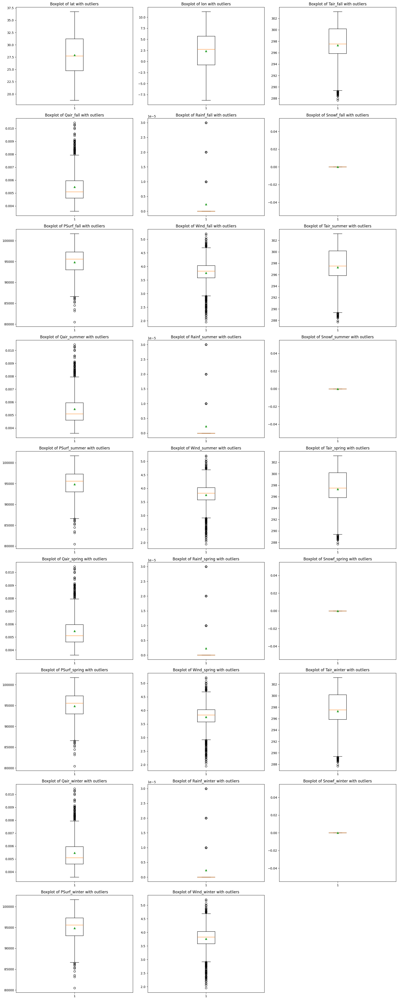

In [ ]:
draw_boxplots(final_climate_data)   

- v. Construct histograms and visualizethe data distribution

In [26]:
def draw_histograms(dataset):
    numeric_cols = dataset.select_dtypes(include=['number']).columns # que les colonnes numériques
    data_cols = len(numeric_cols)  
    cols_per_row = 3 
    rows = math.ceil(data_cols / cols_per_row)  

    fig, axes = plt.subplots(rows, cols_per_row, figsize=(15, 5 * rows))
    axes = axes.flatten()

    # Tracer les histogrammes pour les colonnes numériques
    for i, attribut in enumerate(numeric_cols):
        ax = axes[i]
        liste = dataset[attribut].dropna()
        # Tracer l'histogramme
        ax.hist(liste, color='blue', alpha=0.6, edgecolor='black')
        ax.set_title('Histogram of ' + attribut)
        
        # Calcul du coefficient d'asymétrie
        asymetrie = skew(liste)
        ax.text(0.35, 0.98, f"Asymmetry: {asymetrie:.2f}",
                transform=ax.transAxes, fontsize=10, ha='left', va='top')

    for j in range(data_cols, len(axes)):
        axes[j].axis('off')
        
    plt.tight_layout()
    plt.show()

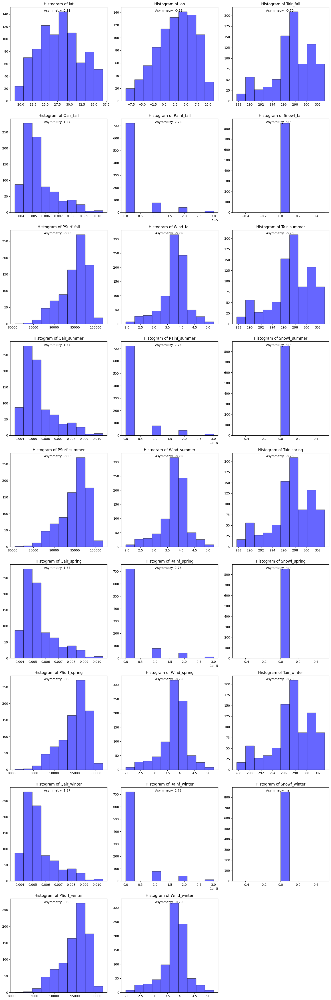

In [27]:
draw_histograms(final_climate_data)

##### b. Construct and display scatter plots of the data and deduce correlations

In [28]:
# scatter plot des attributs numeriques
def is_better_pair(dataset, attribut1, attribut2):
    variance1 = dataset[attribut1].var()
    variance2 = dataset[attribut2].var()
    return variance2 > variance1  # On retourne True si la variance de attribut2 est plus grande

def draw_scatter_plot(dataset):
    pairs = []
    columns_to_exclude = ["lat", "lon", "geometry"]
    for attribut1, attribut2 in itertools.combinations(dataset.columns, 2): # itertools.combinations pour éviter les doublons dans les paires
        if (attribut1 and attribut2) not in columns_to_exclude:
            if pd.api.types.is_numeric_dtype(dataset[attribut1]) and pd.api.types.is_numeric_dtype(dataset[attribut2]):
                if is_better_pair(dataset, attribut2, attribut1): 
                    pairs.append([attribut2, attribut1]) # on met l'attribut qui a la plus grande varience dans l'axe X
                else:
                    pairs.append([attribut1, attribut2])


    data_cols = len(pairs) 
    cols_per_row = 3 
    rows = math.ceil(data_cols / cols_per_row)  

    fig, axes = plt.subplots(rows, cols_per_row, figsize=(17, 6 * rows))
    axes = axes.flatten()

    for i, (attribut1, attribut2) in enumerate(pairs):
        ax = axes[i]
        # Utiliser une liste de colonnes pour accéder à plusieurs colonnes
        filtred_data = dataset[[attribut1,attribut2]].dropna() # supprimer les valeurs nulles sémultanement avoir garder la meme taille des 2 attributs
        liste1 = filtred_data[attribut1]
        liste2 = filtred_data[attribut2]
        ax.scatter(liste1,liste2)
        
        # Vérifier si toutes les valeurs de liste1 sont identiques
        if len(liste1.unique()) > 1 and len(liste2.unique()) > 1:
            # Calculer la droite de régression uniquement si x n'a pas des valeurs identiques
            slope, intercept, rvalue, pvalue, stderr = stats.linregress(liste1, liste2)
            # Tracer la droite de régression
            ax.plot(liste1, slope * liste1 + intercept, color='red', label='Regression line')
            ax.annotate(f'y = {slope:.2f}x + {intercept:.2f}', 
                        xy=(0.05, 0.95), xycoords='axes fraction', 
                        fontsize=10, color='red', 
                        horizontalalignment='left', verticalalignment='top')

        ax.set_xlabel(attribut1)
        ax.set_ylabel(attribut2)
        ax.set_title(f'Scatter plot: {attribut1} vs {attribut2}')

    for j in range(data_cols, len(axes)):
        axes[j].axis('off')

    plt.show()
# il est préférable d'éliminer les outliers pour pouvoir vérifier la corrélation

In [29]:
draw_scatter_plot(final_climate_data)

## **For Algeria Soil Data**

##### a. For each attribute:

- i. Calculate measures of central tendency and deduce symmetries

In [30]:
for attribut in soil_algeria.columns: 
    attribute_central_tendency(soil_algeria, attribut)

sand % topsoil :
la moyenne :  32.92199322033896
la mediane :  36.09
le mode :  [0.0]
sand % topsoil est asymétrique
sand % subsoil :
la moyenne :  32.022857627118626
la mediane :  36.93
le mode :  [0.0]
sand % subsoil est asymétrique
silt % topsoil :
la moyenne :  18.050938983050838
la mediane :  18.74
le mode :  [0.0]
silt % topsoil est asymétrique
silt% subsoil :
la moyenne :  17.96010169491525
la mediane :  19.1
le mode :  [0.0]
silt% subsoil est asymétrique
clay % topsoil :
la moyenne :  18.21622372881357
la mediane :  22.76
le mode :  [0.0]
clay % topsoil est asymétrique
clay % subsoil :
la moyenne :  19.101999999999993
la mediane :  22.36
le mode :  [0.0]
clay % subsoil est asymétrique
pH water topsoil :
la moyenne :  5.246006779661019
la mediane :  7.3
le mode :  [0.0]
pH water topsoil est asymétrique
pH water subsoil :
la moyenne :  5.332427118644073
la mediane :  7.46
le mode :  [0.0]
pH water subsoil est asymétrique
OC % topsoil :
la moyenne :  0.4386132203389832
la mediane 

- ii. Calculate measures of dispersion and deduce outliers

In [31]:
for attribut in soil_algeria.columns:
    attribute_quartiles(soil_algeria, attribut)


sand % topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 36.09, Q3: 50.56, Q4: 96.0
Pas d'outliers

sand % subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 36.93, Q3: 46.55, Q4: 94.7
Pas d'outliers

silt % topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 18.74, Q3: 26.22, Q4: 54.0
Pas d'outliers

silt% subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 19.1, Q3: 27.9, Q4: 50.73
Pas d'outliers

clay % topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 22.76, Q3: 25.2, Q4: 60.6
Pas d'outliers

clay % subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 22.36, Q3: 27.24, Q4: 63.57
Pas d'outliers

pH water topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 7.3, Q3: 7.7, Q4: 9.63
Pas d'outliers

pH water subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 7.46, Q3: 7.8, Q4: 9.7
Pas d'outliers

OC % topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 0.4475, Q3: 0.6779999999999999, Q4: 2.411
les outliers : [2.411]

OC % subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 0.289, Q3: 0.4, Q4: 0.742
Pas d'outliers

N % topsoil: 	Q0: 0.0, Q1: 0.0, Q2: 0.065, Q3: 0.104, Q4: 0.29
les outliers : [0.29]

N % subsoil: 	Q0: 0.0, Q1: 0.0, Q2: 0.034, Q3: 0.0579999999999999, Q4: 0.7535
les

- iii. Calculate the amount of missing values and unique values

In [32]:
for attribut in soil_algeria.columns:
    Count_unique_NaN_values(soil_algeria, attribut)

sand % topsoil : 97 valeurs uniques; 0 valeurs nulles --> 0.00%
sand % subsoil : 96 valeurs uniques; 0 valeurs nulles --> 0.00%
silt % topsoil : 98 valeurs uniques; 0 valeurs nulles --> 0.00%
silt% subsoil : 98 valeurs uniques; 0 valeurs nulles --> 0.00%
clay % topsoil : 95 valeurs uniques; 0 valeurs nulles --> 0.00%
clay % subsoil : 94 valeurs uniques; 0 valeurs nulles --> 0.00%
pH water topsoil : 79 valeurs uniques; 0 valeurs nulles --> 0.00%
pH water subsoil : 84 valeurs uniques; 0 valeurs nulles --> 0.00%
OC % topsoil : 96 valeurs uniques; 0 valeurs nulles --> 0.00%
OC % subsoil : 87 valeurs uniques; 0 valeurs nulles --> 0.00%
N % topsoil : 77 valeurs uniques; 0 valeurs nulles --> 0.00%
N % subsoil : 53 valeurs uniques; 0 valeurs nulles --> 0.00%
BS % topsoil : 77 valeurs uniques; 0 valeurs nulles --> 0.00%
BS % subsoil : 70 valeurs uniques; 0 valeurs nulles --> 0.00%
CEC topsoil : 96 valeurs uniques; 0 valeurs nulles --> 0.00%
CEC subsoil : 93 valeurs uniques; 0 valeurs nulles -->

- iv. Construct boxplots and display outliers

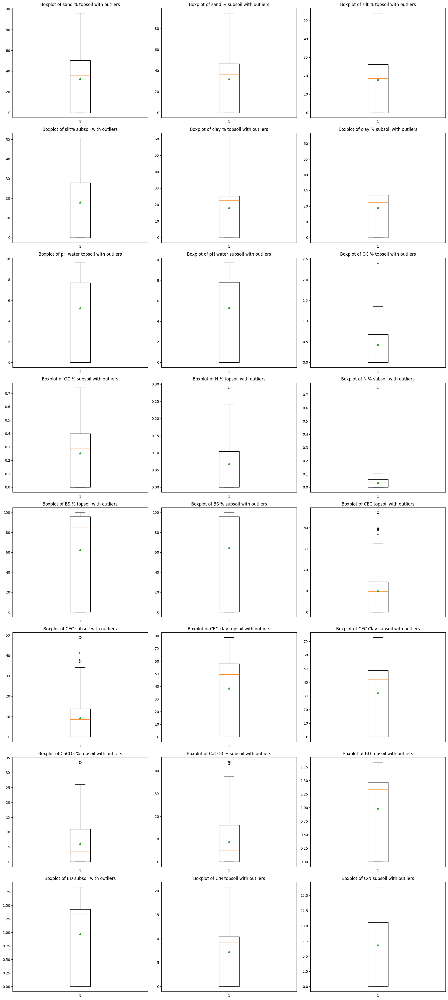

In [33]:
draw_boxplots(soil_algeria)

- v. Construct histograms and visualizethe data distribution

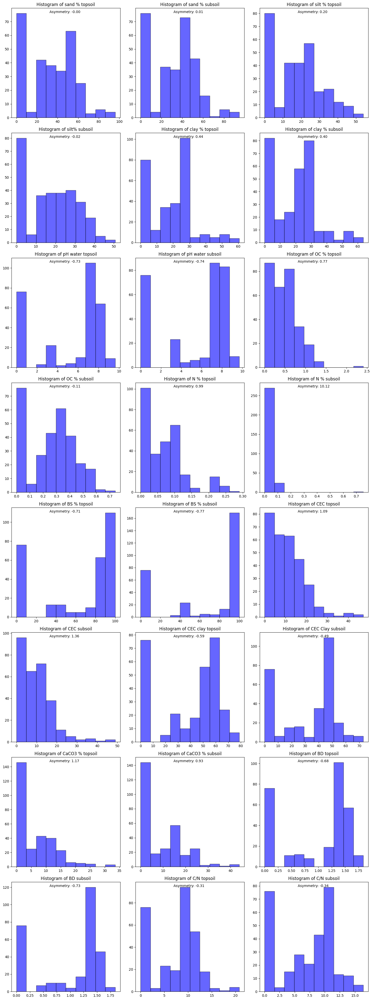

In [34]:
draw_histograms(soil_algeria)

##### b. Construct and display scatter plots of the data and deduce correlations

In [35]:
draw_scatter_plot(soil_algeria)

# Preprocessing of the Two Datasets:
##### We will apply the same preprocessing steps to both datasets:

- 1. Handling missing values and outliers.
- 2. Aggregating climate data by season.
- 3. Merging both cleaned datasets into one coherent dataset.
- 4. Eliminating redundancies: both horizontal (duplicate columns) and vertical (duplicate rows).
- 5. Discretizing data using Equal Frequency and Equal Width methods.
- 6. Normalizing data using Min-Max and z-score methods.

# F. Multiple choices of handling outliers and missing values

- Replacing NaN values with the `mean` of the attribute :

In [36]:
def treat_nan_mean(dataset):
    cleaned_dataset = dataset.copy()

    for column in cleaned_dataset.select_dtypes(include=['float64', 'int64']).columns:
        # Drop NaN values and calculate the mean
        vals = cleaned_dataset[column].dropna()
        mean = sum(vals) / len(vals)
        
        # Replace NaN values with the mean
        cleaned_dataset[column] = cleaned_dataset[column].apply(lambda x: mean if pd.isna(x) else x)
    
    return cleaned_dataset

In [37]:
algeria_climate_NAN_mean = treat_nan_mean(algeria_climate_csv)
algeria_climate_NAN_mean.head()

,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair,season
time,,,,,,,,,
2019-01-01,18.75,3.25,0.0,3.95247,290.51390,97173.320,0.0,0.00278,winter
2019-01-01,19.25,3.25,0.0,3.63723,289.51474,96483.320,0.0,0.00284,winter
2019-01-01,19.25,3.75,0.0,3.53413,289.55704,97020.234,0.0,0.00280,winter
2019-01-01,19.25,4.25,0.0,3.62010,289.35562,96880.740,0.0,0.00294,winter
2019-01-01,19.25,4.75,0.0,3.93457,289.17150,96704.730,0.0,0.00304,winter


In [38]:
algeria_climate_NAN_mean.to_csv("./results/algeria_climate_NAN_mean.csv", index=False)
print("algeria_climate_NAN_mean.csv is successfully created")

algeria_climate_NAN_mean.csv is successfully created


In [39]:
soil_algeria_NAN_mean = treat_nan_mean(soil_algeria)
soil_algeria_NAN_mean.head()

,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil,geometry
0,49.57,43.09,28.200,24.200,22.230,32.710,5.86,5.39,2.4110,0.7420,...,12.420,21.50,35.8,0.030,0.090,1.78,1.78,20.8,12.1,"POLYGON ((5.488269805908203 36.69034957885742,..."
1,56.97,55.06,21.440,19.190,21.690,25.680,5.92,6.02,1.0460,0.5500,...,17.380,66.50,61.4,0.760,0.830,1.19,1.32,9.7,8.0,"POLYGON ((7.277111053466797 37.02900695800781,..."
2,57.39,55.21,24.315,22.825,18.295,21.965,6.27,5.75,1.2295,0.3905,...,8.325,20.45,26.1,0.035,0.035,1.69,1.69,18.7,13.0,POLYGON ((7.367879867553711 36.955509185791016...
3,20.41,24.08,32.930,29.190,46.620,46.690,7.86,8.03,0.6790,0.3820,...,37.910,74.20,71.0,6.330,6.770,1.54,1.58,9.3,9.6,"POLYGON ((7.681180000305176 36.97943878173828,..."
4,31.42,28.46,21.650,20.520,46.890,50.950,7.32,7.49,0.6190,0.4240,...,36.980,72.10,69.8,1.950,2.720,1.54,1.67,9.0,8.7,"POLYGON ((8.664039611816406 36.89445877075195,..."


In [40]:
soil_algeria_NAN_mean.to_csv("./results/soil_algeria_NAN_mean.csv", index=False)
print("soil_algeria_NAN_mean.csv is successfully created")

soil_algeria_NAN_mean.csv is successfully created


- Replacing NaN values with the `median` of the attribute :

In [41]:
def treat_nan_median(dataset):
    cleaned_dataset = dataset.copy()

    for column in cleaned_dataset.select_dtypes(include=['float64', 'int64']).columns:
        # Drop NaN values and calculate the median
        vals = cleaned_dataset[column].dropna()
        median = vals.median()

        # Replace NaN values with the median
        cleaned_dataset[column] = cleaned_dataset[column].apply(lambda x: median if pd.isna(x) else x)
    
    return cleaned_dataset

In [42]:
algeria_climate_NAN_median = treat_nan_median(algeria_climate_csv)
algeria_climate_NAN_median.head()

,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair,season
time,,,,,,,,,
2019-01-01,18.75,3.25,0.0,3.95247,290.51390,97173.320,0.0,0.00278,winter
2019-01-01,19.25,3.25,0.0,3.63723,289.51474,96483.320,0.0,0.00284,winter
2019-01-01,19.25,3.75,0.0,3.53413,289.55704,97020.234,0.0,0.00280,winter
2019-01-01,19.25,4.25,0.0,3.62010,289.35562,96880.740,0.0,0.00294,winter
2019-01-01,19.25,4.75,0.0,3.93457,289.17150,96704.730,0.0,0.00304,winter


In [43]:
soil_algeria_NAN_median = treat_nan_median(soil_algeria)
soil_algeria_NAN_median.head()

,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil,geometry
0,49.57,43.09,28.200,24.200,22.230,32.710,5.86,5.39,2.4110,0.7420,...,12.420,21.50,35.8,0.030,0.090,1.78,1.78,20.8,12.1,"POLYGON ((5.488269805908203 36.69034957885742,..."
1,56.97,55.06,21.440,19.190,21.690,25.680,5.92,6.02,1.0460,0.5500,...,17.380,66.50,61.4,0.760,0.830,1.19,1.32,9.7,8.0,"POLYGON ((7.277111053466797 37.02900695800781,..."
2,57.39,55.21,24.315,22.825,18.295,21.965,6.27,5.75,1.2295,0.3905,...,8.325,20.45,26.1,0.035,0.035,1.69,1.69,18.7,13.0,POLYGON ((7.367879867553711 36.955509185791016...
3,20.41,24.08,32.930,29.190,46.620,46.690,7.86,8.03,0.6790,0.3820,...,37.910,74.20,71.0,6.330,6.770,1.54,1.58,9.3,9.6,"POLYGON ((7.681180000305176 36.97943878173828,..."
4,31.42,28.46,21.650,20.520,46.890,50.950,7.32,7.49,0.6190,0.4240,...,36.980,72.10,69.8,1.950,2.720,1.54,1.67,9.0,8.7,"POLYGON ((8.664039611816406 36.89445877075195,..."


- **Deleting the outliers**

In [44]:
def treat_outliers(dataset):
    # Define a new dataset to avoid modifying the original one
    cleaned_dataset = dataset.copy()

    for column in cleaned_dataset.select_dtypes(include=['float64', 'int64']).columns:
        # Calculate the Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = cleaned_dataset[column].quantile(0.25)
        Q3 = cleaned_dataset[column].quantile(0.75)
        
        # Calculate the Interquartile Range (IQR)
        IQR = Q3 - Q1
        
        # Define lower and upper bounds for acceptable values
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        cleaned_dataset[column] = cleaned_dataset[column].apply(
            lambda x: x if lower_bound <= x <= upper_bound else None
        )
    
    # Optionally, you can drop rows with NaN values (after outlier treatment)
    cleaned_dataset = cleaned_dataset.dropna()
    
    return cleaned_dataset

In [45]:
algeria_climate_WT_outliers = treat_outliers(algeria_climate_NAN_mean)
algeria_climate_WT_outliers

,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair,season
time,,,,,,,,,
2019-01-01 00:00:00,18.75,3.25,0.0,3.95247,290.51390,97173.320,0.0,0.00278,winter
2019-01-01 00:00:00,19.25,3.25,0.0,3.63723,289.51474,96483.320,0.0,0.00284,winter
2019-01-01 00:00:00,19.25,3.75,0.0,3.53413,289.55704,97020.234,0.0,0.00280,winter
2019-01-01 00:00:00,19.25,4.25,0.0,3.62010,289.35562,96880.740,0.0,0.00294,winter
2019-01-01 00:00:00,19.25,4.75,0.0,3.93457,289.17150,96704.730,0.0,0.00304,winter
...,...,...,...,...,...,...,...,...,...
2019-12-31 23:00:00,36.25,6.75,0.0,0.65126,272.13004,93626.840,0.0,0.00334,winter
2019-12-31 23:00:00,36.25,7.25,0.0,1.05002,271.71640,94018.250,0.0,0.00344,winter
2019-12-31 23:00:00,36.25,7.75,0.0,1.25899,271.88080,94437.230,0.0,0.00352,winter


In [46]:
soil_algeria_WT_outliers = treat_outliers(soil_algeria_NAN_mean)
soil_algeria_WT_outliers

,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil,geometry
1,56.970,55.060,21.440,19.190,21.690,25.680,5.920,6.020,1.0460,0.5500,...,17.380,66.50,61.4,0.760,0.830,1.190,1.320,9.7,8.00,"POLYGON ((7.277111053466797 37.02900695800781,..."
2,57.390,55.210,24.315,22.825,18.295,21.965,6.270,5.750,1.2295,0.3905,...,8.325,20.45,26.1,0.035,0.035,1.690,1.690,18.7,13.00,POLYGON ((7.367879867553711 36.955509185791016...
6,55.900,54.180,20.240,19.380,23.880,26.440,6.940,7.280,0.6900,0.3060,...,12.140,47.60,42.8,2.020,5.100,1.420,1.500,10.8,8.40,POLYGON ((3.6944100856781006 36.84677124023437...
7,50.220,52.710,16.150,16.820,33.720,30.470,6.820,7.200,0.9640,0.4530,...,14.190,42.60,42.3,4.900,12.140,1.260,1.360,10.1,6.40,"POLYGON ((7.07436990737915 36.92129135131836, ..."
10,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0000,0.0000,...,0.000,0.00,0.0,0.000,0.000,0.000,0.000,0.0,0.00,"POLYGON ((8.425950050354004 36.83320999145508,..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290,32.208,32.934,17.523,18.216,16.335,14.817,4.620,4.719,0.5907,0.4752,...,6.468,34.98,23.1,1.320,0.693,0.726,0.792,6.6,4.95,POLYGON ((3.2276499271392822 19.95354080200195...
291,49.200,42.400,26.000,27.900,24.800,29.300,7.700,7.800,0.3300,0.2300,...,7.900,66.00,50.0,13.100,22.100,1.500,1.400,8.0,11.00,"POLYGON ((5.541150093078613 19.48434066772461,..."
292,23.305,20.080,13.000,13.860,13.695,15.880,3.835,3.880,0.2035,0.1300,...,5.610,33.75,26.2,6.060,10.280,0.760,0.720,5.0,5.25,"POLYGON ((5.961190223693848 19.71068000793457,..."
293,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0000,0.0000,...,0.000,0.00,0.0,0.000,0.000,0.000,0.000,0.0,0.00,POLYGON ((4.107329845428467 19.135799407958984...


- **Replacing the outliers with the `max` or `min` values**

In [47]:
def treat_outliers_with_bounds(dataset):
    # Define a new dataset to avoid modifying the original one
    cleaned_dataset = dataset.copy()

    for column in cleaned_dataset.select_dtypes(include=['float64', 'int64']).columns:
        # Calculate the Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = cleaned_dataset[column].quantile(0.25)
        Q3 = cleaned_dataset[column].quantile(0.75)
        
        # Calculate the Interquartile Range (IQR)
        IQR = Q3 - Q1
        
        # Define lower and upper bounds for acceptable values
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        # Replace outliers with the corresponding lower/upper bound
        cleaned_dataset[column] = cleaned_dataset[column].apply(
            lambda x: lower_bound if x < lower_bound else (upper_bound if x > upper_bound else x)
        )
    
    return cleaned_dataset

In [48]:
algeria_climate_MM_outliers = treat_outliers_with_bounds(algeria_climate_NAN_mean)
algeria_climate_MM_outliers

,lat,lon,Snowf,Wind,Tair,PSurf,Rainf,Qair,season
time,,,,,,,,,
2019-01-01 00:00:00,18.75,3.25,0.0,3.95247,290.51390,97173.320,0.0,0.00278,winter
2019-01-01 00:00:00,19.25,3.25,0.0,3.63723,289.51474,96483.320,0.0,0.00284,winter
2019-01-01 00:00:00,19.25,3.75,0.0,3.53413,289.55704,97020.234,0.0,0.00280,winter
2019-01-01 00:00:00,19.25,4.25,0.0,3.62010,289.35562,96880.740,0.0,0.00294,winter
2019-01-01 00:00:00,19.25,4.75,0.0,3.93457,289.17150,96704.730,0.0,0.00304,winter
...,...,...,...,...,...,...,...,...,...
2019-12-31 23:00:00,36.25,6.75,0.0,0.65126,272.13004,93626.840,0.0,0.00334,winter
2019-12-31 23:00:00,36.25,7.25,0.0,1.05002,271.71640,94018.250,0.0,0.00344,winter
2019-12-31 23:00:00,36.25,7.75,0.0,1.25899,271.88080,94437.230,0.0,0.00352,winter


In [49]:
algeria_climate_MM_outliers.to_csv("./results/algeria_climate_MM_outliers.csv", index=False)
print("algeria_climate_MM_outliers.csv is successfully created")

algeria_climate_MM_outliers.csv is successfully created


In [50]:
soil_algeria_MM_outliers = treat_outliers_with_bounds(soil_algeria_NAN_mean)
soil_algeria_MM_outliers

,sand % topsoil,sand % subsoil,silt % topsoil,silt% subsoil,clay % topsoil,clay % subsoil,pH water topsoil,pH water subsoil,OC % topsoil,OC % subsoil,...,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil,geometry
0,49.570,43.090,28.200,24.200,22.230,32.710,5.860,5.390,1.6950,0.7420,...,12.420,21.50,35.8,0.030,0.090,1.780,1.780,20.8,12.10,"POLYGON ((5.488269805908203 36.69034957885742,..."
1,56.970,55.060,21.440,19.190,21.690,25.680,5.920,6.020,1.0460,0.5500,...,17.380,66.50,61.4,0.760,0.830,1.190,1.320,9.7,8.00,"POLYGON ((7.277111053466797 37.02900695800781,..."
2,57.390,55.210,24.315,22.825,18.295,21.965,6.270,5.750,1.2295,0.3905,...,8.325,20.45,26.1,0.035,0.035,1.690,1.690,18.7,13.00,POLYGON ((7.367879867553711 36.955509185791016...
3,20.410,24.080,32.930,29.190,46.620,46.690,7.860,8.030,0.6790,0.3820,...,34.675,74.20,71.0,6.330,6.770,1.540,1.580,9.3,9.60,"POLYGON ((7.681180000305176 36.97943878173828,..."
4,31.420,28.460,21.650,20.520,46.890,50.950,7.320,7.490,0.6190,0.4240,...,34.675,72.10,69.8,1.950,2.720,1.540,1.670,9.0,8.70,"POLYGON ((8.664039611816406 36.89445877075195,..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290,32.208,32.934,17.523,18.216,16.335,14.817,4.620,4.719,0.5907,0.4752,...,6.468,34.98,23.1,1.320,0.693,0.726,0.792,6.6,4.95,POLYGON ((3.2276499271392822 19.95354080200195...
291,49.200,42.400,26.000,27.900,24.800,29.300,7.700,7.800,0.3300,0.2300,...,7.900,66.00,50.0,13.100,22.100,1.500,1.400,8.0,11.00,"POLYGON ((5.541150093078613 19.48434066772461,..."
292,23.305,20.080,13.000,13.860,13.695,15.880,3.835,3.880,0.2035,0.1300,...,5.610,33.75,26.2,6.060,10.280,0.760,0.720,5.0,5.25,"POLYGON ((5.961190223693848 19.71068000793457,..."
293,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0000,0.0000,...,0.000,0.00,0.0,0.000,0.000,0.000,0.000,0.0,0.00,POLYGON ((4.107329845428467 19.135799407958984...


In [51]:
soil_algeria_MM_outliers.to_csv("./results/soil_algeria_MM_outliers.csv", index=False)
print("soil_algeria_MM_outliers.csv is successfully created")

soil_algeria_MM_outliers.csv is successfully created


# G. Data reduction through aggregation by season

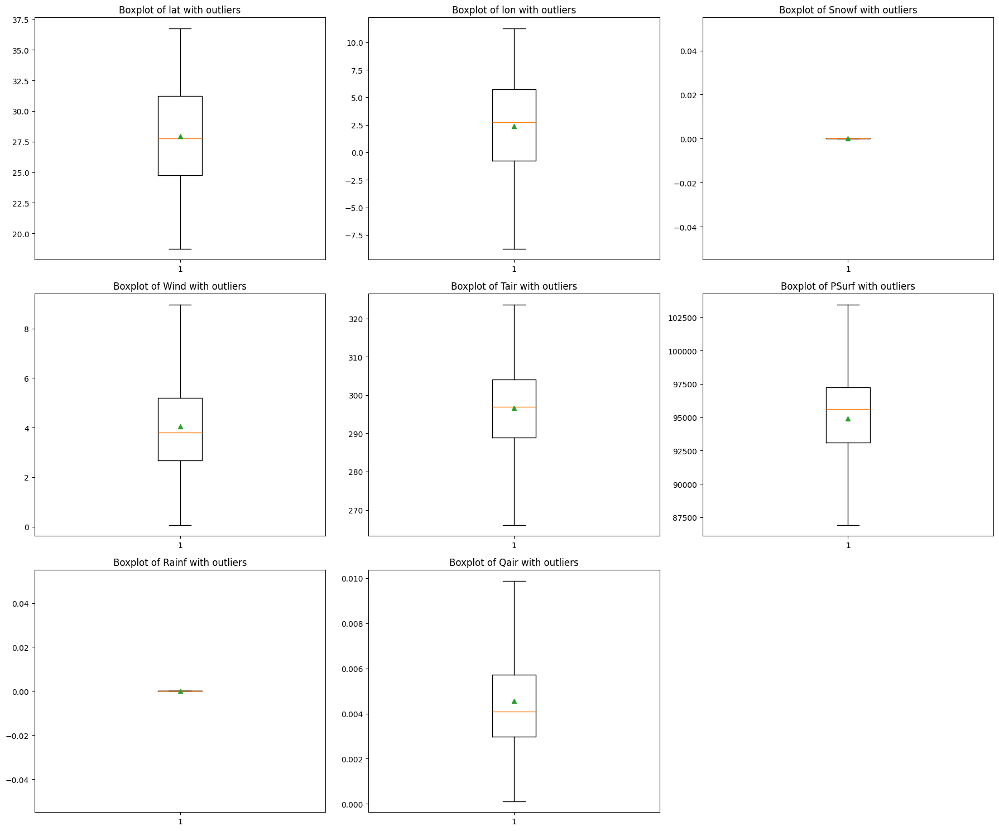

In [52]:
draw_boxplots(algeria_climate_MM_outliers) # chacking if there is no outliers 

In [53]:
fall_data_cleaned = algeria_climate_MM_outliers[algeria_climate_MM_outliers['season'] == "fall"]
spring_data_cleaned = algeria_climate_MM_outliers[algeria_climate_MM_outliers['season'] == "spring"]
summer_data_cleaned = algeria_climate_MM_outliers[algeria_climate_MM_outliers['season'] == "summer"]
winter_data_cleaned = algeria_climate_MM_outliers[algeria_climate_MM_outliers['season'] == "winter"]

In [54]:
fall_data_cleaned = fall_data_cleaned.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

winter_data_cleaned = fall_data_cleaned.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

summer_data_cleaned = fall_data_cleaned.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

spring_data_cleaned = fall_data_cleaned.groupby(['lat', 'lon']).agg({
    'Tair': 'mean',
    'Qair': 'mean',
    'Rainf': 'mean',
    'Snowf': 'mean',
    'PSurf': 'mean',
    'Wind': 'mean',
}).reset_index()

fall_data_cleaned[columns_to_round] = fall_data_cleaned[columns_to_round].round(5)
spring_data_cleaned[columns_to_round] = spring_data_cleaned[columns_to_round].round(5)
summer_data_cleaned[columns_to_round] = summer_data_cleaned[columns_to_round].round(5)
winter_data_cleaned[columns_to_round] = winter_data_cleaned[columns_to_round].round(5)

len(fall_data_cleaned) + len(spring_data_cleaned) + len(summer_data_cleaned) + len(winter_data_cleaned) # (37 * 41) = 1517 * 4 = 6068 with NAN values

3412

In [55]:
# Now, merge the datasets with suffixes for each season
aggregated_climate_data = fall_data_cleaned.merge(summer_data_cleaned, on=['lat', 'lon'], suffixes=('_fall', '_summer'))
aggregated_climate_data = aggregated_climate_data.merge(spring_data_cleaned, on=['lat', 'lon'], suffixes=('_summer', '_spring'))
aggregated_climate_data = aggregated_climate_data.merge(winter_data_cleaned, on=['lat', 'lon'], suffixes=('_spring', '_winter'))

# Display the merged dataframe columns
print(aggregated_climate_data.shape)
aggregated_climate_data

(853, 26)


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,Tair_summer,Qair_summer,...,Rainf_spring,Snowf_spring,PSurf_spring,Wind_spring,Tair_winter,Qair_winter,Rainf_winter,Snowf_winter,PSurf_winter,Wind_winter
0,18.75,3.25,303.05441,0.00523,0.0,0.0,96260.60873,3.62776,303.05441,0.00523,...,0.0,0.0,96260.60873,3.62776,303.05441,0.00523,0.0,0.0,96260.60873,3.62776
1,19.25,3.25,302.48736,0.00495,0.0,0.0,95590.48267,3.67052,302.48736,0.00495,...,0.0,0.0,95590.48267,3.67052,302.48736,0.00495,0.0,0.0,95590.48267,3.67052
2,19.25,3.75,302.48736,0.00484,0.0,0.0,96110.34701,3.68156,302.48736,0.00484,...,0.0,0.0,96110.34701,3.68156,302.48736,0.00484,0.0,0.0,96110.34701,3.68156
3,19.25,4.25,302.52142,0.00481,0.0,0.0,95987.59770,3.73608,302.52142,0.00481,...,0.0,0.0,95987.59770,3.73608,302.52142,0.00481,0.0,0.0,95987.59770,3.73608
4,19.25,4.75,302.52033,0.00481,0.0,0.0,95832.66874,3.77842,302.52033,0.00481,...,0.0,0.0,95832.66874,3.77842,302.52033,0.00481,0.0,0.0,95832.66874,3.77842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
848,36.25,6.75,289.58847,0.00824,0.0,0.0,92382.59499,2.28784,289.58847,0.00824,...,0.0,0.0,92382.59499,2.28784,289.58847,0.00824,0.0,0.0,92382.59499,2.28784
849,36.25,7.25,289.55549,0.00822,0.0,0.0,92758.74697,2.36188,289.55549,0.00822,...,0.0,0.0,92758.74697,2.36188,289.55549,0.00822,0.0,0.0,92758.74697,2.36188
850,36.25,7.75,289.65548,0.00820,0.0,0.0,93165.80160,2.28967,289.65548,0.00820,...,0.0,0.0,93165.80160,2.28967,289.65548,0.00820,0.0,0.0,93165.80160,2.28967
851,36.75,6.25,289.88956,0.00849,0.0,0.0,96674.21271,2.34201,289.88956,0.00849,...,0.0,0.0,96674.21271,2.34201,289.88956,0.00849,0.0,0.0,96674.21271,2.34201


In [56]:
aggregated_climate_data.to_csv("./results/aggregated_climate_data.csv", index=False)
print("aggregated_climate_data.csv is successfully created")

aggregated_climate_data.csv is successfully created


# H. Data integration : merges data from multiple sources in to a single coherent dataset after preprocessing

In [ ]:
gdf1 = gpd.GeoDataFrame(aggregated_climate_data, 
                        geometry=gpd.GeoSeries.from_xy(aggregated_climate_data['lon'], aggregated_climate_data['lat']), 
                        crs="EPSG:4326")

gdf2 = gpd.GeoDataFrame(soil_algeria_MM_outliers, geometry=gpd.GeoSeries.from_wkt(soil_algeria_MM_outliers['geometry']), crs="EPSG:4326")

cleaned_data = gpd.sjoin(gdf1, gdf2, how="inner")
if 'index_right' in cleaned_data.columns:
    cleaned_data = cleaned_data.drop(columns=['index_right'])
cleaned_data = cleaned_data.reset_index(drop=True)
cleaned_data.to_csv("./results/cleaned_data.csv", index=False)
print("cleaned_data.csv is successfully created")
cleaned_data # (821, 51) before preprocessing (821, 33) after preprocessing on a eliminer 6 * 3 saisons

cleaned_data.csv is successfully created


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,Tair_summer,Qair_summer,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,302.48736,0.00495,0.0,0.0,95590.48267,3.67052,302.48736,0.00495,...,0.00,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0
1,19.25,3.75,302.48736,0.00484,0.0,0.0,96110.34701,3.68156,302.48736,0.00484,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
2,19.25,4.25,302.52142,0.00481,0.0,0.0,95987.59770,3.73608,302.52142,0.00481,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
3,19.75,3.25,301.85328,0.00462,0.0,0.0,94724.31897,3.79451,301.85328,0.00462,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
4,19.75,3.75,301.95332,0.00455,0.0,0.0,95318.69812,3.78663,301.95332,0.00455,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,289.58847,0.00824,0.0,0.0,92382.59499,2.28784,289.58847,0.00824,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
817,36.25,7.25,289.55549,0.00822,0.0,0.0,92758.74697,2.36188,289.55549,0.00822,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
818,36.25,7.75,289.65548,0.00820,0.0,0.0,93165.80160,2.28967,289.65548,0.00820,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
819,36.75,6.25,289.88956,0.00849,0.0,0.0,96674.21271,2.34201,289.88956,0.00849,...,6.89,12.42,21.5,35.8,0.03,0.09,1.78,1.78,20.8,12.1


# I. Data reduction (elimination of redundancies)

- **Horizontal** 

In [58]:
def eliminate_redundancies_H(dataset):
    
    cleaned_dataset = dataset.loc[~(dataset.isna().all(axis=1) | (dataset == 0).all(axis=1)), :] # ne pas garder les lignes ou toutes les valeurs NAN ou 0
    cleaned_dataset = cleaned_dataset.drop_duplicates() # suppression des lignes redondantes

    print(f"dataset : {len(dataset)}, cleaned dataset : {len(cleaned_dataset)}")
    return cleaned_dataset

In [59]:
reduced_cleaned_data_H = eliminate_redundancies_H(cleaned_data)
reduced_cleaned_data_H

dataset : 821, cleaned dataset : 821


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,Tair_summer,Qair_summer,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,302.48736,0.00495,0.0,0.0,95590.48267,3.67052,302.48736,0.00495,...,0.00,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0
1,19.25,3.75,302.48736,0.00484,0.0,0.0,96110.34701,3.68156,302.48736,0.00484,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
2,19.25,4.25,302.52142,0.00481,0.0,0.0,95987.59770,3.73608,302.52142,0.00481,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
3,19.75,3.25,301.85328,0.00462,0.0,0.0,94724.31897,3.79451,301.85328,0.00462,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
4,19.75,3.75,301.95332,0.00455,0.0,0.0,95318.69812,3.78663,301.95332,0.00455,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,289.58847,0.00824,0.0,0.0,92382.59499,2.28784,289.58847,0.00824,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
817,36.25,7.25,289.55549,0.00822,0.0,0.0,92758.74697,2.36188,289.55549,0.00822,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
818,36.25,7.75,289.65548,0.00820,0.0,0.0,93165.80160,2.28967,289.65548,0.00820,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
819,36.75,6.25,289.88956,0.00849,0.0,0.0,96674.21271,2.34201,289.88956,0.00849,...,6.89,12.42,21.5,35.8,0.03,0.09,1.78,1.78,20.8,12.1


- **Vertical** 

In [60]:
def eliminate_redundancies_V(dataset):
    # cleaned_dataset = dataset.T.drop_duplicates().T  # en 1 seule ligne

    cleaned_dataset = dataset.loc[:, ~(dataset.isna().all())] # suppression de la colonne ou toutes les valeurs sont des NAN
    columns_to_keep = {}

    for col in cleaned_dataset.columns:
        base_name = col.split('_')[0]
        
        if base_name not in columns_to_keep:
            columns_to_keep[base_name] = col # si on n'a pas encore traité la variable, rajouter la premiere variente
        else:
            if cleaned_dataset[col].equals(cleaned_dataset[columns_to_keep[base_name]]):
                continue # skip si cette variente est identique a une autre deja prise
            else:
                columns_to_keep[base_name] = col # sinon garder les 2 

    # print(columns_to_keep)
    # Retain only the necessary columns
    final_columns = list(columns_to_keep.values())
    cleaned_dataset = cleaned_dataset[final_columns]

    print(f"dataset : {len(dataset.columns)}, Cleaned dataset : {len(cleaned_dataset.columns)}")
    return cleaned_dataset

In [61]:
reduced_cleaned_data = eliminate_redundancies_V(reduced_cleaned_data_H)
reduced_cleaned_data # elimination des 3 saisons 51 - 33 = 18 (3*8)

dataset : 51, Cleaned dataset : 33


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,302.48736,0.00495,0.0,0.0,95590.48267,3.67052,POINT (3.25 19.25),0.00,...,0.00,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0
1,19.25,3.75,302.48736,0.00484,0.0,0.0,96110.34701,3.68156,POINT (3.75 19.25),49.20,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
2,19.25,4.25,302.52142,0.00481,0.0,0.0,95987.59770,3.73608,POINT (4.25 19.25),49.20,...,8.70,7.90,66.0,50.0,13.10,22.10,1.50,1.40,8.0,11.0
3,19.75,3.25,301.85328,0.00462,0.0,0.0,94724.31897,3.79451,POINT (3.25 19.75),29.45,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
4,19.75,3.75,301.95332,0.00455,0.0,0.0,95318.69812,3.78663,POINT (3.75 19.75),29.45,...,5.20,4.00,27.5,14.0,0.05,0.25,0.60,0.75,5.5,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,289.58847,0.00824,0.0,0.0,92382.59499,2.28784,POINT (6.75 36.25),50.22,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
817,36.25,7.25,289.55549,0.00822,0.0,0.0,92758.74697,2.36188,POINT (7.25 36.25),50.22,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
818,36.25,7.75,289.65548,0.00820,0.0,0.0,93165.80160,2.28967,POINT (7.75 36.25),50.22,...,14.94,14.19,42.6,42.3,4.90,12.14,1.26,1.36,10.1,6.4
819,36.75,6.25,289.88956,0.00849,0.0,0.0,96674.21271,2.34201,POINT (6.25 36.75),49.57,...,6.89,12.42,21.5,35.8,0.03,0.09,1.78,1.78,20.8,12.1


In [62]:
reduced_cleaned_data.to_csv("./results/reduced_cleaned_data.csv", index=False)
print("reduced_cleaned_data.csv is successfully created")

reduced_cleaned_data.csv is successfully created


# J. Data reduction via discretization of continuous data

### **Amplitude : Equal width**  

In [63]:
def discretize_data_equal_widh(dataset):
    reduced_data = dataset.copy()
    columns_to_exclude = ["lat", "lon", "geometry"]
    for attribut in dataset.columns:
        if pd.api.types.is_numeric_dtype(reduced_data[attribut]) and (attribut not in columns_to_exclude):
            col_min = reduced_data[attribut].min()
            col_max = reduced_data[attribut].max()
            
            # skiper la colonnes si toutes les valeurs sont des 0 ou si le max = min
            if col_min == col_max == 0 or col_min == col_max:
                continue

            # on calcul le nombre d'intervalles avec la formule de Huntsberger K=1+(10/3)*log10(n)
            n = len(reduced_data[attribut])
            k = int(1 + (10 / 3) * np.log10(n))
            # print("K: ", k)

            # on calcule la largeur de chaque intervalle
            # print("min: ", min(reduced_data[attribut]))
            # print("max: ", max(reduced_data[attribut]))
            interval_width = (max(reduced_data[attribut]) - min(reduced_data[attribut])) / k
            # print("interval_width", interval_width)

            # on calcule les bornes de chaque intervalle
            interval_boundaries = np.arange(min(reduced_data[attribut]), max(reduced_data[attribut]) + interval_width, interval_width)
            # interval_boundaries = [min(reduced_data[attribut]) + i * interval_width for i in range (k+1)]
            # print("interval_boundaries", interval_boundaries)
            
            # on affecte chaque valeur à un intervalle
            reduced_data[f"{attribut}_Discretisé"] = pd.cut(reduced_data[attribut], bins=interval_boundaries, include_lowest=True) # on inclut la valeur minimale
            # cut crée un objet de type pandas.category avec des éléments de type pandas.Interval
            reduced_data[attribut] = (reduced_data.groupby(f"{attribut}_Discretisé", observed=False) [attribut].transform('mean')).round(2)

            reduced_data = reduced_data.drop(f"{attribut}_Discretisé", axis=1) # supprimer l'attribut tomporaire

    # print(reduced_data[f"{attribut}_Discretisé"])
    return reduced_data

In [64]:
discretized_cleaned_data = discretize_data_equal_widh(reduced_cleaned_data)
discretized_cleaned_data

,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,301.77,0.00,0.0,0.0,95102.43,3.77,POINT (3.25 19.25),0.00,...,0.02,0.02,0.00,0.00,0.37,0.34,0.00,0.00,0.00,0.00
1,19.25,3.75,301.77,0.00,0.0,0.0,96511.29,3.77,POINT (3.75 19.25),51.20,...,7.72,9.45,64.16,50.25,13.15,22.04,1.52,1.41,7.19,10.46
2,19.25,4.25,301.77,0.00,0.0,0.0,96511.29,3.77,POINT (4.25 19.25),51.20,...,7.72,9.45,64.16,50.25,13.15,22.04,1.52,1.41,7.19,10.46
3,19.75,3.25,301.77,0.00,0.0,0.0,95102.43,3.77,POINT (3.25 19.75),32.87,...,5.87,4.91,26.95,16.68,0.37,0.34,0.64,0.75,5.01,3.82
4,19.75,3.75,301.77,0.00,0.0,0.0,95102.43,3.77,POINT (3.75 19.75),32.87,...,5.87,4.91,26.95,16.68,0.37,0.34,0.64,0.75,5.01,3.82
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,289.89,0.01,0.0,0.0,92165.10,2.46,POINT (6.75 36.25),51.20,...,13.97,15.45,40.31,40.34,4.67,15.16,1.21,1.41,9.26,5.92
817,36.25,7.25,289.89,0.01,0.0,0.0,92165.10,2.46,POINT (7.25 36.25),51.20,...,13.97,15.45,40.31,40.34,4.67,15.16,1.21,1.41,9.26,5.92
818,36.25,7.75,289.89,0.01,0.0,0.0,93616.17,2.46,POINT (7.75 36.25),51.20,...,13.97,15.45,40.31,40.34,4.67,15.16,1.21,1.41,9.26,5.92
819,36.75,6.25,289.89,0.01,0.0,0.0,96511.29,2.46,POINT (6.25 36.75),51.20,...,7.72,11.48,21.77,34.74,0.37,0.34,1.78,1.78,20.25,12.10


### **Equal Frequency**  

In [65]:
def discretize_data_equal_frequency(dataset):
    reduced_data = dataset.copy()
    numeric_columns = reduced_data.select_dtypes(include=[np.number]).columns
    columns_to_exclude = ["lat", "lon", "geometry"]
    
    for attribut in numeric_columns:
        if attribut not in columns_to_exclude:
            col_min = reduced_data[attribut].min()
            col_max = reduced_data[attribut].max()
            
            # skiper la colonnes si toutes les valeurs sont des 0 ou si le max = min
            if col_min == col_max == 0 or col_min == col_max:
                continue

            Q1 = reduced_data[attribut].quantile(0.25)
            Q3 = reduced_data[attribut].quantile(0.75)
            IQR = Q3 - Q1
            # Freedman-Diaconis Rule : Bin Width = 2 * IQR * (N ​** -1/3)
            # on utilise l'écart interquartile (IQR) pour définir la largeur des bin
            bin_width = 2 * IQR * (len(dataset) ** (-1/3)) 
            num_quantiles = int(np.ceil((reduced_data[attribut].max() - reduced_data[attribut].min()) / bin_width)) # num_bins

            # Calculate quantile positions
            quantiles = np.linspace(0, 1, num_quantiles + 1)  # Divide [0, 1] into Q intervals
            quantile_bounds = reduced_data[attribut].quantile(quantiles).unique()  # Get unique quantile values

            # Assign each value to a bin (category)
            reduced_data[attribut] = pd.cut(reduced_data[attribut], bins=quantile_bounds, labels=False, include_lowest=True)
    
    return reduced_data 

In [66]:
discretized_cleaned_data_2 = discretize_data_equal_frequency(reduced_cleaned_data)
discretized_cleaned_data_2

,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,16,7,0.0,0.0,8,10,POINT (3.25 19.25),0,...,0,0,0,0,0,0,0,0,0,0
1,19.25,3.75,16,6,0.0,0.0,9,11,POINT (3.75 19.25),4,...,3,3,4,4,7,7,5,3,2,4
2,19.25,4.25,16,6,0.0,0.0,9,13,POINT (4.25 19.25),4,...,3,3,4,4,7,7,5,3,2,4
3,19.75,3.25,16,4,0.0,0.0,6,15,POINT (3.25 19.75),1,...,0,0,1,0,0,0,1,1,1,0
4,19.75,3.75,16,3,0.0,0.0,7,15,POINT (3.75 19.75),1,...,0,0,1,0,0,0,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,0,17,0.0,0.0,3,0,POINT (6.75 36.25),4,...,8,9,1,3,3,3,2,3,5,1
817,36.25,7.25,0,17,0.0,0.0,3,0,POINT (7.25 36.25),4,...,8,9,1,3,3,3,2,3,5,1
818,36.25,7.75,0,17,0.0,0.0,4,0,POINT (7.75 36.25),4,...,8,9,1,3,3,3,2,3,5,1
819,36.75,6.25,0,17,0.0,0.0,11,0,POINT (6.25 36.75),4,...,3,8,0,2,0,0,5,5,6,5


In [67]:
discretized_cleaned_data_2.to_csv("./results/discretized_cleaned_data.csv", index=False)
print("discretized_cleaned_data.csv is successfully created")

discretized_cleaned_data.csv is successfully created


- Drop redondancies after discretizing the data

In [68]:
test = eliminate_redundancies_H(discretized_cleaned_data_2)
test

dataset : 821, cleaned dataset : 821


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,16,7,0.0,0.0,8,10,POINT (3.25 19.25),0,...,0,0,0,0,0,0,0,0,0,0
1,19.25,3.75,16,6,0.0,0.0,9,11,POINT (3.75 19.25),4,...,3,3,4,4,7,7,5,3,2,4
2,19.25,4.25,16,6,0.0,0.0,9,13,POINT (4.25 19.25),4,...,3,3,4,4,7,7,5,3,2,4
3,19.75,3.25,16,4,0.0,0.0,6,15,POINT (3.25 19.75),1,...,0,0,1,0,0,0,1,1,1,0
4,19.75,3.75,16,3,0.0,0.0,7,15,POINT (3.75 19.75),1,...,0,0,1,0,0,0,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,0,17,0.0,0.0,3,0,POINT (6.75 36.25),4,...,8,9,1,3,3,3,2,3,5,1
817,36.25,7.25,0,17,0.0,0.0,3,0,POINT (7.25 36.25),4,...,8,9,1,3,3,3,2,3,5,1
818,36.25,7.75,0,17,0.0,0.0,4,0,POINT (7.75 36.25),4,...,8,9,1,3,3,3,2,3,5,1
819,36.75,6.25,0,17,0.0,0.0,11,0,POINT (6.25 36.75),4,...,3,8,0,2,0,0,5,5,6,5


# K. Data normalization 

- **Min-Max method**

In [69]:
def normalize_data_min_max(dataset):
    # on normalise les veleurs de l'attribut en utilisant la méthode de Min-Max Normalization :
    # Value(i, new)=  ((𝑉𝑎𝑙𝑢𝑒(𝑖, 𝑜𝑙𝑑) − 𝑉𝑎𝑙𝑢𝑒(𝑚𝑖𝑛, 𝑜𝑙𝑑)) / (𝑉𝑎𝑙𝑢𝑒(𝑚𝑎𝑥, 𝑜𝑙𝑑) − 𝑉𝑎𝑙𝑢𝑒(𝑚𝑖𝑛, 𝑜𝑙𝑑))) * (Value(max, new) - Value(min, new) ) + Value(min, new)
    normalized_data = dataset.copy()
    cols_to_exclude = ['lat', 'lon', 'geometry']
    new_max = 1
    new_min = 0

    for attribut in normalized_data.columns:
        if pd.api.types.is_numeric_dtype(normalized_data[attribut]) and attribut not in cols_to_exclude:
            col_min = normalized_data[attribut].min()
            col_max = normalized_data[attribut].max()
            
            # Skip normalization if the column is entirely 0 or if min and max are equal
            if col_min == col_max == 0 or col_min == col_max:
                continue
            
            normalized_data[attribut] = ((normalized_data[attribut] - col_min) * (new_max - new_min) / (col_max - col_min)) + new_min
            # print(normalized_data[attribut])
    return normalized_data

In [70]:
final_cleaned_data = normalize_data_min_max(discretized_cleaned_data_2)
final_cleaned_data

,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,1.0000,0.411765,0.0,0.0,0.5000,0.303030,POINT (3.25 19.25),0.000000,...,0.000,0.000000,0.00,0.0,0.000,0.000000,0.0,0.0,0.000000,0.0
1,19.25,3.75,1.0000,0.352941,0.0,0.0,0.5625,0.333333,POINT (3.75 19.25),0.666667,...,0.375,0.333333,1.00,0.8,0.875,1.000000,1.0,0.6,0.333333,0.8
2,19.25,4.25,1.0000,0.352941,0.0,0.0,0.5625,0.393939,POINT (4.25 19.25),0.666667,...,0.375,0.333333,1.00,0.8,0.875,1.000000,1.0,0.6,0.333333,0.8
3,19.75,3.25,1.0000,0.235294,0.0,0.0,0.3750,0.454545,POINT (3.25 19.75),0.166667,...,0.000,0.000000,0.25,0.0,0.000,0.000000,0.2,0.2,0.166667,0.0
4,19.75,3.75,1.0000,0.176471,0.0,0.0,0.4375,0.454545,POINT (3.75 19.75),0.166667,...,0.000,0.000000,0.25,0.0,0.000,0.000000,0.2,0.2,0.166667,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,0.0000,1.000000,0.0,0.0,0.1875,0.000000,POINT (6.75 36.25),0.666667,...,1.000,1.000000,0.25,0.6,0.375,0.428571,0.4,0.6,0.833333,0.2
817,36.25,7.25,0.0000,1.000000,0.0,0.0,0.1875,0.000000,POINT (7.25 36.25),0.666667,...,1.000,1.000000,0.25,0.6,0.375,0.428571,0.4,0.6,0.833333,0.2
818,36.25,7.75,0.0000,1.000000,0.0,0.0,0.2500,0.000000,POINT (7.75 36.25),0.666667,...,1.000,1.000000,0.25,0.6,0.375,0.428571,0.4,0.6,0.833333,0.2
819,36.75,6.25,0.0000,1.000000,0.0,0.0,0.6875,0.000000,POINT (6.25 36.75),0.666667,...,0.375,0.888889,0.00,0.4,0.000,0.000000,1.0,1.0,1.000000,1.0


- **Z-score method**

In [ ]:
def normalize_data_z_score(dataset):
    normalized_data = dataset.copy()
    cols_to_exclude = ['lat', 'lon', 'geometry']

    for attribut in normalized_data.columns:
        if pd.api.types.is_numeric_dtype(normalized_data[attribut]) and attribut not in cols_to_exclude:
            col_min = normalized_data[attribut].min()
            col_max = normalized_data[attribut].max()
            
            # Skip normalization if the column is entirely 0 or if min and max are equal
            if col_min == col_max == 0 or col_min == col_max:
                continue
            
            normalized_data[attribut] = (normalized_data[attribut] - normalized_data[attribut].mean()) / dataset[attribut].std()
            # print(normalized_data[attribut])
    return normalized_data

In [72]:
final_cleaned_data_2 = normalize_data_z_score(discretized_cleaned_data_2)
final_cleaned_data_2

,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,1.631047,-0.282020,0.0,0.0,0.000000,-0.661206,POINT (3.25 19.25),-1.031911,...,-1.106221,-1.113875,-1.080747,-1.179724,-1.129365,-1.117380,-1.058486,-1.105979,-1.060721,-0.999281
1,19.25,3.75,1.631047,-0.474010,0.0,0.0,0.203793,-0.559473,POINT (3.75 19.25),0.810827,...,-0.036903,-0.118059,1.601924,1.276974,1.420914,1.784374,1.759339,0.632391,-0.160616,1.276474
2,19.25,4.25,1.631047,-0.474010,0.0,0.0,0.203793,-0.356005,POINT (4.25 19.25),0.810827,...,-0.036903,-0.118059,1.601924,1.276974,1.420914,1.784374,1.759339,0.632391,-0.160616,1.276474
3,19.75,3.25,1.631047,-0.857988,0.0,0.0,-0.407586,-0.152538,POINT (3.25 19.75),-0.571226,...,-1.106221,-1.113875,-0.410079,-1.179724,-1.129365,-1.117380,-0.494921,-0.526522,-0.610668,-0.999281
4,19.75,3.75,1.631047,-1.049977,0.0,0.0,-0.203793,-0.152538,POINT (3.75 19.75),-0.571226,...,-1.106221,-1.113875,-0.410079,-1.179724,-1.129365,-1.117380,-0.494921,-0.526522,-0.610668,-0.999281
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,-1.630550,1.637870,0.0,0.0,-1.018965,-1.678541,POINT (6.75 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
817,36.25,7.25,-1.630550,1.637870,0.0,0.0,-1.018965,-1.678541,POINT (7.25 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
818,36.25,7.75,-1.630550,1.637870,0.0,0.0,-0.815172,-1.678541,POINT (7.75 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
819,36.75,6.25,-1.630550,1.637870,0.0,0.0,0.611379,-1.678541,POINT (6.25 36.75),0.810827,...,-0.036903,1.541635,-1.080747,0.048625,-1.129365,-1.117380,1.759339,1.791304,1.639595,1.845412


In [73]:
final_cleaned_data_2.to_csv("./results/normalized_cleaned_data.csv", index=False)
print("normalized_cleaned_data.csv is successfully created")

normalized_cleaned_data.csv is successfully created


- Drop redondancies after normalizing the data

In [74]:
test = eliminate_redundancies_H(final_cleaned_data_2)
test

dataset : 821, cleaned dataset : 821


,lat,lon,Tair_fall,Qair_fall,Rainf_fall,Snowf_fall,PSurf_fall,Wind_fall,geometry,sand % topsoil,...,CEC topsoil,CEC subsoil,CEC clay topsoil,CEC Clay subsoil,CaCO3 % topsoil,CaCO3 % subsoil,BD topsoil,BD subsoil,C/N topsoil,C/N subsoil
0,19.25,3.25,1.631047,-0.282020,0.0,0.0,0.000000,-0.661206,POINT (3.25 19.25),-1.031911,...,-1.106221,-1.113875,-1.080747,-1.179724,-1.129365,-1.117380,-1.058486,-1.105979,-1.060721,-0.999281
1,19.25,3.75,1.631047,-0.474010,0.0,0.0,0.203793,-0.559473,POINT (3.75 19.25),0.810827,...,-0.036903,-0.118059,1.601924,1.276974,1.420914,1.784374,1.759339,0.632391,-0.160616,1.276474
2,19.25,4.25,1.631047,-0.474010,0.0,0.0,0.203793,-0.356005,POINT (4.25 19.25),0.810827,...,-0.036903,-0.118059,1.601924,1.276974,1.420914,1.784374,1.759339,0.632391,-0.160616,1.276474
3,19.75,3.25,1.631047,-0.857988,0.0,0.0,-0.407586,-0.152538,POINT (3.25 19.75),-0.571226,...,-1.106221,-1.113875,-0.410079,-1.179724,-1.129365,-1.117380,-0.494921,-0.526522,-0.610668,-0.999281
4,19.75,3.75,1.631047,-1.049977,0.0,0.0,-0.203793,-0.152538,POINT (3.75 19.75),-0.571226,...,-1.106221,-1.113875,-0.410079,-1.179724,-1.129365,-1.117380,-0.494921,-0.526522,-0.610668,-0.999281
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,36.25,6.75,-1.630550,1.637870,0.0,0.0,-1.018965,-1.678541,POINT (6.75 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
817,36.25,7.25,-1.630550,1.637870,0.0,0.0,-1.018965,-1.678541,POINT (7.25 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
818,36.25,7.75,-1.630550,1.637870,0.0,0.0,-0.815172,-1.678541,POINT (7.75 36.25),0.810827,...,1.745294,1.873573,-0.410079,0.662800,-0.036388,0.126229,0.068644,0.632391,1.189543,-0.430342
819,36.75,6.25,-1.630550,1.637870,0.0,0.0,0.611379,-1.678541,POINT (6.25 36.75),0.810827,...,-0.036903,1.541635,-1.080747,0.048625,-1.129365,-1.117380,1.759339,1.791304,1.639595,1.845412


# K. Analysis of the characteristics of the merged dataset attributes after Preprocessing

##### a. For each attribute:

- i. Calculate measures of central tendency and deduce symmetries

In [75]:
for attribut in final_cleaned_data_2.columns:
    attribute_central_tendency(final_cleaned_data_2, attribut)

lat :
la moyenne :  28.04293544457978
la mediane :  27.75
le mode :  [27.25, 27.75, 28.25, 28.75]
lat est asymétrique
lon :
la moyenne :  2.5283191230207063
la mediane :  2.75
le mode :  [3.25, 3.75, 4.25]
lon est asymétrique
Tair_fall :
la moyenne :  -3.703628282391448e-15
la mediane :  0.00024829457145282287
le mode :  [-1.6305504507306472, -0.8151510780795972, 0.00024829457145282287, 0.8156476672225028, 1.0194975103852653, 1.6310470398735528]
Tair_fall est asymétrique
Qair_fall :
la moyenne :  9.720198661395401e-16
la mediane :  -0.09003141207432508
le mode :  [-1.4339548541292526, -1.0499767278278447]
Qair_fall est asymétrique
Rainf_fall :
la moyenne :  0.0
la mediane :  0.0
le mode : il n'y a pas de mode!
Snowf_fall :
la moyenne :  0.0
la mediane :  0.0
le mode : il n'y a pas de mode!
PSurf_fall :
la moyenne :  -4.868213019062806e-18
la mediane :  0.0
le mode :  [-1.6303443471971193, -0.8151721735985596, 0.0, 0.8151721735985596, 1.6303443471971193]
PSurf_fall est asymétrique
Wind_

- ii. Calculate measures of dispersion and deduce outliers

In [76]:
for attribut in final_cleaned_data_2.columns:
    attribute_quartiles(final_cleaned_data_2, attribut)


lat: 	Q0: 19.25, Q1: 24.75, Q2: 27.75, Q3: 31.25, Q4: 36.75
Pas d'outliers

lon: 	Q0: -8.25, Q1: -0.25, Q2: 2.75, Q3: 5.75, Q4: 11.25
Pas d'outliers

Tair_fall: 	Q0: -1.6305504507306472, Q1: -0.8151510780795972, Q2: 0.00024829457145282287, Q3: 0.8156476672225028, Q4: 1.6310470398735528
Pas d'outliers

Qair_fall: 	Q0: -1.6259439172799566, Q1: -0.8579876646771408, Q2: -0.09003141207432508, Q3: 0.8699139036791945, Q4: 1.6378701562820104
Pas d'outliers

Rainf_fall: 	Q0: 0.0, Q1: 0.0, Q2: 0.0, Q3: 0.0, Q4: 0.0
Pas d'outliers

Snowf_fall: 	Q0: 0.0, Q1: 0.0, Q2: 0.0, Q3: 0.0, Q4: 0.0
Pas d'outliers

PSurf_fall: 	Q0: -1.6303443471971193, Q1: -0.8151721735985596, Q2: 0.0, Q3: 0.8151721735985596, Q4: 1.6303443471971193
Pas d'outliers

Wind_fall: 	Q0: -1.6785414444117457, Q1: -0.8646731285327892, Q2: 0.05092872683103684, Q3: 0.8647970427099932, Q4: 1.6786653585889497
Pas d'outliers

sand % topsoil: 	Q0: -1.031910747913478, Q1: -1.031910747913478, Q2: -0.11054182563292839, Q3: 0.8108270966476212,

- iii. Calculate the amount of missing values and unique values

In [77]:
for attribut in final_cleaned_data_2.columns:
    Count_unique_NaN_values(final_cleaned_data_2, attribut)

lat : 36 valeurs uniques; 0 valeurs nulles --> 0.00%
lon : 40 valeurs uniques; 0 valeurs nulles --> 0.00%
Tair_fall : 17 valeurs uniques; 0 valeurs nulles --> 0.00%
Qair_fall : 18 valeurs uniques; 0 valeurs nulles --> 0.00%
Rainf_fall : 1 valeurs uniques; 0 valeurs nulles --> 0.00%
Snowf_fall : 1 valeurs uniques; 0 valeurs nulles --> 0.00%
PSurf_fall : 17 valeurs uniques; 0 valeurs nulles --> 0.00%
Wind_fall : 34 valeurs uniques; 0 valeurs nulles --> 0.00%
geometry : 821 valeurs uniques; 0 valeurs nulles --> 0.00%
sand % topsoil : 7 valeurs uniques; 0 valeurs nulles --> 0.00%
sand % subsoil : 8 valeurs uniques; 0 valeurs nulles --> 0.00%
silt % topsoil : 8 valeurs uniques; 0 valeurs nulles --> 0.00%
silt% subsoil : 7 valeurs uniques; 0 valeurs nulles --> 0.00%
clay % topsoil : 9 valeurs uniques; 0 valeurs nulles --> 0.00%
clay % subsoil : 8 valeurs uniques; 0 valeurs nulles --> 0.00%
pH water topsoil : 5 valeurs uniques; 0 valeurs nulles --> 0.00%
pH water subsoil : 5 valeurs uniques; 

- iv. Construct boxplots and display outliers

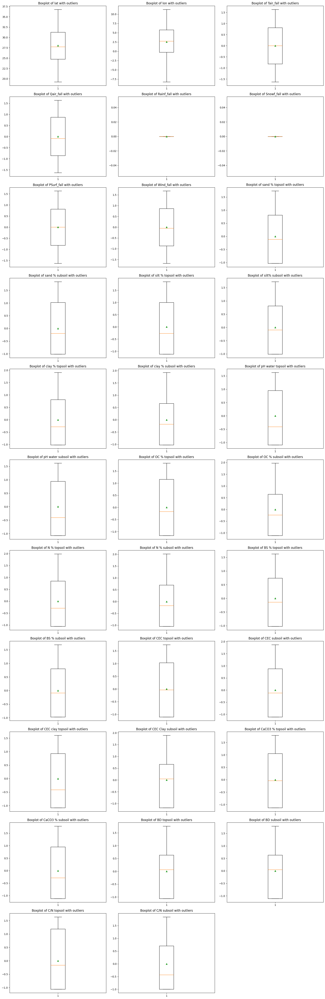

In [78]:
draw_boxplots(final_cleaned_data_2)

- v. Construct histograms and visualizethe data distribution

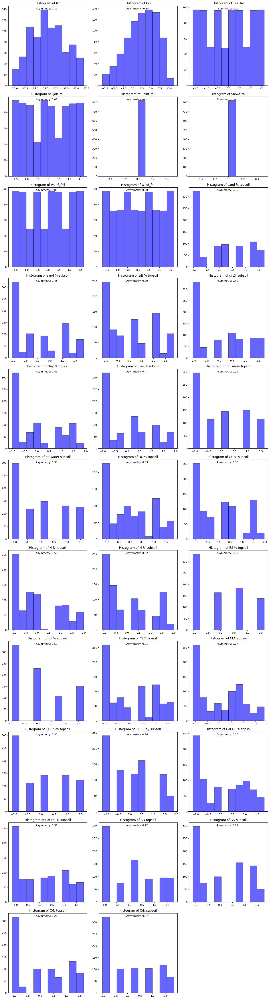

In [79]:
draw_histograms(final_cleaned_data_2)

##### b. Construct and display scatter plots of the data and deduce correlations

In [80]:
def is_better_pair(dataset, attribut1, attribut2):
    variance1 = dataset[attribut1].var()
    variance2 = dataset[attribut2].var()
    return variance2 > variance1  # On retourne True si la variance de attribut2 est plus grande

def draw_scatter_plot_pair(dataset, attribut1, attribut2):

    filtred_data = dataset[[attribut1,attribut2]].dropna() # supprimer les valeurs nulles sémultanement avoir garder la meme taille des 2 attributs
    liste1 = filtred_data[attribut1]
    liste2 = filtred_data[attribut2]

    if is_better_pair(dataset, attribut1, attribut2): 
        plt.scatter(liste1,liste2)
        slope, intercept, rvalue, pvalue, stderr = stats.linregress(liste1,liste2)
        # Tracer la droite de régression
        plt.plot(liste1, [slope * x + intercept for x in liste1], color='red')
        # Annoter l'équation de la droite de régression
        plt.annotate(f'y = {slope:.2f}x + {intercept:.2f}', 
                        xy=(0.8, 0.95), xycoords='axes fraction', 
                        fontsize=10, color='red', 
                        horizontalalignment='right', verticalalignment='top')
        plt.xlabel(attribut1)
        plt.ylabel(attribut2)
            
    else:
        plt.scatter(liste2,liste1)
        slope, intercept, rvalue, pvalue, stderr = stats.linregress(liste2,liste1)
        # Tracer la droite de régression
        plt.plot(liste2, [slope * x + intercept for x in liste2], color='red')
        # Annoter l'équation de la droite de régression
        plt.annotate(f'y = {slope:.2f}x + {intercept:.2f}', 
                        xy=(0.8, 0.95), xycoords='axes fraction', 
                        fontsize=10, color='red', 
                        horizontalalignment='right', verticalalignment='top')
        plt.xlabel(attribut2)
        plt.ylabel(attribut1)
    

    plt.title(f'Scatter plot between {attribut1} and {attribut2}')
    plt.show()

In [81]:
final_cleaned_data_2.columns

Index(['lat', 'lon', 'Tair_fall', 'Qair_fall', 'Rainf_fall', 'Snowf_fall',
       'PSurf_fall', 'Wind_fall', 'geometry', 'sand % topsoil',
       'sand % subsoil', 'silt % topsoil', 'silt% subsoil', 'clay % topsoil',
       'clay % subsoil', 'pH water topsoil', 'pH water subsoil',
       'OC % topsoil', 'OC % subsoil', 'N % topsoil', 'N % subsoil',
       'BS % topsoil', 'BS % subsoil', 'CEC topsoil', 'CEC subsoil',
       'CEC clay topsoil', 'CEC Clay subsoil', 'CaCO3 % topsoil',
       'CaCO3 % subsoil', 'BD topsoil', 'BD subsoil', 'C/N topsoil',
       'C/N subsoil'],
      dtype='object')

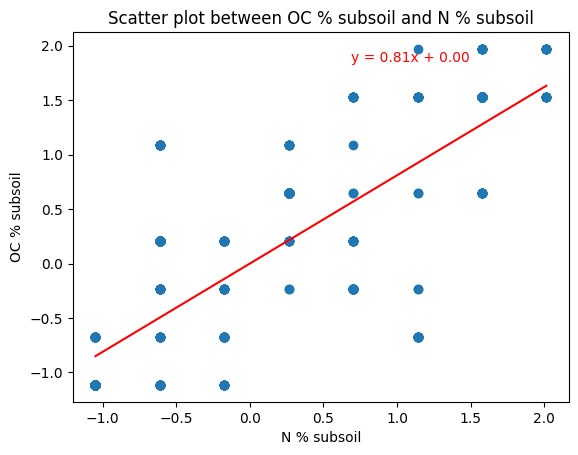

In [82]:
draw_scatter_plot_pair (final_cleaned_data_2, "OC % subsoil", "N % subsoil")